In [2]:
import sys
# sys.path.insert(0, '/home/xu.chao/cantera/build')
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import os
%matplotlib inline
import cantera as ct
import warnings
warnings.filterwarnings('ignore')
plt.rcParams.update({'font.size': 32})

In [2]:
heat_map_gen(32, 0.6, 20, plot=False, title_name=True)

NameError: name 'heat_map_gen' is not defined

In [41]:
def heat_map_gen(rxn, ratio, threshold, plot=False, title_name=False):
    """
    This plots 6 figures all at once
    rxn: index of reations
    ratio: the C/O input ratio
    threshold: threshold to rule out the outliers
    """
    # index of ch4 conversion, syngas yield, and full oxidation
    properties_plot = [8, 3, 10]
    original_dfs = []
    bm_dfs = []
    extremes = []
    for property_ in properties_plot:
        benergy_c = np.arange(-7.5, -5.25, 0.25)
        benergy_o = np.arange(-3.25, -5.5, -0.25)
        # parent_dir = os.path.dirname(os.getcwd())
        parent_dir = '/work/westgroup/chao/sketches/cpox_sim/bm_models_final'
        # read the first file to extract the species and properties list
        f = f'{parent_dir}/base_original/binding_energies/1.0_c-5.50o-3.25/kinetic_sensitivity_data/0.6_sens_data.csv'
        df = pd.read_csv(f)
    #     species = df.loc[:, 'Species'].to_list()
        properties = df.columns.to_list()
        data_original = np.zeros((len(benergy_c), len(benergy_o)))
        data_bm = np.zeros((len(benergy_c), len(benergy_o)))
        total = 81
        i = -1
        paths = []
        for c_binding_energy in benergy_c:
            i += 1
            j = -1
            index = total - ((7.5 - abs(c_binding_energy)) / 0.25 + 1) * 9
            for o_binding_energy in benergy_o:
                j += 1
                index += 1


                # read the simulation files
                original_path_sens = '{}/base_original/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
                if os.path.exists(original_path_sens):
                    df_original = pd.read_csv(original_path_sens)
                    charac_sens_original = df_original.loc[df_original['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                    if abs(charac_sens_original) >= threshold:
                        data_original[j][i] = 0
                    else:
                        data_original[j][i] = charac_sens_original

                bm_path_sens = '{}/base_bm/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
                if os.path.exists(bm_path_sens):
                    df_bm = pd.read_csv(bm_path_sens)
                    charac_sens_bm = df_bm.loc[df_bm['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                    if abs(charac_sens_bm) >= threshold:
                        data_bm[j][i] = 0
                    else:
                        data_bm[j][i] = charac_sens_bm

        original_df = pd.DataFrame(data_original, columns=benergy_c, index=benergy_o)
        bm_df = pd.DataFrame(data_bm, columns=benergy_c, index=benergy_o)
        minimum = min(original_df.min().min(), bm_df.min().min())
        maximum = max(original_df.max().max(), bm_df.max().max())
        original_dfs.append(original_df)
        bm_dfs.append(bm_df)
        extremes.append([minimum, maximum])
    data_sets = np.array([np.array(original_dfs), np.array(bm_dfs)])
    sns.set_style("darkgrid")
    plt.rcParams.update({'font.size': 36})
    fig, axs = plt.subplots(2, 3, figsize=(50, 30))  # Adjust figsize as needed

    # Create a common colorbar axis at the bottom
    cbar_ax1 = fig.add_axes([0.03, 0, 0.3, 0.02])  # Adjust position and size as needed
    cbar_ax2 = fig.add_axes([0.36, 0, 0.3, 0.02])
    cbar_ax3 = fig.add_axes([0.69, 0, 0.3, 0.02])
    cbars = [cbar_ax1, cbar_ax2, cbar_ax3]
    cmap = sns.color_palette("Spectral", as_cmap=True)

    for a in range(len(axs)):
        for b in range(len(axs[a])):
            row = a  # Determine the row (0 or 1)
            col = b   # Determine the column (0, 1, or 2)
            sns.heatmap(data_sets[row, col], xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=axs[row, col], vmin=extremes[b][0], vmax=extremes[b][1], cbar=False)
            if a == 1:
            # Add the heatmap to the current subplot
                sns.heatmap(data_sets[row, col], xticklabels=benergy_c, yticklabels=benergy_o, cmap=cmap, ax=axs[row, col], annot=False, vmin=extremes[b][0], vmax=extremes[b][1], cbar_ax=cbars[b], cbar_kws={"orientation": "horizontal"})
    
            if a == 0:
                if title_name:
                    axs[row, col].set(title="Original models {} sensitivity of \n {} \n at C/O={}".format(properties[properties_plot[b]], rxns[rxn].equation, ratio),
                                      xlabel="$\\Delta E^C(ev)$",
                                      ylabel="$\\Delta E^O(ev)$",)
                    # axs[row, col].title.set_size(18)
        # print("Original models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio), rxn)
                else:
                    axs[row, col].set(title=None,
                                      xlabel="$\\Delta E^C(ev)$",
                                      ylabel="$\\Delta E^O(ev)$",)
            else:
                if title_name:
                    axs[row, col].set(title="BMA models {} sensitivity of \n {} \n at C/O={}".format(properties[properties_plot[b]], rxns[rxn].equation, ratio),
                            xlabel="$\\Delta E^C(ev)$",
                            ylabel="$\\Delta E^O(ev)$",)
                else:
                    axs[row, col].set(title=None,
                                      xlabel="$\\Delta E^C(ev)$",
                                      ylabel="$\\Delta E^O(ev)$",)

            axs[row, col].scatter(metal_x, metal_y, marker='*', color='black')
            for i, txt in enumerate(metal_names):
                axs[row, col].annotate(txt,(metal_x[i], metal_y[i]))
    # ax1.xaxis.label.set_size(20)
    # ax1.yaxis.label.set_size(20)
            xticks = axs[row, col].xaxis.get_major_ticks()
            yticks = axs[row, col].yaxis.get_major_ticks()

            for i in range(len(xticks)-1):
                if i % 2 != 0:
                    xticks[i].label1.set_visible(False)
            for i in range(len(yticks)-1):
                if i % 2 != 0:
                    yticks[i].label1.set_visible(False)
    plt.tight_layout()
    plt.plot()
    if plot == True:
        plt.savefig(f'kinetic_sens_plots/{ratio}_{rxns[rxn].equation}_{properties[property_]}.pdf', bbox_inches='tight')

In [3]:
# read the surface species names for plotting
yaml_file = '../base_original/base_modified_pt.yaml'
gas = ct.Solution(yaml_file, 'gas')
surf = ct.Interface(yaml_file, 'surface1', [gas])
rxns = surf.reactions()

In [4]:
metals = {'Pt': {'C':-7.02516, 'O':-3.81153}, 'Pd':{'C':-7.16786, 'O':-4.13577}, 'Rh':{'C':(-6.65 - 7.11) / 2, 'O':(-4.31 - 4.88) / 2}, 'Ni': {'C':-6.79794, 'O':-4.98902}}
metal_x = []
metal_y = []
metal_names = []
for i, v in metals.items():
    metal_x.append(abs(v['C'] + 7.5) / 2.25 * 9)
    metal_y.append(abs(v['O'] + 3.125) / 2.25 * 9)
    metal_names.append(i)

In [47]:
def heat_map_gen(rxn, property_, ratio, threshold, plot=False, title_name=False):
    """
    This only plot for one property at a time
    rxn: index of reations
    property_: index of the property to plot
    ratio: the C/O input ratio
    threshold: threshold to rule out the outliers
    """
    benergy_c = np.arange(-7.5, -5.25, 0.25)
    benergy_o = np.arange(-3.25, -5.5, -0.25)
    data_original = np.zeros((len(benergy_c), len(benergy_o)))
    data_bm = np.zeros((len(benergy_c), len(benergy_o)))
    # parent_dir = os.path.dirname(os.getcwd())
    parent_dir = '/work/westgroup/chao/sketches/cpox_sim/bm_models_final'
    # read the first file to extract the species and properties list
    f = f'{parent_dir}/base_original/binding_energies/1.0_c-5.50o-3.25/kinetic_sensitivity_data/0.6_sens_data.csv'
    df = pd.read_csv(f)
#     species = df.loc[:, 'Species'].to_list()
    properties = df.columns.to_list()
    
    total = 81
    i = -1
    paths = []
    for c_binding_energy in benergy_c:
        i += 1
        j = -1
        index = total - ((7.5 - abs(c_binding_energy)) / 0.25 + 1) * 9
        for o_binding_energy in benergy_o:
            j += 1
            index += 1

     
            # read the simulation files
            original_path_sens = '{}/base_original/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
            if os.path.exists(original_path_sens):
                df_original = pd.read_csv(original_path_sens)
                charac_sens_original = df_original.loc[df_original['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                if abs(charac_sens_original) >= threshold:
                    data_original[j][i] = 0
                else:
                    data_original[j][i] = charac_sens_original

            bm_path_sens = '{}/base_bm/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
            if os.path.exists(bm_path_sens):
                df_bm = pd.read_csv(bm_path_sens)
                charac_sens_bm = df_bm.loc[df_bm['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                if abs(charac_sens_bm) >= threshold:
                    data_bm[j][i] = 0
                else:
                    data_bm[j][i] = charac_sens_bm
                    
    original_df = pd.DataFrame(data_original, columns=benergy_c, index=benergy_o)
    bm_df = pd.DataFrame(data_bm, columns=benergy_c, index=benergy_o)
    minimum = min(original_df.min().min(), bm_df.min().min())
    maximum = max(original_df.max().max(), bm_df.max().max())
    sns.set_style("darkgrid")
    plt.rcParams.update({'font.size': 36})
    fig = plt.figure(figsize=(18,9))
    ax1 = fig.add_subplot(121, aspect='equal')
    ax2 = fig.add_subplot(122, aspect='equal')
    # ax1 = fig.add_subplot(121, aspect='equal')
    # ax2 = fig.add_subplot(122, aspect='equal')
    # cmap = sns.color_palette("viridis", as_cmap=True)
    cmap = sns.color_palette("Spectral", as_cmap=True)
    # ax1 = sns.heatmap(original_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax1, cbar=False)
    ax1 = sns.heatmap(original_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax1, vmin=minimum, vmax=maximum, cbar=False)
    if title_name:
        ax1.set(title="Original models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio),
              xlabel="$\\Delta E^C(ev)$",
              ylabel="$\\Delta E^O(ev)$",)
    # print("Original models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio), rxn)
    else:
        ax1.set(title=None,
              xlabel="$\\Delta E^C(ev)$",
              ylabel="$\\Delta E^O(ev)$",)
    ax1.scatter(metal_x, metal_y, marker='*', color='black')
    for i, txt in enumerate(metal_names):
        ax1.annotate(txt,(metal_x[i], metal_y[i]))
    # ax1.xaxis.label.set_size(20)
    # ax1.yaxis.label.set_size(20)
    ax1.title.set_size(18)
    cbar_ax = fig.add_axes([1, 0, .03, 1])
    ax2 = sns.heatmap(bm_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax2, vmin=minimum, vmax=maximum, cbar_ax=cbar_ax)
    if title_name:
        ax2.set(title="BMA models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio),
              xlabel="$\\Delta E^C(ev)$",
              ylabel="$\\Delta E^O(ev)$",)
    # print("BMA models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio))
    else:
        ax2.set(title=None,
          xlabel="$\\Delta E^C(ev)$",
          ylabel="$\\Delta E^O(ev)$",)
    ax2.scatter(metal_x, metal_y, marker='*', color='black')
    for i, txt in enumerate(metal_names):
        ax2.annotate(txt,(metal_x[i], metal_y[i]))
    # ax2.xaxis.label.set_size(20)
    # ax2.yaxis.label.set_size(20)
    ax2.title.set_size(18)
    xticks1 = ax1.xaxis.get_major_ticks()
    yticks1 = ax1.yaxis.get_major_ticks()
    xticks2 = ax2.xaxis.get_major_ticks()
    yticks2 = ax2.yaxis.get_major_ticks()
    for i in range(len(xticks1)-1):
        if i % 2 != 0:
            xticks1[i].label1.set_visible(False)
            xticks2[i].label1.set_visible(False)
    for i in range(len(yticks1)-1):
        if i % 2 != 0:
            yticks1[i].label1.set_visible(False)
            yticks2[i].label1.set_visible(False)
    plt.tight_layout()
    plt.plot()
    if plot == True:
        plt.savefig(f'kinetic_sens_plots/{ratio}_{rxns[rxn].equation}_{properties[property_]}.pdf', bbox_inches='tight')

In [5]:
def heat_map_gen(rxn, property_, ratio, threshold, plot=False, title_name=False, minimum=1e9, maximum=1e-9, print_data=False):
    """
    This only plot for one property at a time vertically
    rxn: index of reations
    property_: index of the property to plot
    ratio: the C/O input ratio
    threshold: threshold to rule out the outliers
    """
    benergy_c = np.arange(-7.5, -5.25, 0.25)
    benergy_o = np.arange(-3.25, -5.5, -0.25)
    data_original = np.zeros((len(benergy_c), len(benergy_o)))
    data_bm = np.zeros((len(benergy_c), len(benergy_o)))
    # parent_dir = os.path.dirname(os.getcwd())
    parent_dir = '/work/westgroup/chao/sketches/cpox_sim/bm_models_final'
    # read the first file to extract the species and properties list
    f = f'{parent_dir}/base_original/binding_energies/1.0_c-5.50o-3.25/kinetic_sensitivity_data/0.6_sens_data.csv'
    df = pd.read_csv(f)
#     species = df.loc[:, 'Species'].to_list()
    properties = df.columns.to_list()
    
    total = 81
    i = -1
    paths = []
    for c_binding_energy in benergy_c:
        i += 1
        j = -1
        index = total - ((7.5 - abs(c_binding_energy)) / 0.25 + 1) * 9
        for o_binding_energy in benergy_o:
            j += 1
            index += 1

     
            # read the simulation files
            original_path_sens = '{}/base_original/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
            if os.path.exists(original_path_sens):
                df_original = pd.read_csv(original_path_sens)
                charac_sens_original = df_original.loc[df_original['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                if abs(charac_sens_original) >= threshold:
                    data_original[j][i] = charac_sens_original / abs(charac_sens_original) * threshold
                else:
                    data_original[j][i] = charac_sens_original

            bm_path_sens = '{}/base_bm/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
            if os.path.exists(bm_path_sens):
                df_bm = pd.read_csv(bm_path_sens)
                charac_sens_bm = df_bm.loc[df_bm['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                if abs(charac_sens_bm) >= threshold:
                    data_bm[j][i] = charac_sens_bm / abs(charac_sens_bm) * threshold
                else:
                    data_bm[j][i] = charac_sens_bm               
    # original_df = pd.DataFrame(data_original/abs(data_original.max()-data_original.min()), columns=benergy_c, index=benergy_o)
    # bm_df = pd.DataFrame(data_bm/abs(data_bm.max()-data_bm.min()), columns=benergy_c, index=benergy_o)
    original_df = pd.DataFrame(data_original, columns=benergy_c, index=benergy_o)
    bm_df = pd.DataFrame(data_bm, columns=benergy_c, index=benergy_o)
    if print_data:
        print(original_df)
        print(bm_df)
    if minimum == 1e9:
        minimum = min(original_df.min().min(), bm_df.min().min())
    if maximum == 1e-9:
        maximum = max(original_df.max().max(), bm_df.max().max())
    sns.set_style("darkgrid")
    plt.rcParams.update({'font.size': 36})
    fig, axs = plt.subplots(2, 1, figsize=(9, 18))
    ax1 = axs[0]
    ax2 = axs[1]
    # ax1 = fig.add_subplot(121, aspect='equal')
    # ax2 = fig.add_subplot(122, aspect='equal')
    # cmap = sns.color_palette("viridis", as_cmap=True)
    # cmap = sns.color_palette("Spectral", as_cmap=True)
    cmap = sns.diverging_palette(250, 10,center='light', as_cmap=True)
    # cmap = sns.dark_palette("#69d", reverse=True, as_cmap=True)
    # cmap = sns.diverging_palette(250, 30, l=65, center="light", as_cmap=True)
    # cmap = sns.color_palette("coolwarm", as_cmap=True)
    # ax1 = sns.heatmap(original_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax1, cbar=False)
    ax1 = sns.heatmap(original_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax1, vmin=minimum, vmax=maximum, cbar=False)
    if title_name:
        ax1.set(title="Original models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio),
              xlabel="$\\Delta E^C(ev)$",
              ylabel="$\\Delta E^O(ev)$",)
    # print("Original models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio), rxn)
    else:
        ax1.set(title=None,
              xlabel="$\\Delta E^C(ev)$",
              ylabel="$\\Delta E^O(ev)$",)
    ax1.scatter(metal_x, metal_y, marker='*', color='black')
    for i, txt in enumerate(metal_names):
        ax1.annotate(txt,(metal_x[i], metal_y[i]))
    # ax1.xaxis.label.set_size(20)
    # ax1.yaxis.label.set_size(20)
    ax1.title.set_size(18)
    cbar_ax = fig.add_axes([0.2, 0, 0.8, 0.02])
    ax2 = sns.heatmap(bm_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax2, vmin=minimum, vmax=maximum, cbar_ax=cbar_ax, cbar_kws={"orientation": "horizontal"})
    if title_name:
        ax2.set(title="BMA models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio),
              xlabel="$\\Delta E^C(ev)$",
              ylabel="$\\Delta E^O(ev)$",)
    # print("BMA models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio))
    else:
        ax2.set(title=None,
          xlabel="$\\Delta E^C(ev)$",
          ylabel="$\\Delta E^O(ev)$",)
    ax2.scatter(metal_x, metal_y, marker='*', color='black')
    for i, txt in enumerate(metal_names):
        ax2.annotate(txt,(metal_x[i], metal_y[i]))
    # ax2.xaxis.label.set_size(20)
    # ax2.yaxis.label.set_size(20)
    ax2.title.set_size(18)
    xticks1 = ax1.xaxis.get_major_ticks()
    yticks1 = ax1.yaxis.get_major_ticks()
    xticks2 = ax2.xaxis.get_major_ticks()
    yticks2 = ax2.yaxis.get_major_ticks()
    for i in range(len(xticks1)-1):
        if i % 2 != 0:
            xticks1[i].label1.set_visible(False)
            xticks2[i].label1.set_visible(False)
    for i in range(len(yticks1)-1):
        if i % 2 != 0:
            yticks1[i].label1.set_visible(False)
            yticks2[i].label1.set_visible(False)
    plt.tight_layout()
    plt.plot()
    if plot == True:
        plt.savefig(f'kinetic_sens_plots/{ratio}_{rxns[rxn].equation}_{properties[property_]}.pdf', bbox_inches='tight')

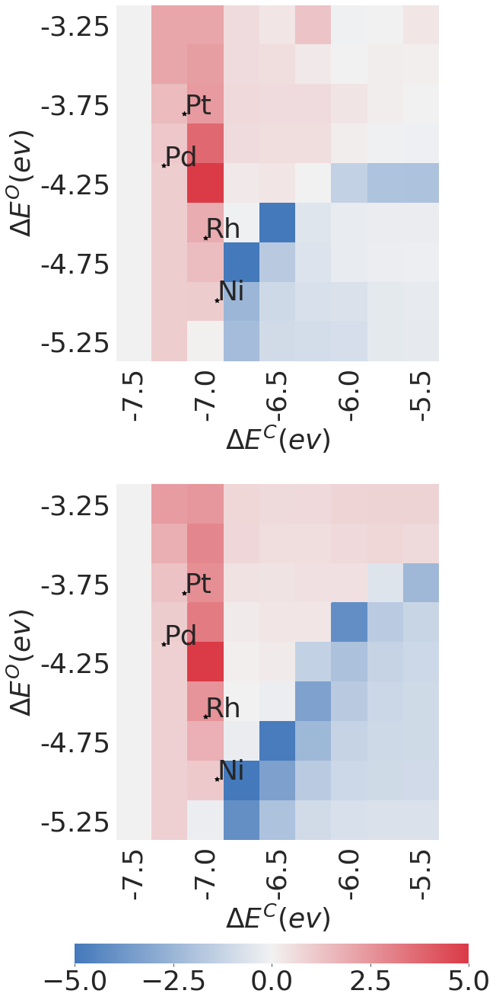

In [20]:
heat_map_gen(4, 8, 1.0, 10, plot=True, minimum=-5, maximum=5)

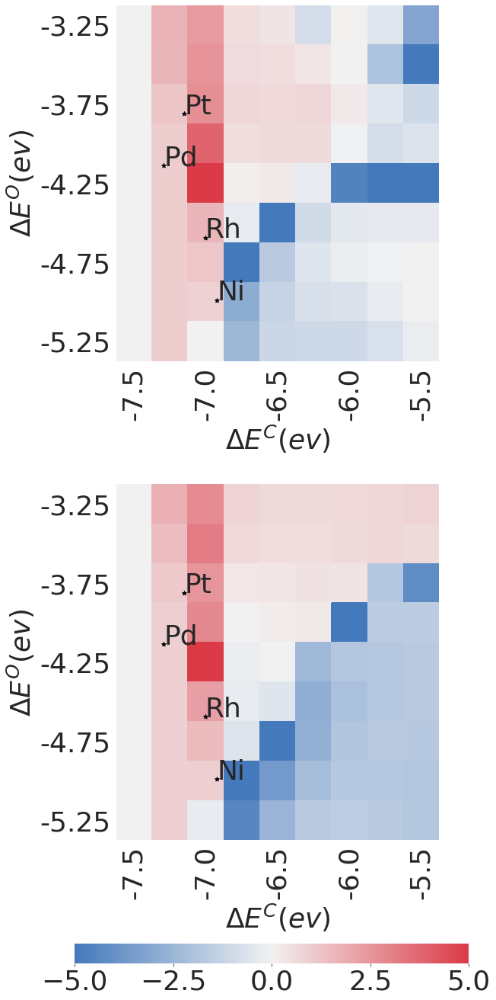

In [21]:
heat_map_gen(4, 3, 1.0, 5, plot=True, minimum=-5, maximum=5)

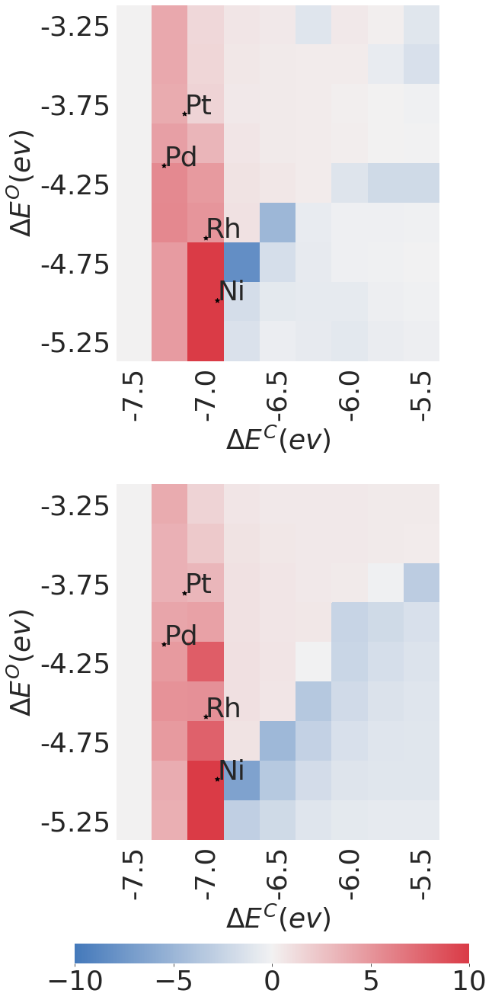

In [16]:
heat_map_gen(4, 10, 1.0, 10, plot=True, minimum=-10, maximum=10)

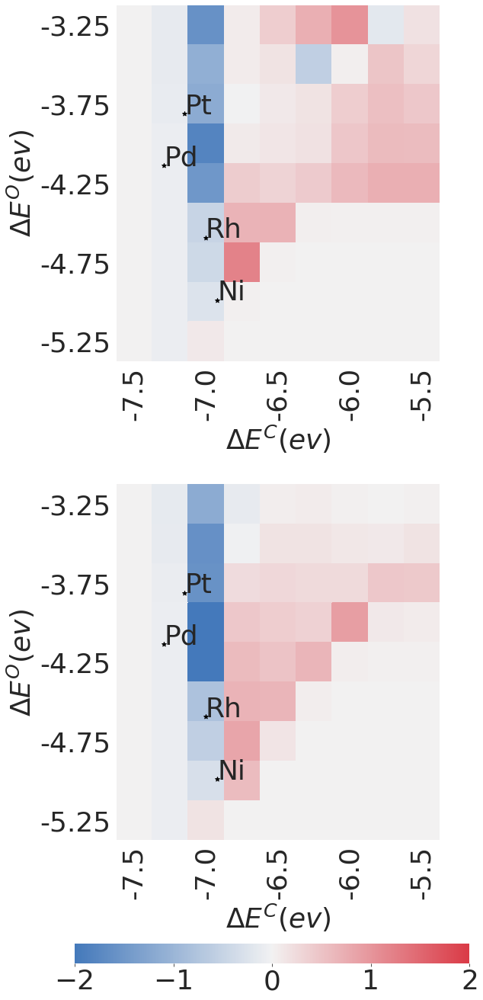

In [22]:
heat_map_gen(32, 8, 1.0, 2, minimum=-2, maximum=2, plot=True, title_name=False)

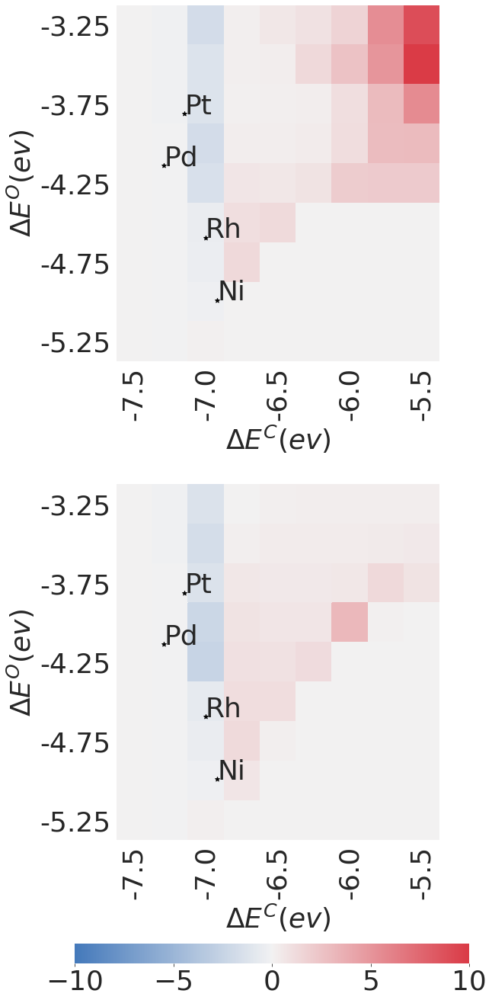

In [14]:
heat_map_gen(32, 3, 1.0, 10,  minimum=-10, maximum=10, plot=True, title_name=False)

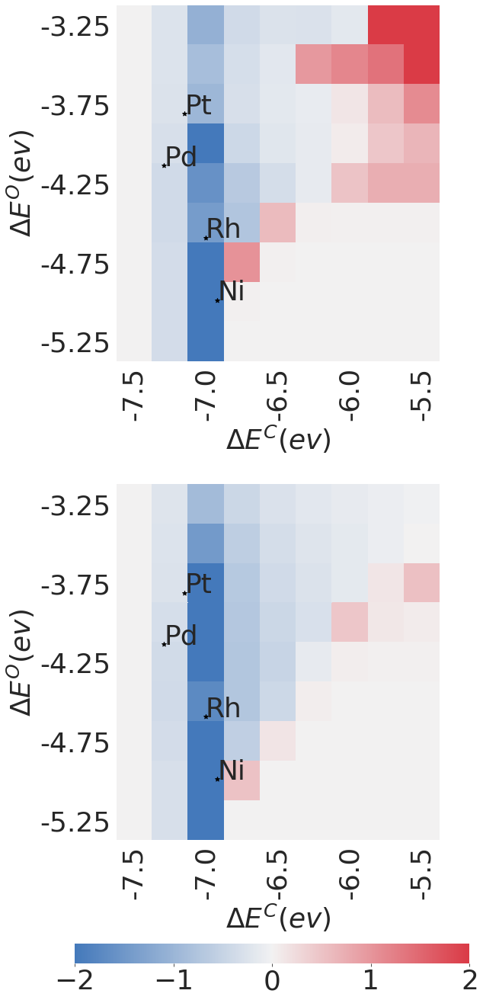

In [15]:
heat_map_gen(32, 10, 1.0, 2,  minimum=-2, maximum=2, plot=True, title_name=False)

In [5]:
sens_rxns_1 = [0,1,2,6,32,4,17,56,40,104,64,55,2,3,61]
sens_rxns_26 = [ 29,4,47,104,7,103,56,36,34,17]

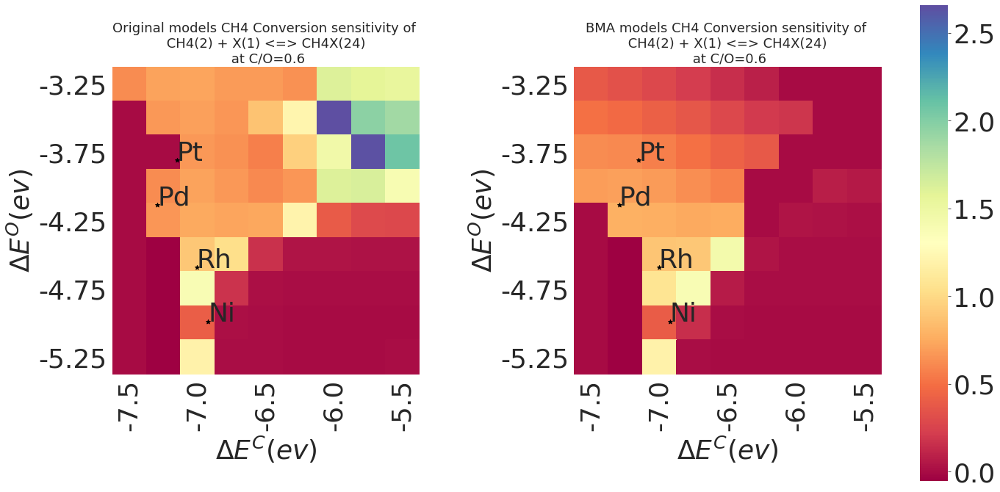

In [48]:
heat_map_gen(32, 8, 0.6, 20, plot=False, title_name=True)

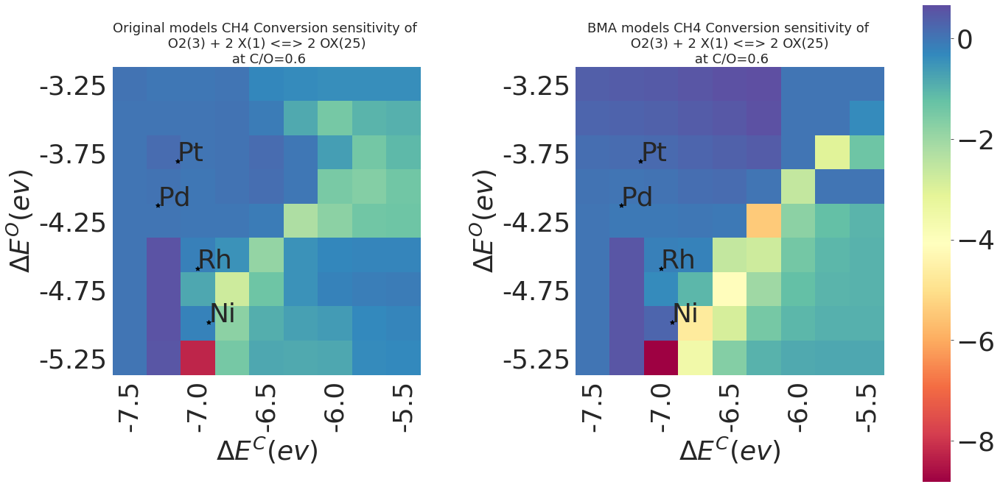

In [49]:
heat_map_gen(4, 8, 0.6, 20, plot=False, title_name=True)

          -7.50     -7.25     -7.00     -6.75     -6.50     -6.25      -6.00  \
-3.25  1.454268  1.492721  1.482595  1.431687  2.870253  6.015653  25.431625   
-3.50  0.000000  1.375074  1.392196  1.349234  1.685031  5.161038  20.141506   
-3.75  0.000000  0.000000  1.373412  1.324779  1.234971  2.658580   7.083762   
-4.00  0.000000  1.290245  1.402729  1.358579  1.297973  1.487421  10.250247   
-4.25  0.000000  1.318808  1.419597  1.406161  1.492009  3.528292   0.781938   
-4.50  0.000000 -0.047300  1.513747  1.723324  0.259879  0.036341   0.026009   
-4.75  0.000000 -0.047101  1.806610  0.206306  0.015046  0.004522   0.002556   
-5.00  0.000000 -0.047069  0.843916  0.021207  0.003722  0.000599   0.001042   
-5.25  0.000000 -0.046702  1.230506  0.005129  0.002566  0.000449   0.000163   

           -5.75      -5.50  
-3.25  16.128850  14.486010  
-3.50  11.600276  10.478061  
-3.75  32.700074  13.416034  
-4.00   8.233476   5.551780  
-4.25   0.510224   0.480769  
-4.50   0.024549   

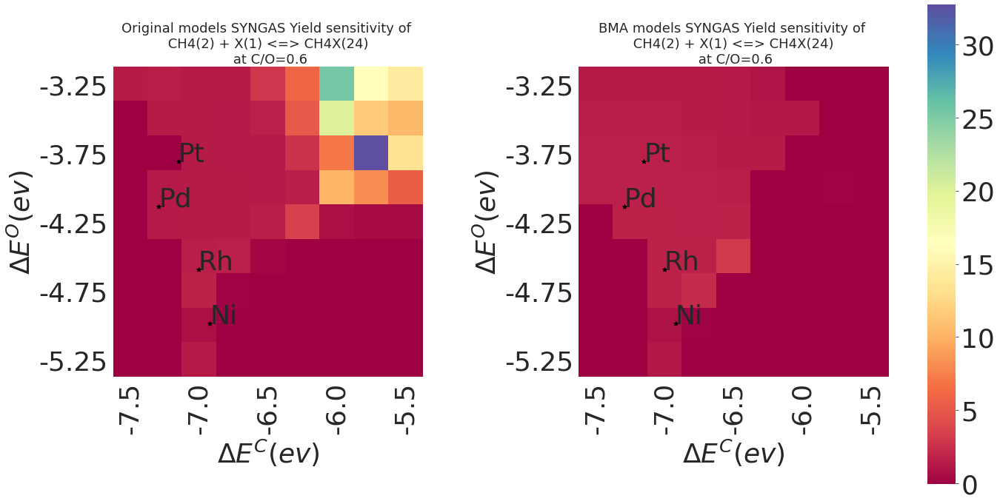

In [9]:
heat_map_gen(32, 3, 0.6, 40, plot=False, title_name=True)

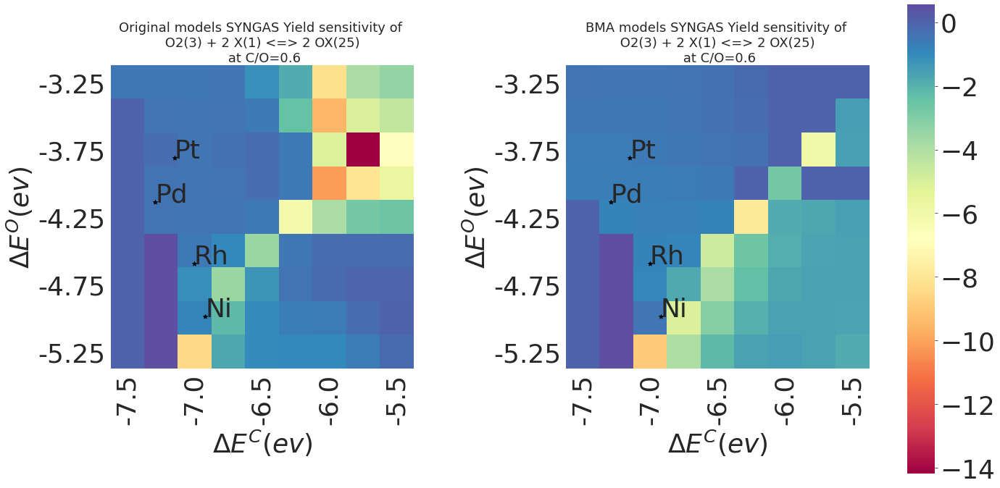

In [66]:
heat_map_gen(4, 3, 0.6, 70, plot=True, title_name=True)

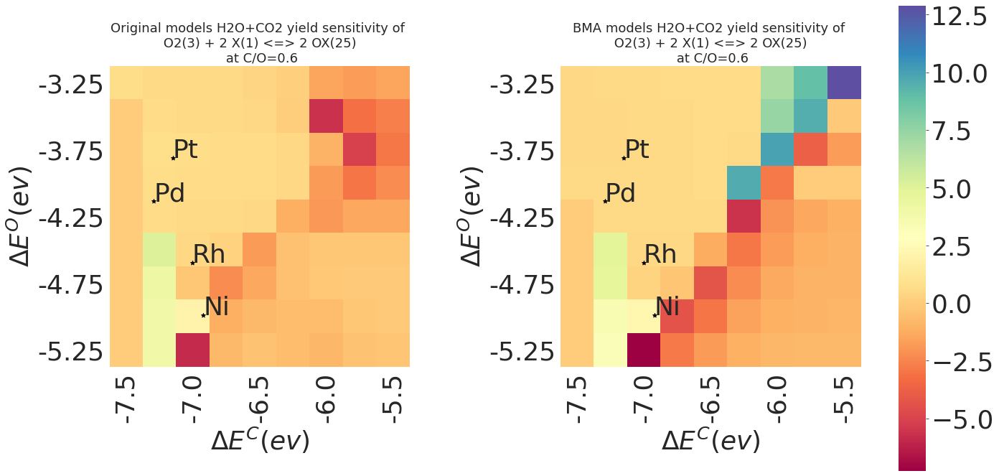

In [59]:
heat_map_gen(4, 10, 0.6, 50, plot=False, title_name=True)

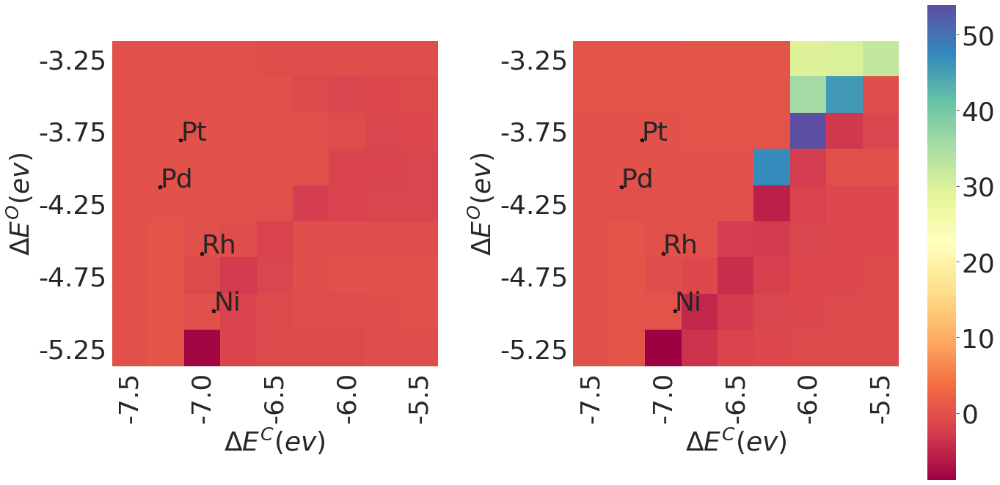

In [60]:
heat_map_gen(4, 8, 0.6, 60, plot=True, title_name=False)

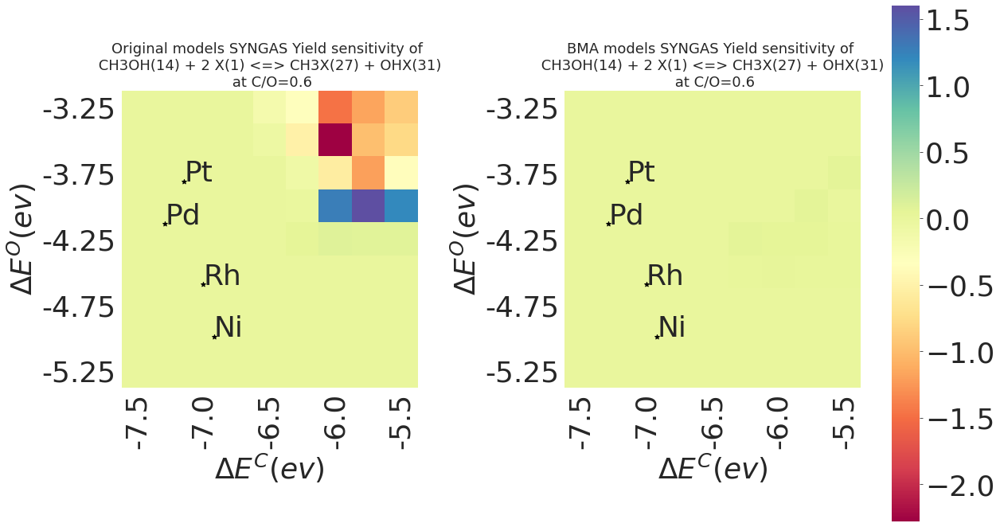

In [10]:
# for i in sens_rxns_1:
# # for i in range(107):
#     heat_map_gen(i, 3, 0.6, 20, title_name=False)
heat_map_gen(39, 3, 0.6, 20, title_name=True)

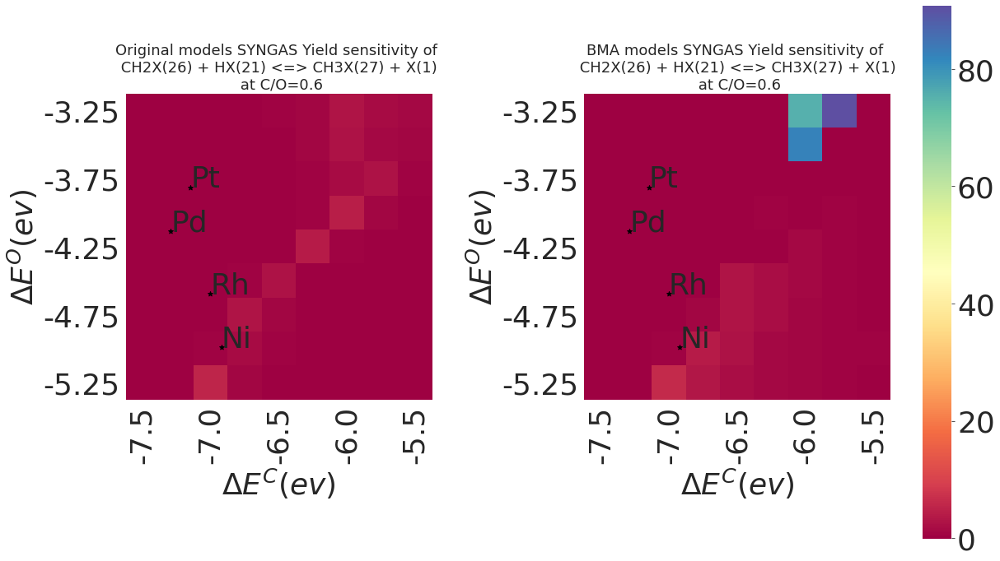

In [48]:
heat_map_gen(7, 3, 0.6, 100, title_name=True)

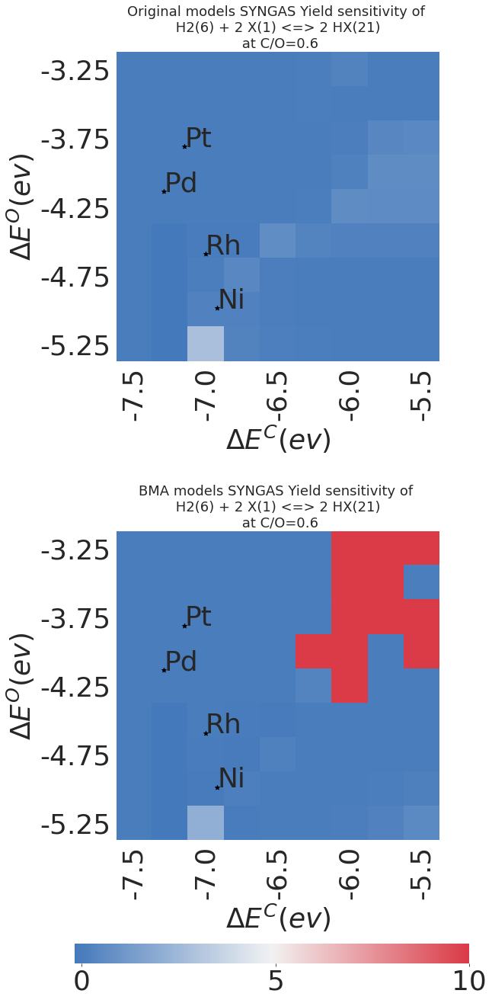

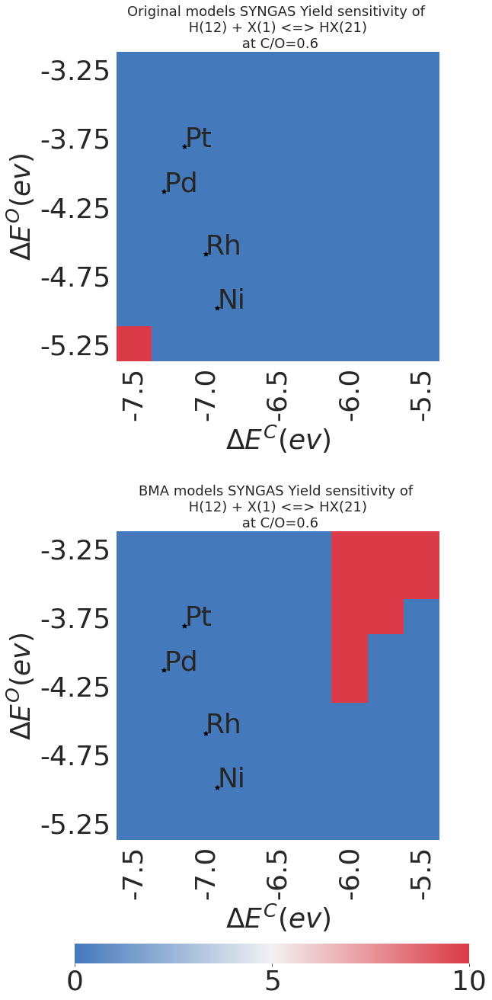

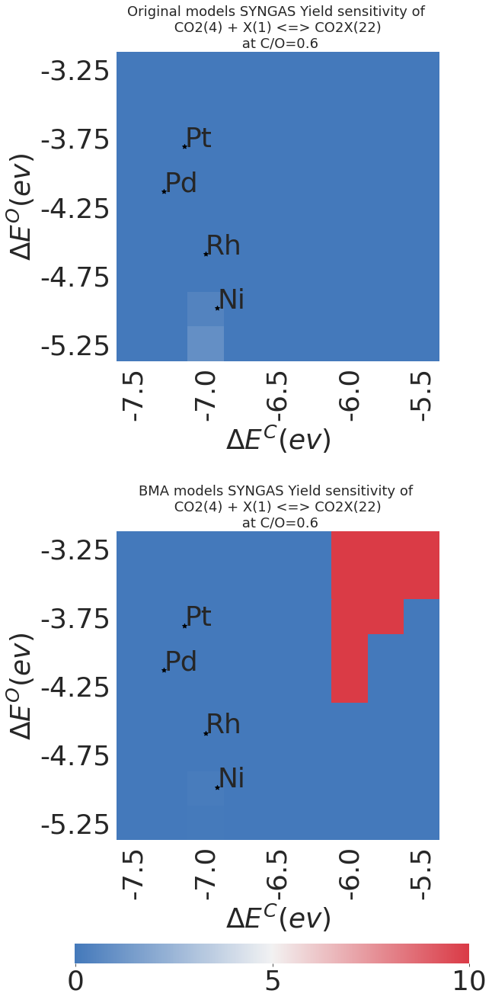

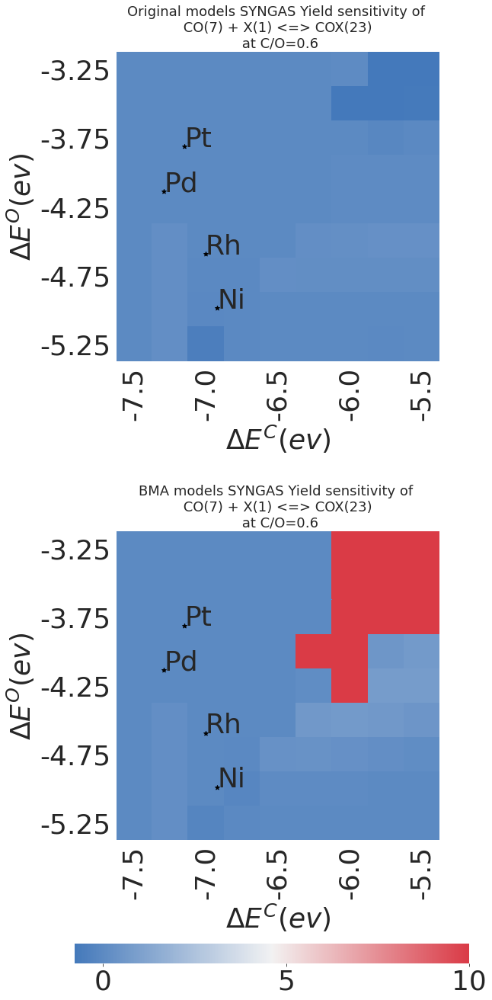

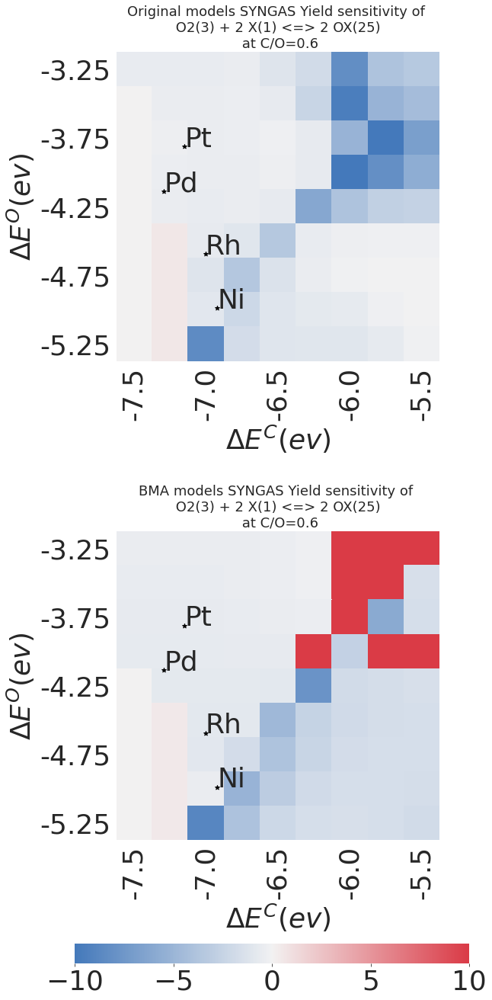

...

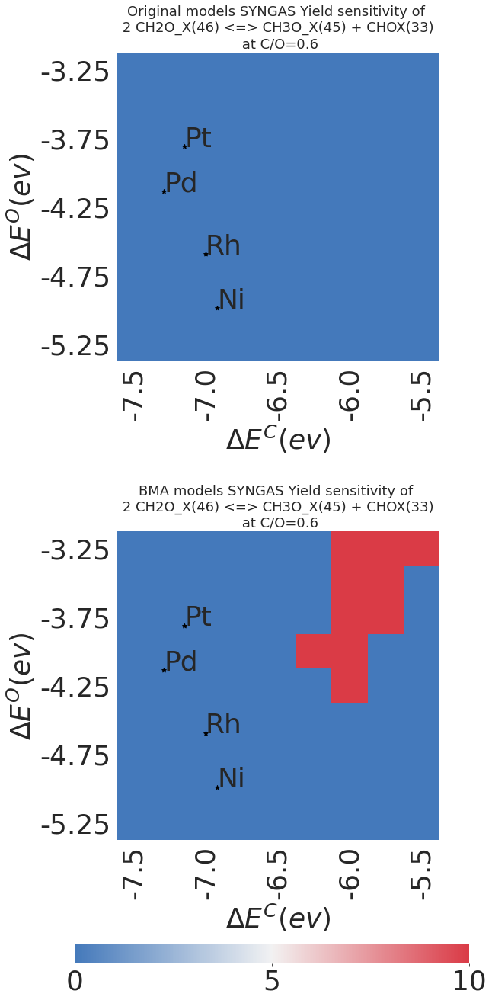

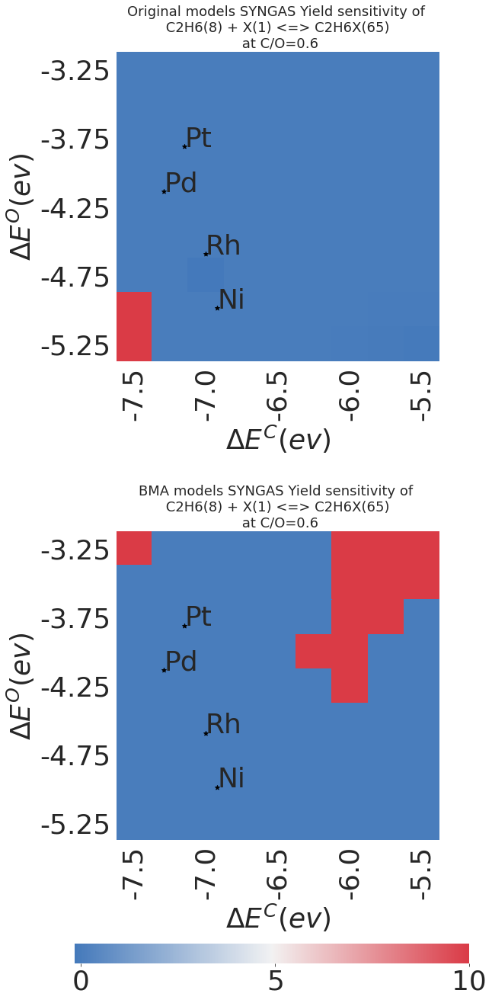

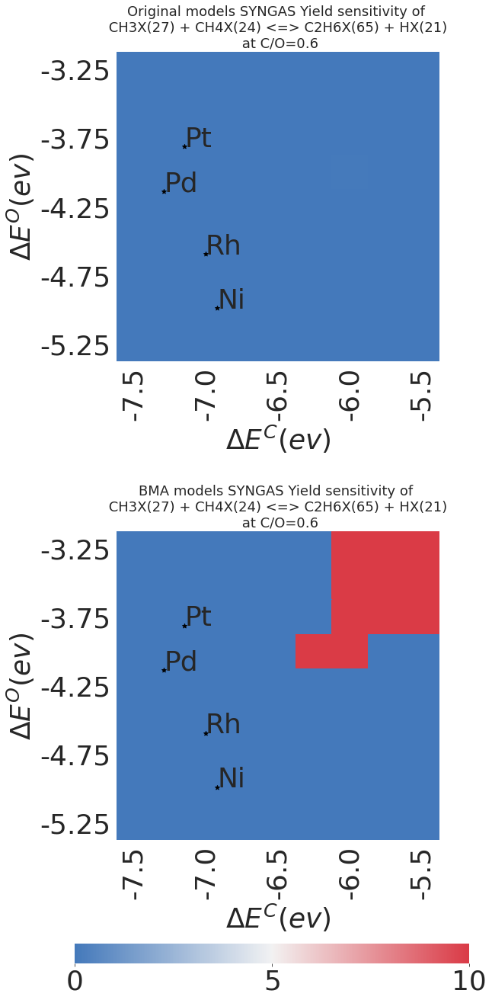

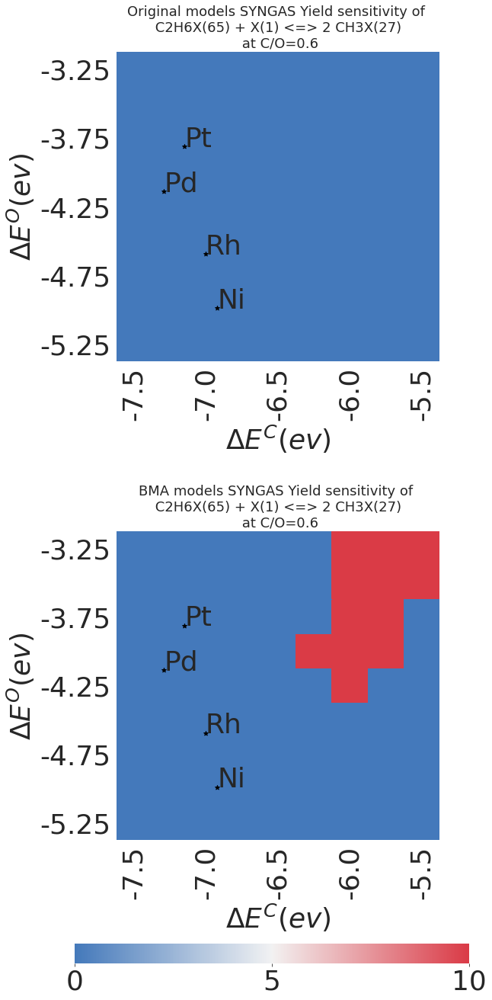

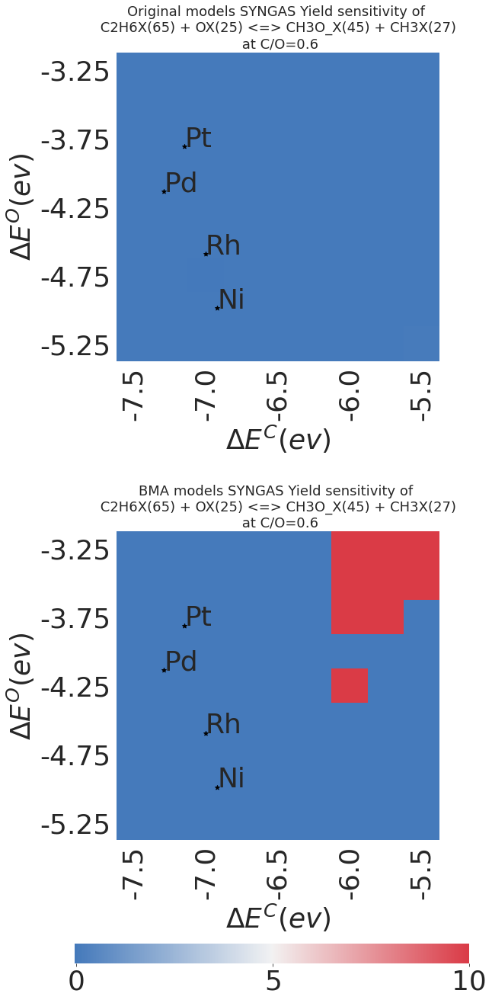

In [18]:
for i in range(107):
    heat_map_gen(i, 3, 0.6, 10, title_name=True)

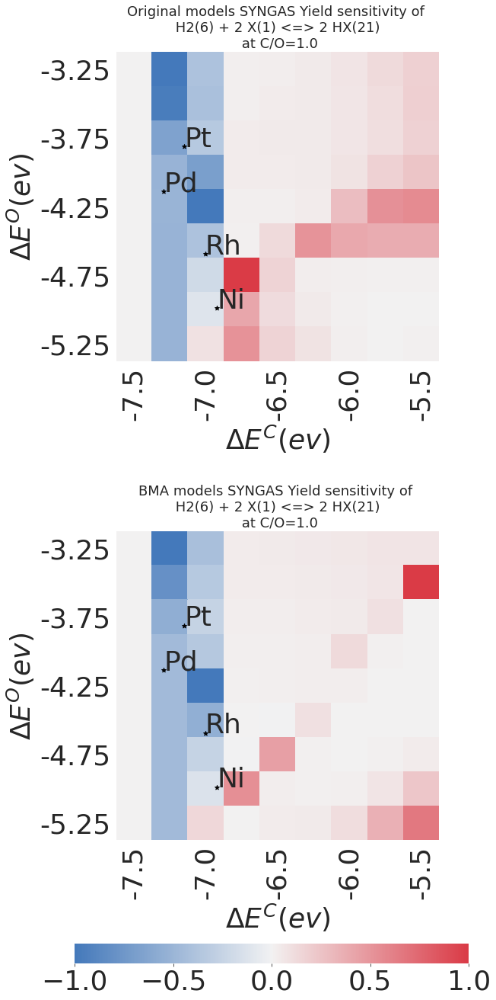

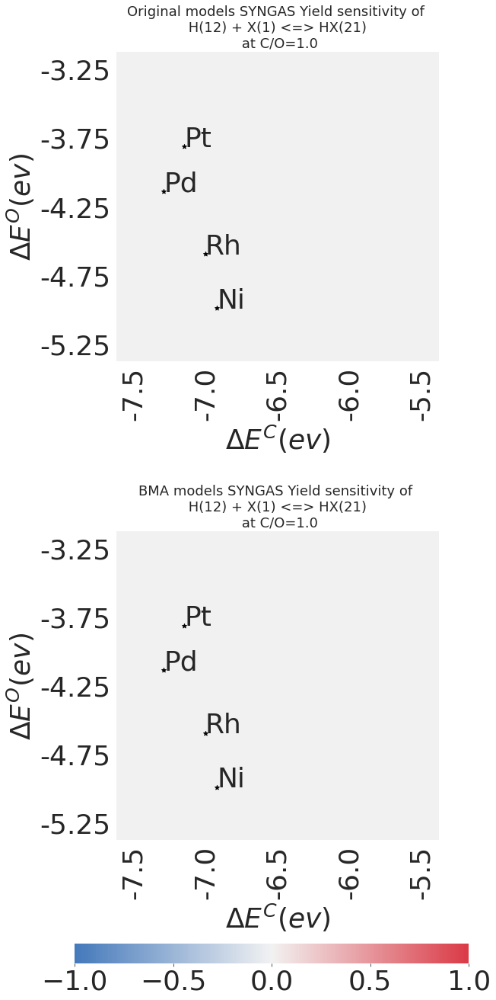

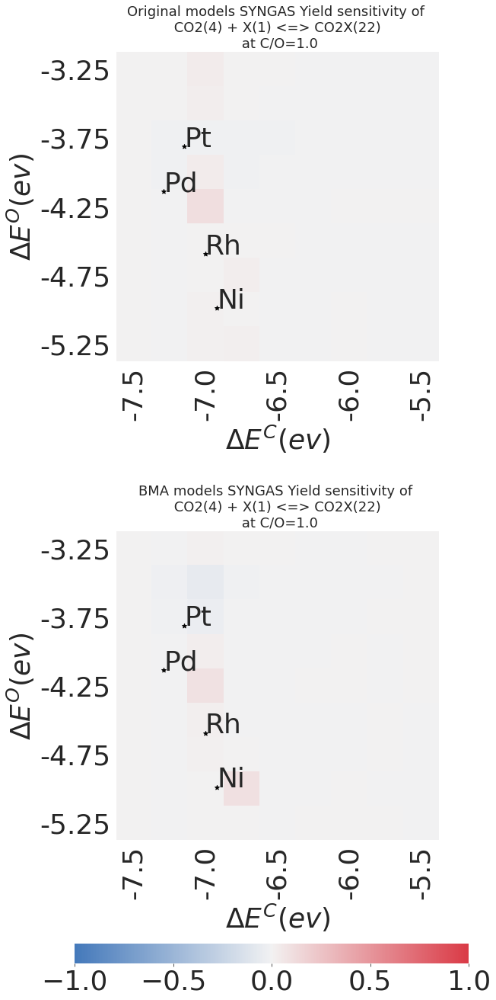

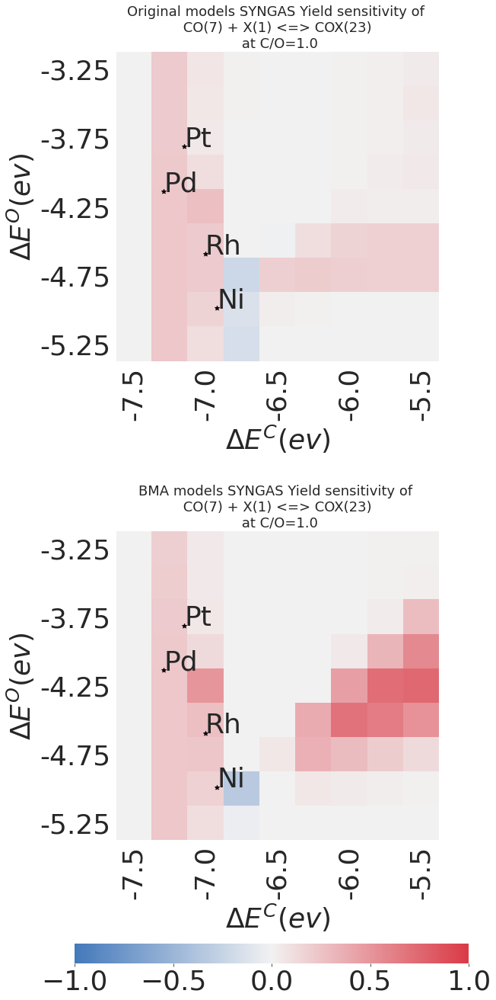

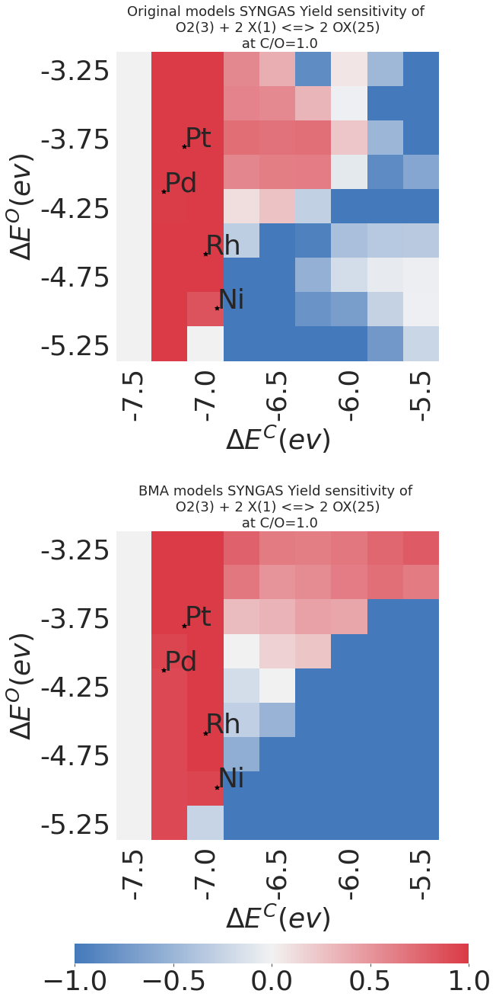

...

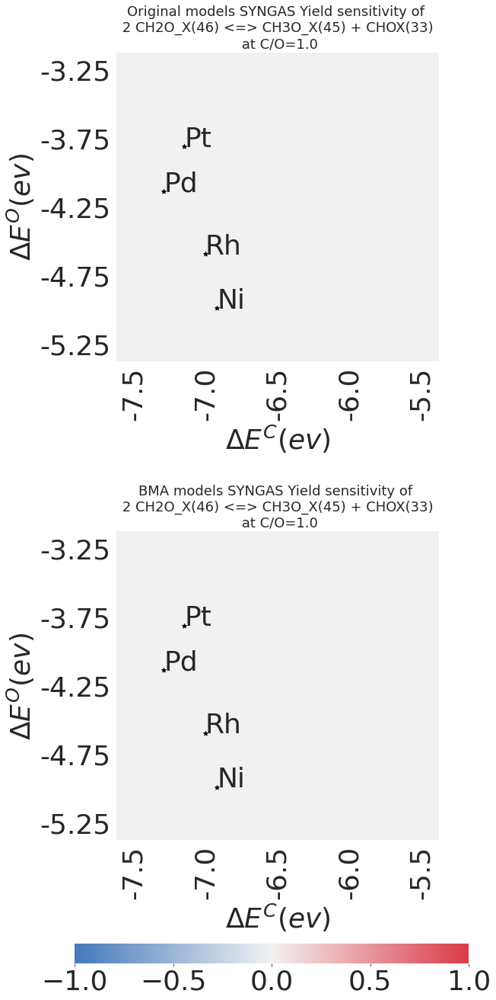

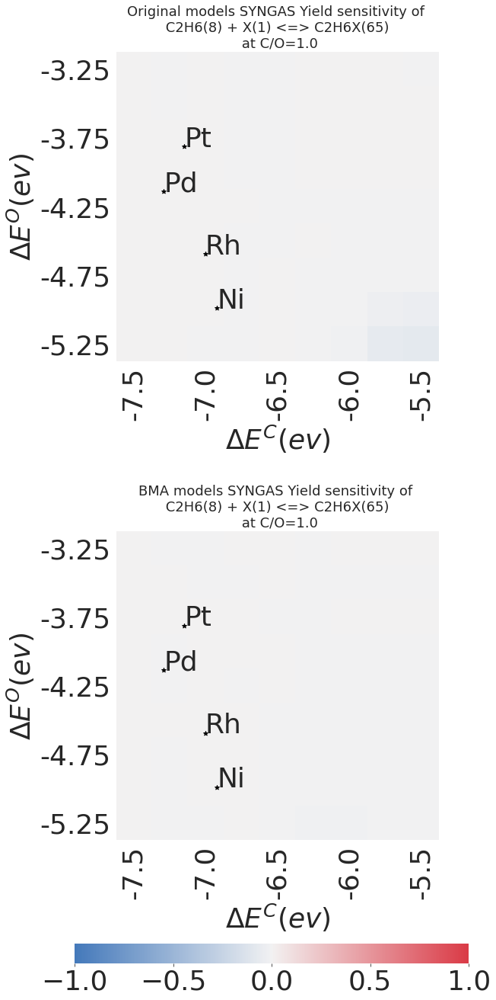

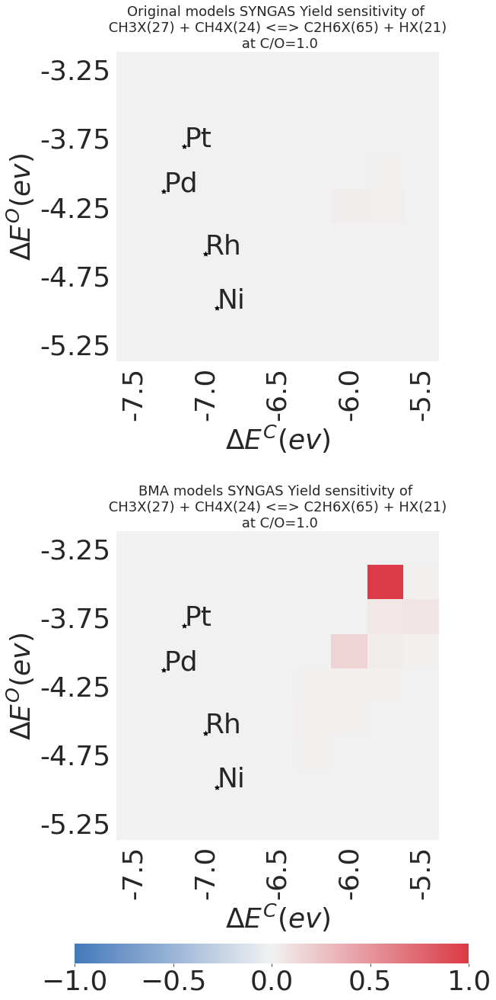

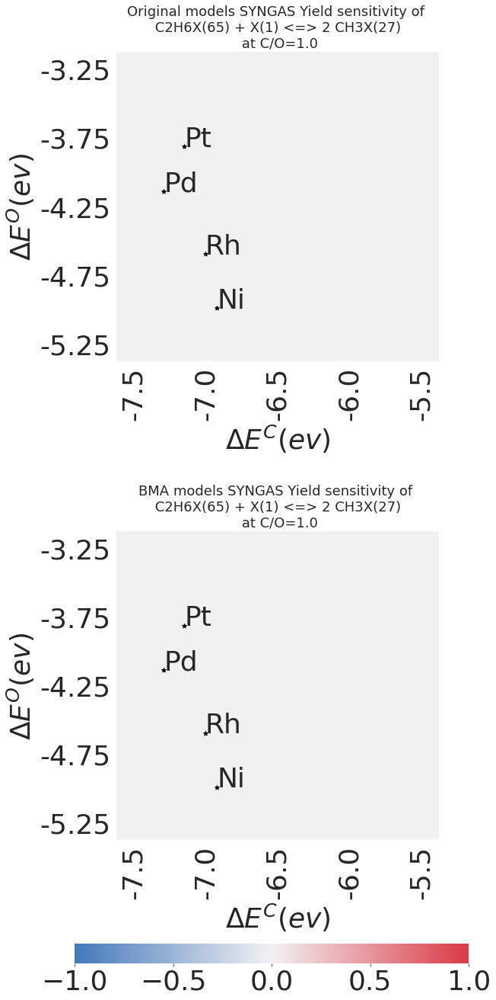

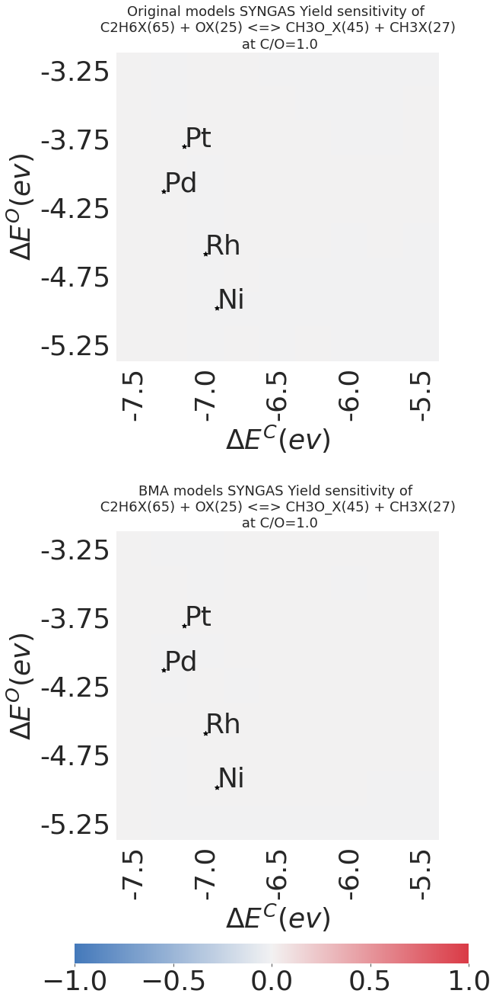

In [6]:
for i in range(107):
    heat_map_gen(i, 3, 1.0, 5, minimum=-1, maximum=1, title_name=True)

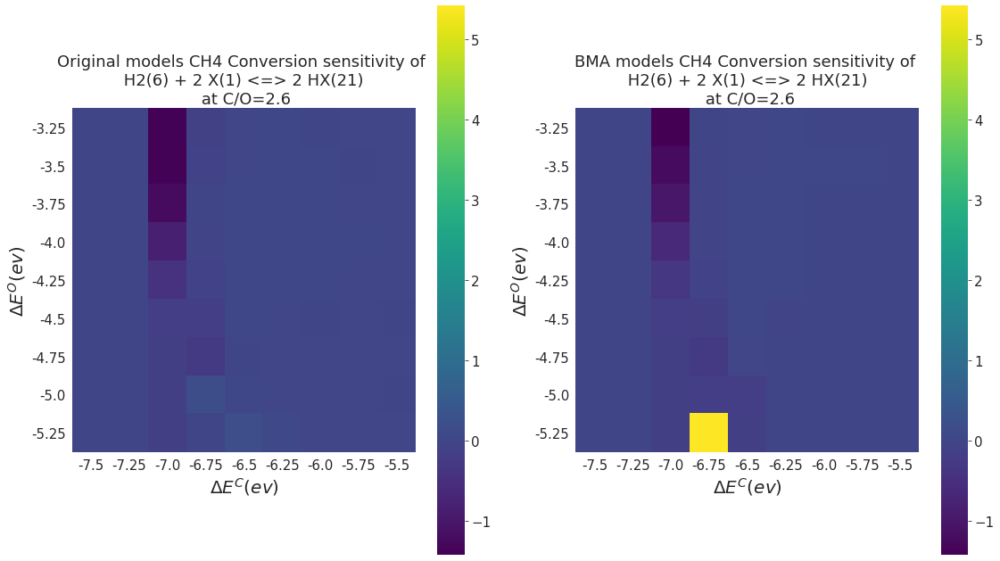

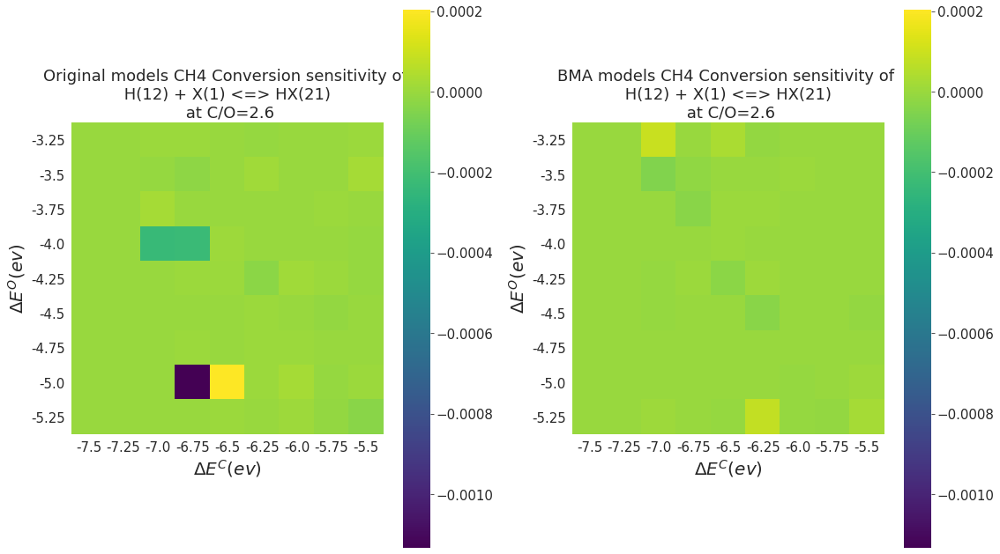

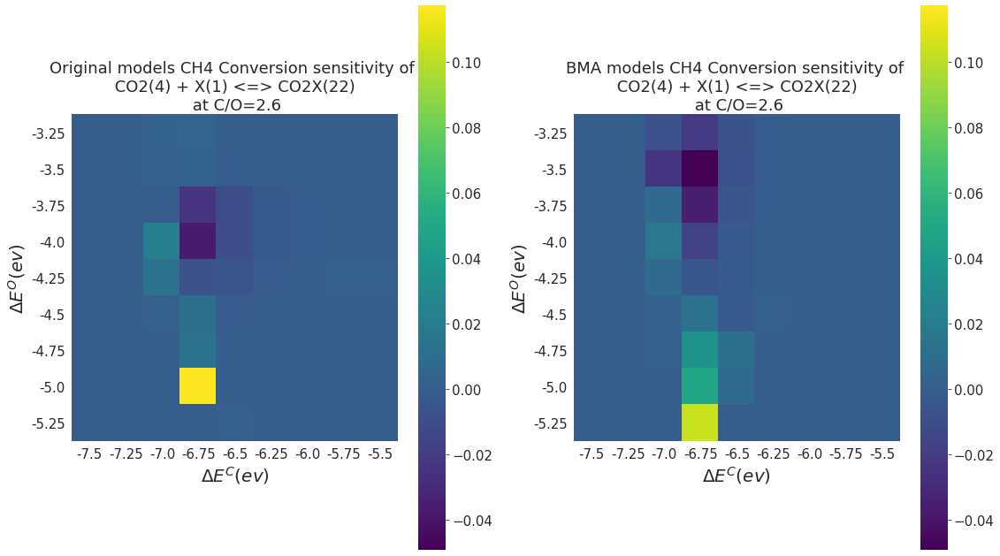

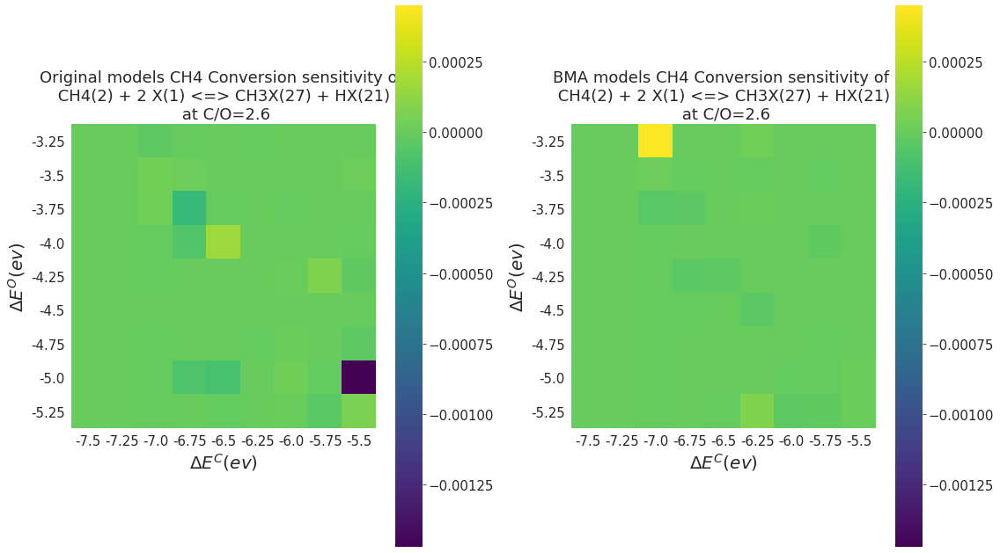

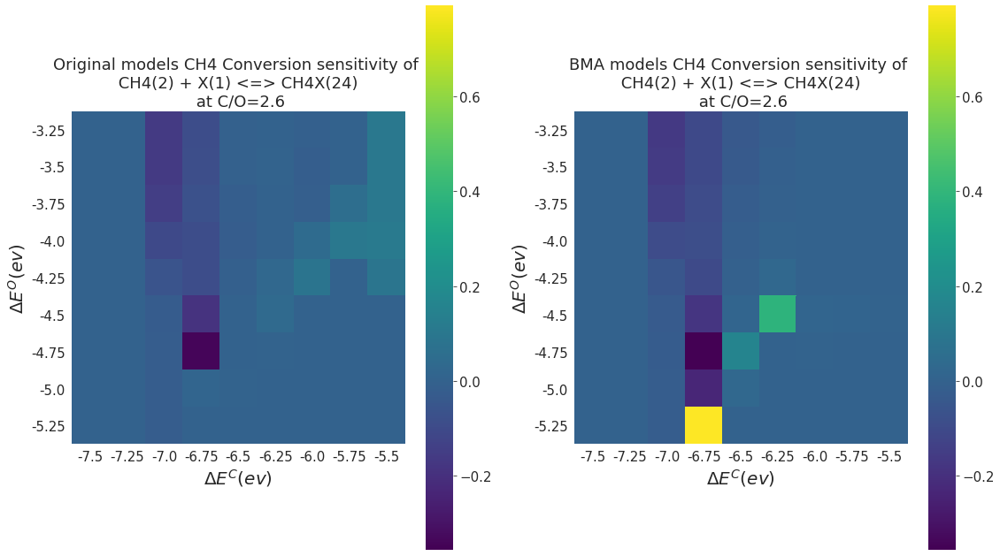

...

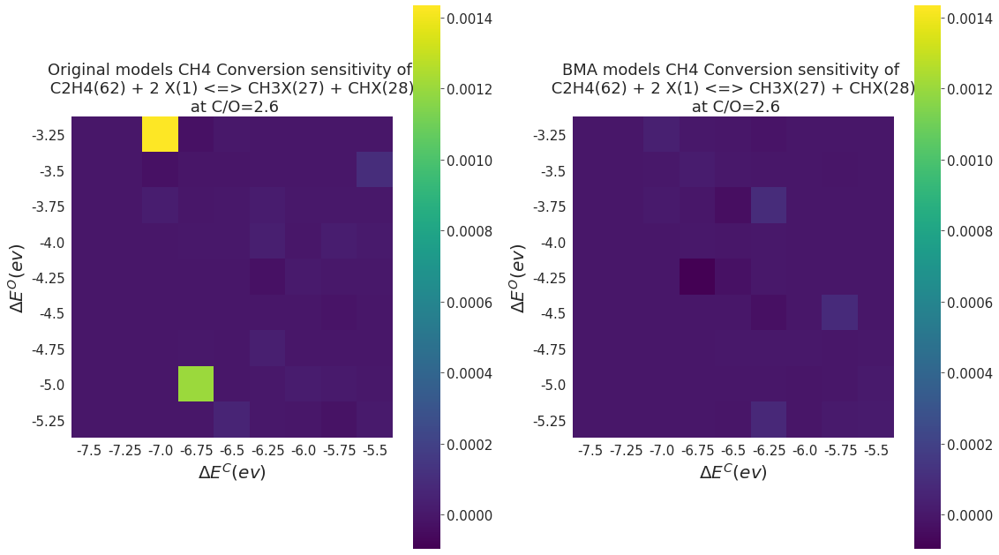

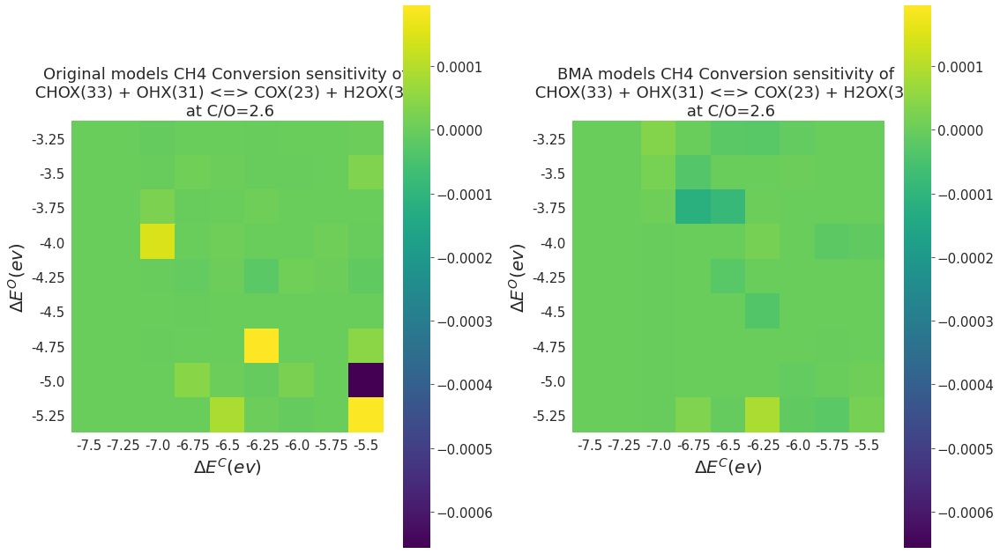

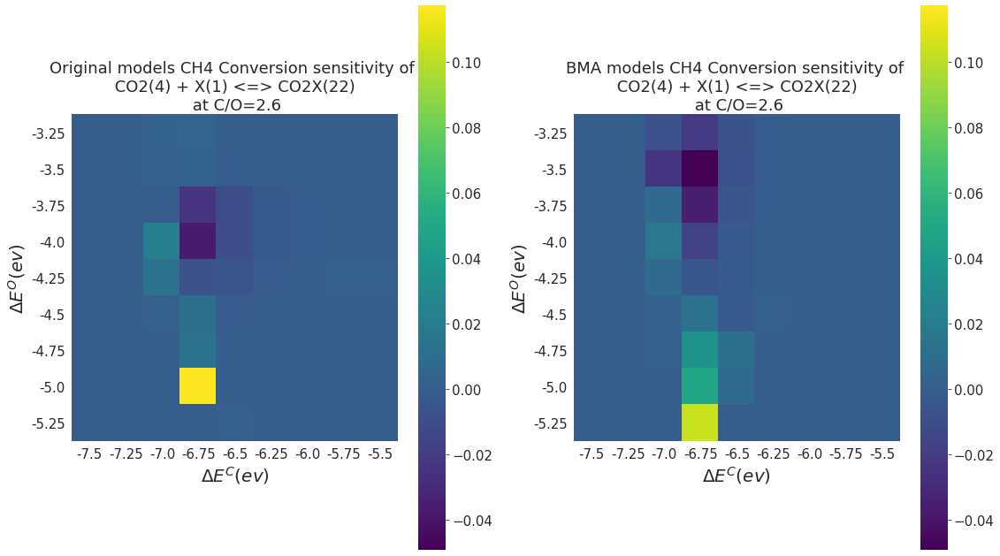

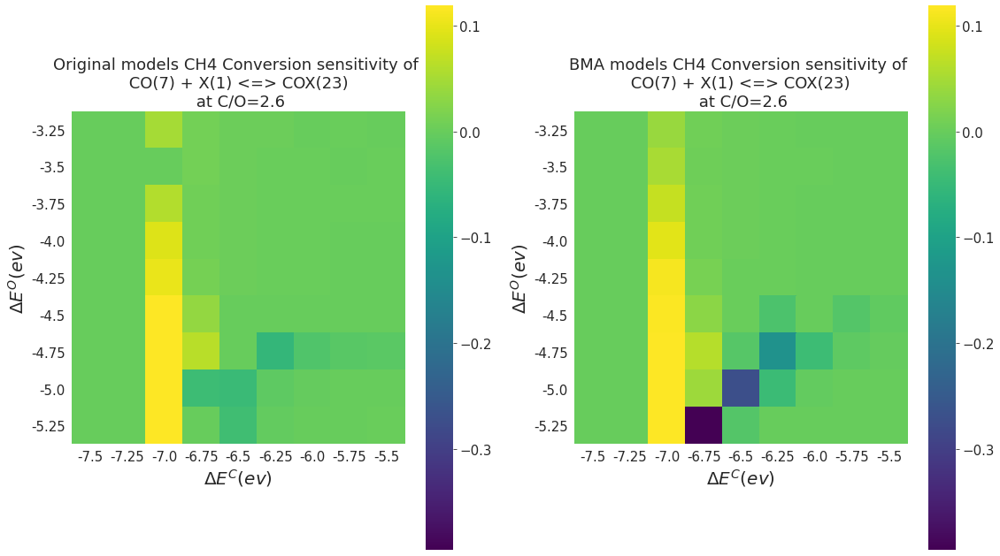

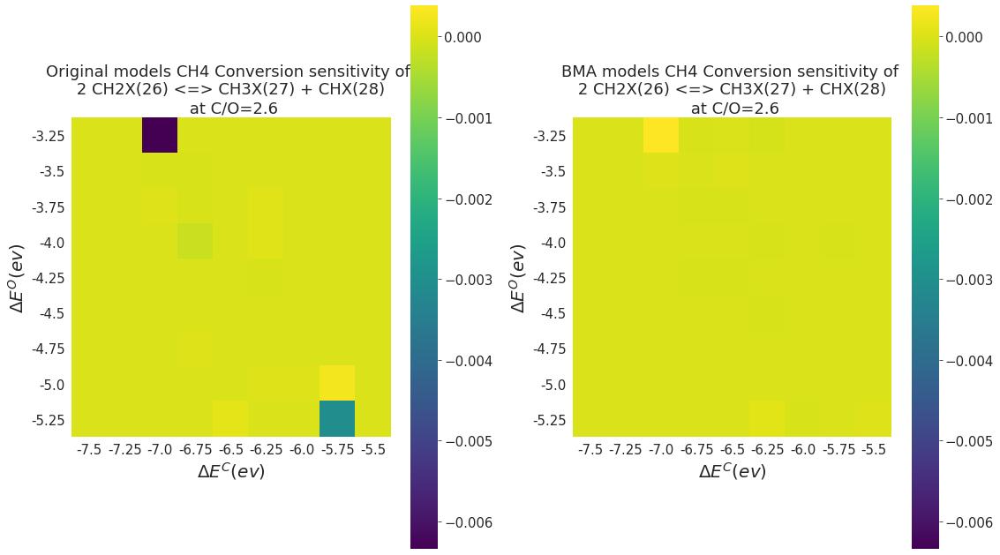

In [6]:
for i in sens_rxns_1:
    heat_map_gen(i, 8, 2.6, 10)

In [16]:
zero_ori_surfaces = [7, 8, 9, 16, 17, 18, 25, 26, 27, 35, 36, 44,45,68, 69, 70, 71, 72, 
                 73, 74, 75, 76, 77, 78, 79, 80, 81]
zero_bm_surfaces = [6, 7, 8, 9, 16, 17, 18, 25, 26, 27, 35, 36,45,68, 69, 70, 71, 72, 
                 73, 74, 75, 76, 77, 78, 79, 80, 81]

In [17]:
def heat_map_gen(rxn, property_, ratio, threshold):
    """
    rxn: index of reations
    property_: index of the property to plot
    ratio: the C/O input ratio
    threshold: threshold to rule out the outliers
    """
    benergy_c = np.arange(-7.5, -5.25, 0.25)
    benergy_o = np.arange(-3.25, -5.5, -0.25)
    data_original = np.zeros((len(benergy_c), len(benergy_o)))
    data_bm = np.zeros((len(benergy_c), len(benergy_o)))
    parent_dir = os.path.dirname(os.getcwd())
    # read the first file to extract the species and properties list
    f = f'{parent_dir}/base_original/binding_energies/1.0_c-5.50o-3.25/kinetic_sensitivity_data/0.6_sens_data.csv'
    df = pd.read_csv(f)
#     species = df.loc[:, 'Species'].to_list()
    properties = df.columns.to_list()
    
    total = 81
    i = -1
    paths = []
    for c_binding_energy in benergy_c:
        i += 1
        j = -1
        index = total - ((7.5 - abs(c_binding_energy)) / 0.25 + 1) * 9
        for o_binding_energy in benergy_o:
            j += 1
            index += 1

            if index not in zero_ori_surfaces:
                # read the simulation files
                original_path_sens = '{}/base_original/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
                if os.path.exists(original_path_sens):
                    df_original = pd.read_csv(original_path_sens)
                    charac_sens_original = df_original.loc[df_original['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                    if abs(charac_sens_original) >= threshold:
                        data_original[j][i] = 0
                    else:
                        data_original[j][i] = charac_sens_original
            if index not in zero_bm_surfaces:
                bm_path_sens = '{}/base_bm/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
                if os.path.exists(bm_path_sens):
                    df_bm = pd.read_csv(bm_path_sens)
                    charac_sens_bm = df_bm.loc[df_bm['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                    if abs(charac_sens_bm) >= threshold:
                        data_bm[j][i] = 0
                    else:
                        data_bm[j][i] = charac_sens_bm
                    
    original_df = pd.DataFrame(data_original, columns=benergy_c, index=benergy_o)
    bm_df = pd.DataFrame(data_bm, columns=benergy_c, index=benergy_o)
    minimum = min(original_df.min().min(), bm_df.min().min())
    maximum = max(original_df.max().max(), bm_df.max().max())
    sns.set_style("darkgrid")
    fig = plt.figure(figsize=(16,9))
    ax1 = fig.add_subplot(121, aspect='equal')
    ax2 = fig.add_subplot(122, aspect='equal')
    cmap = sns.color_palette("viridis", as_cmap=True)
    ax1 = sns.heatmap(original_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax1, vmin=minimum, vmax=maximum)
    ax1.set(title="original models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio),
          xlabel="$\\Delta E^C(ev)$",
          ylabel="$\\Delta E^O(ev)$",)
    ax2 = sns.heatmap(bm_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax2, vmin=minimum, vmax=maximum)
    ax2.set(title="bm models {} sensitivity of species \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio),
          xlabel="$\\Delta E^C(ev)$",
          ylabel="$\\Delta E^O(ev)$",)
    plt.plot()

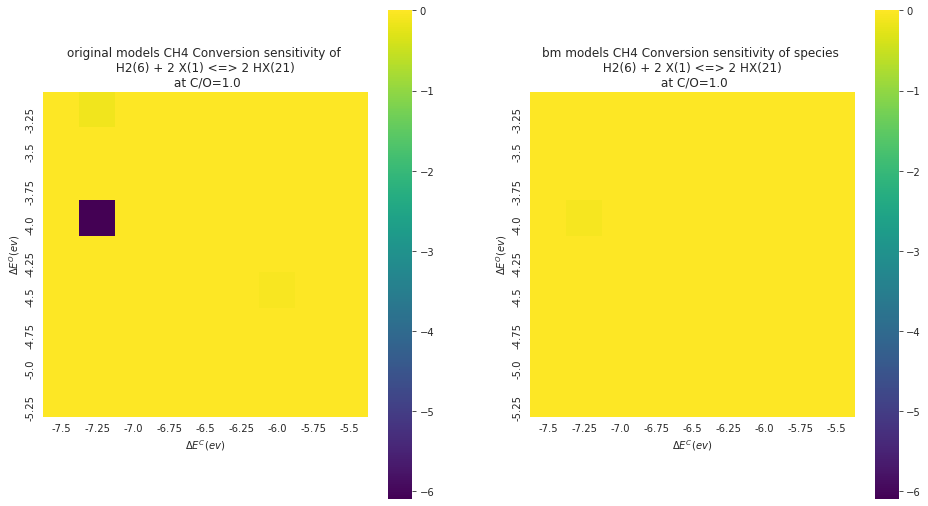

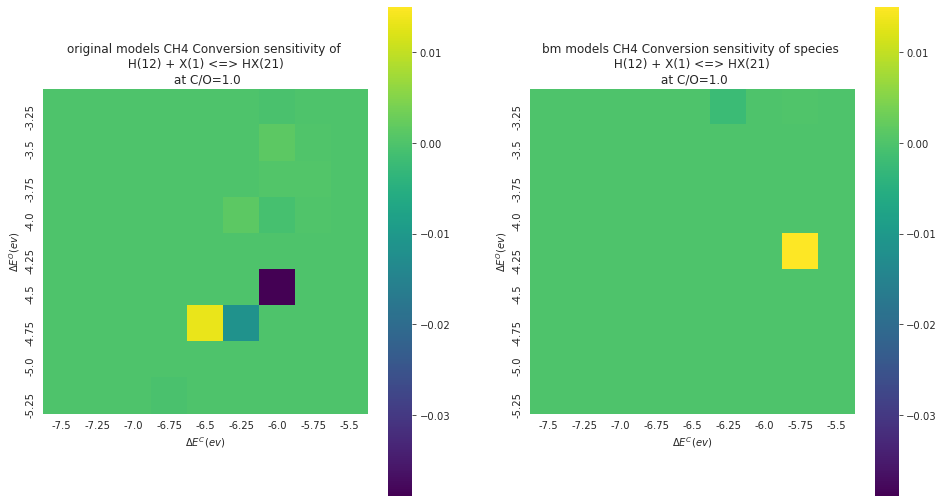

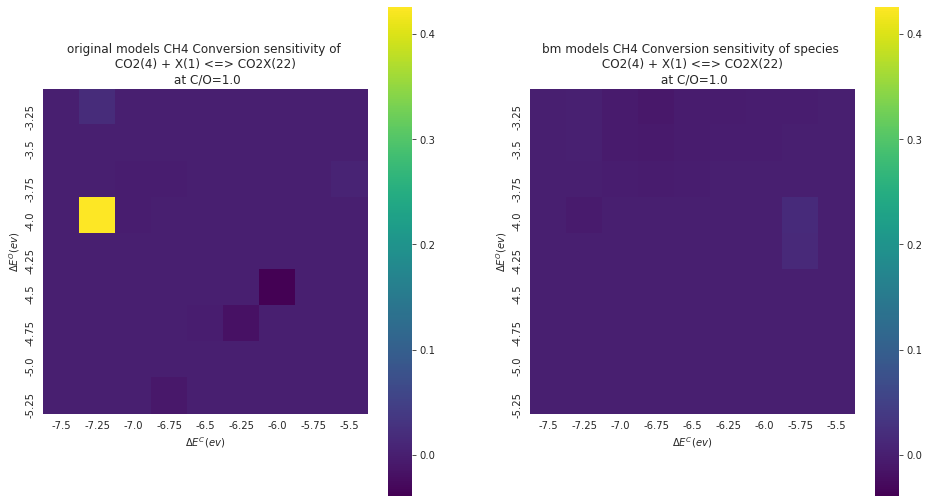

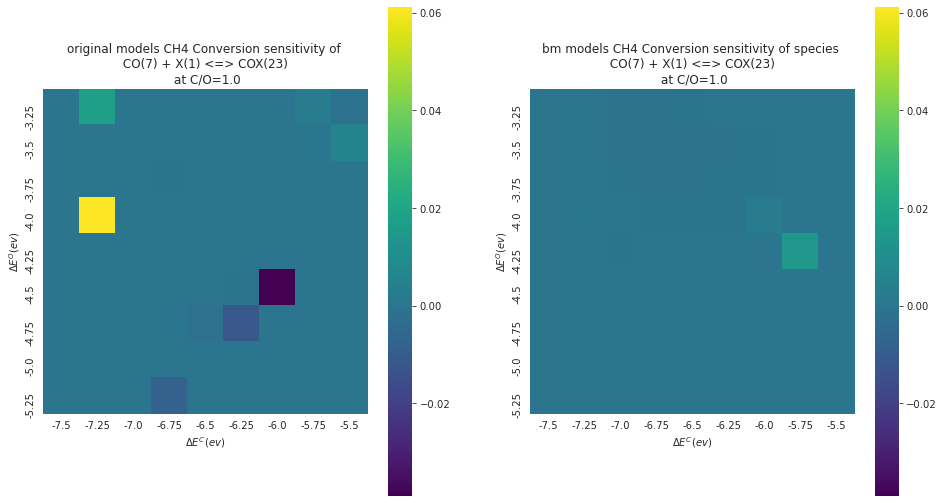

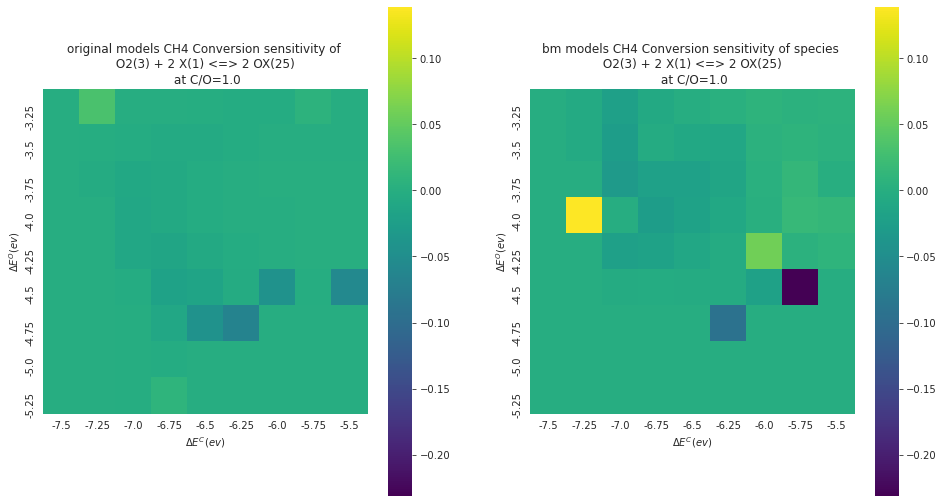

...

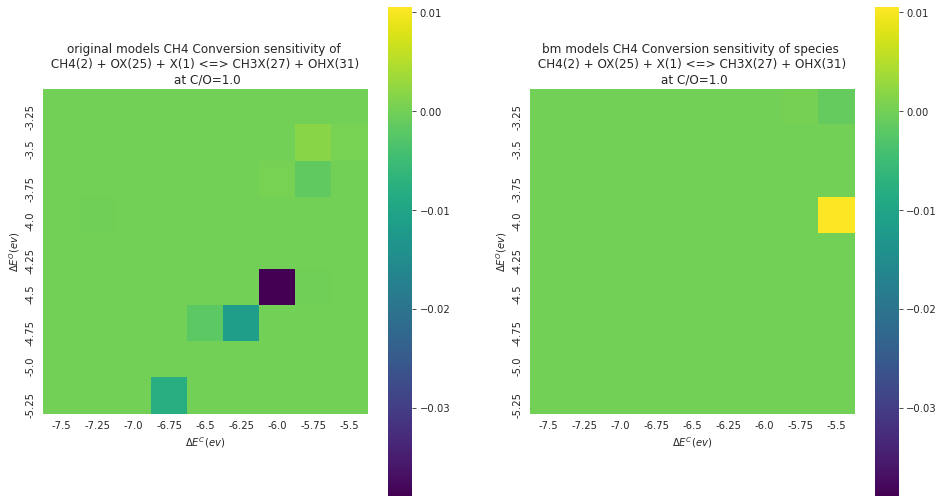

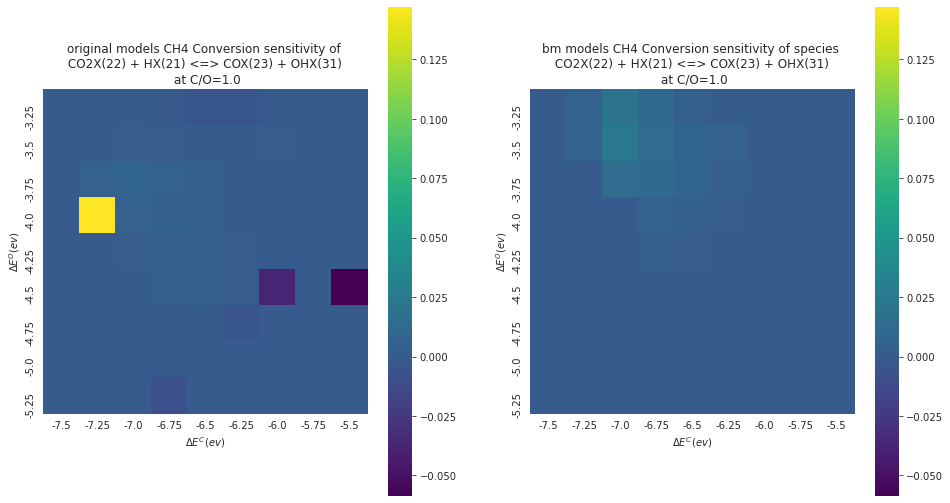

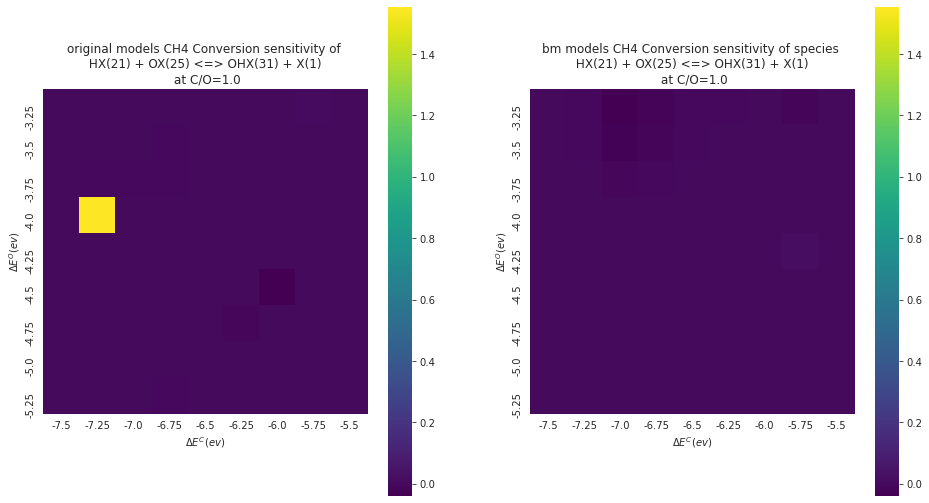

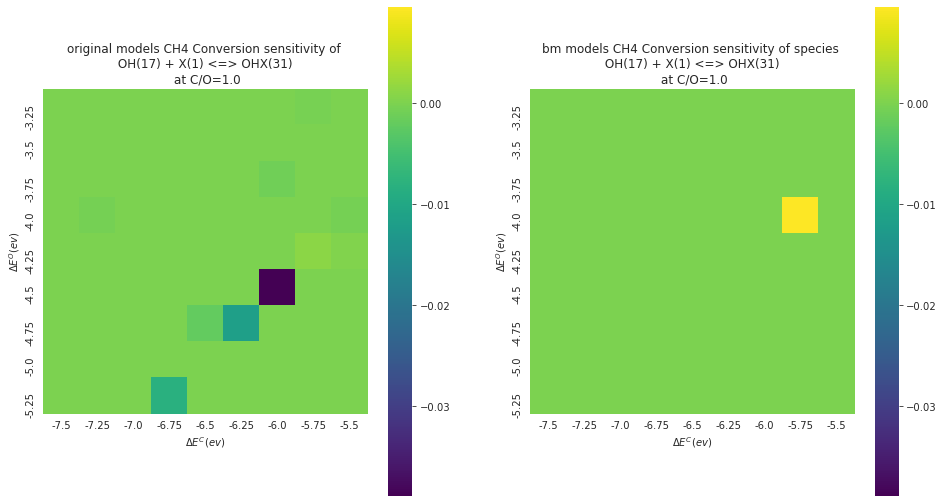

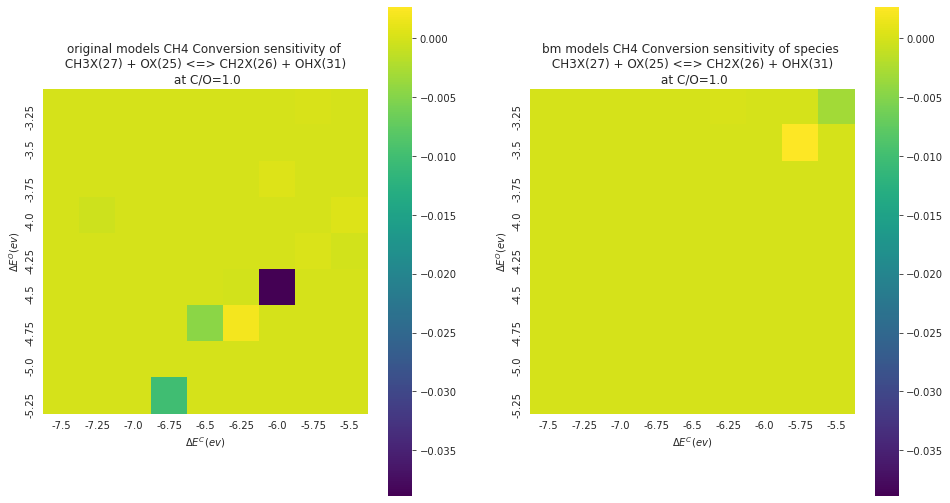

In [22]:
for i in range(20):
    heat_map_gen(i, 8, 1.0, 10)

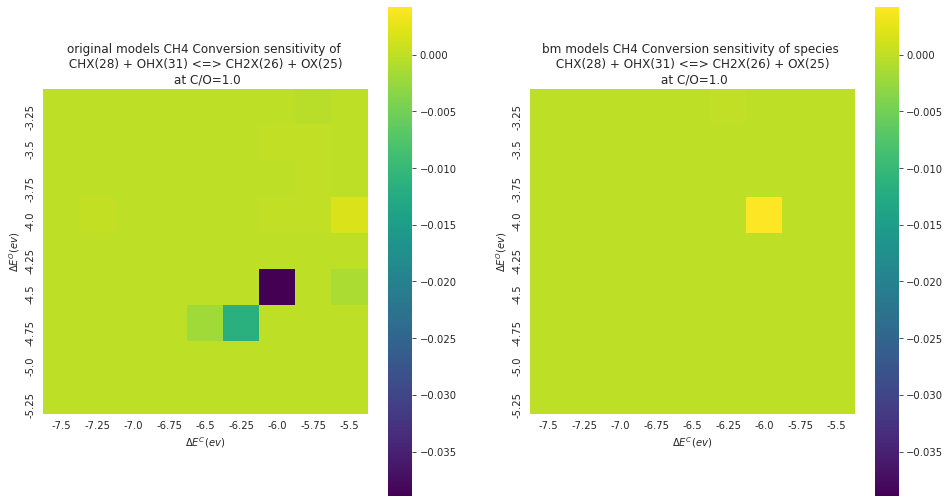

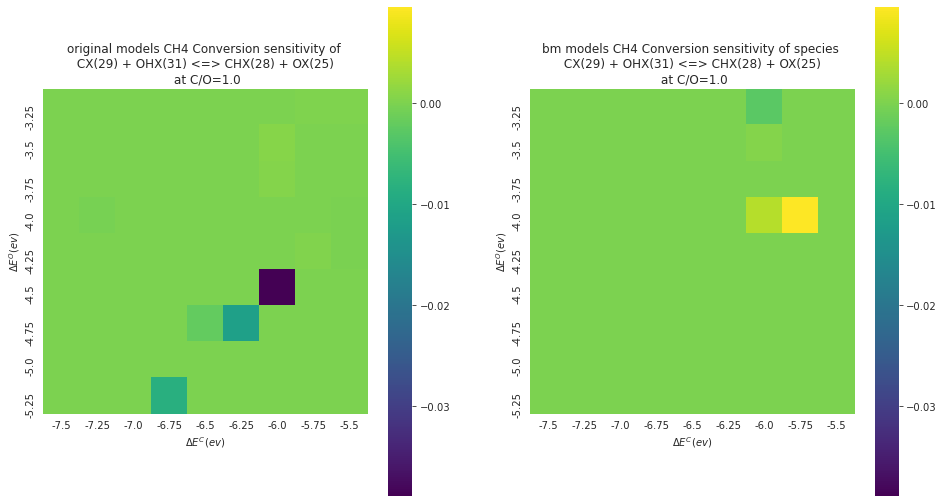

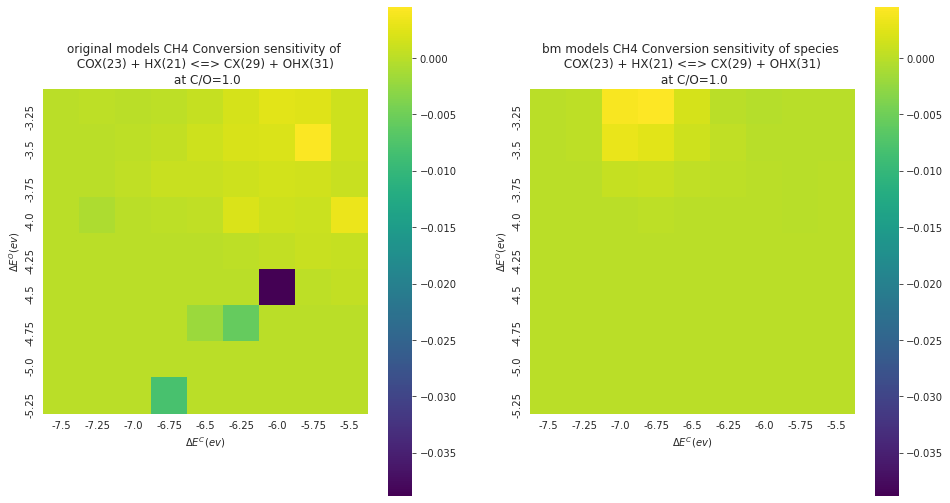

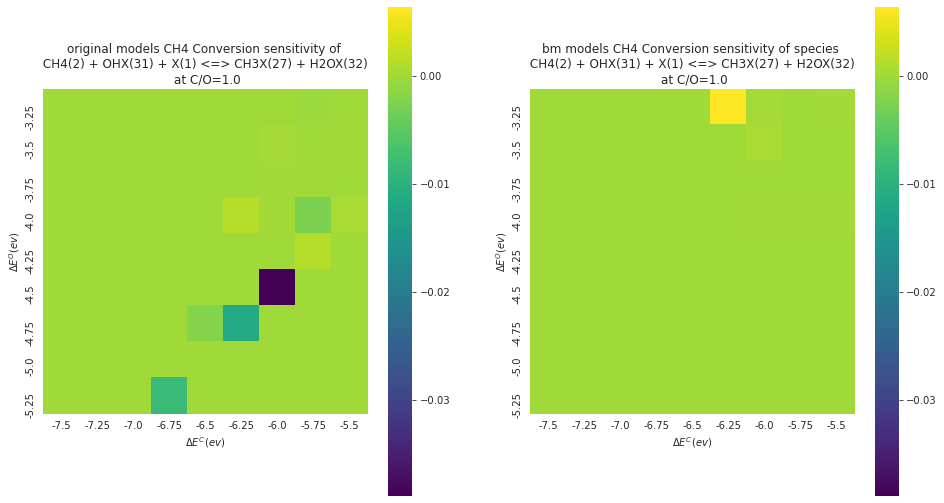

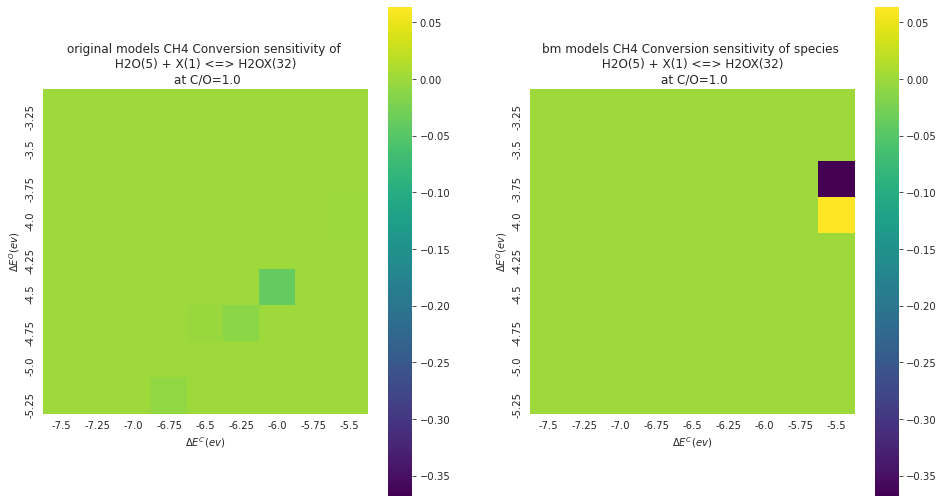

...

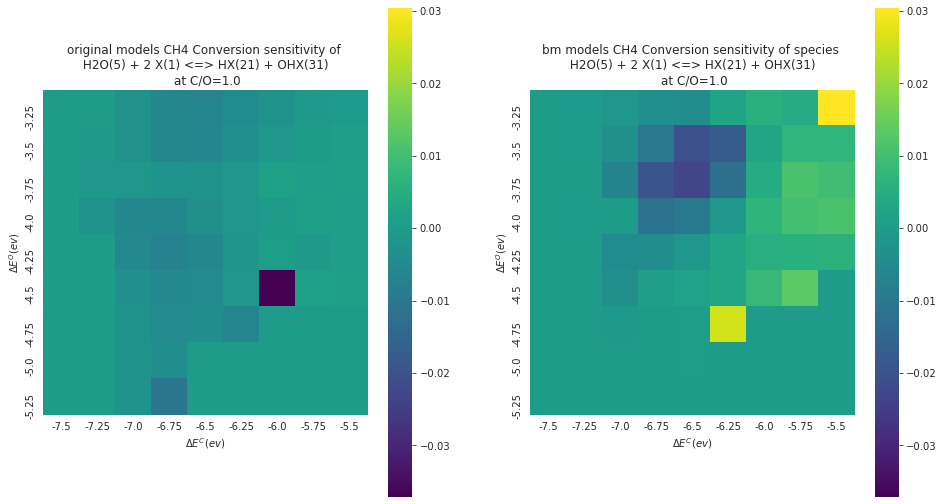

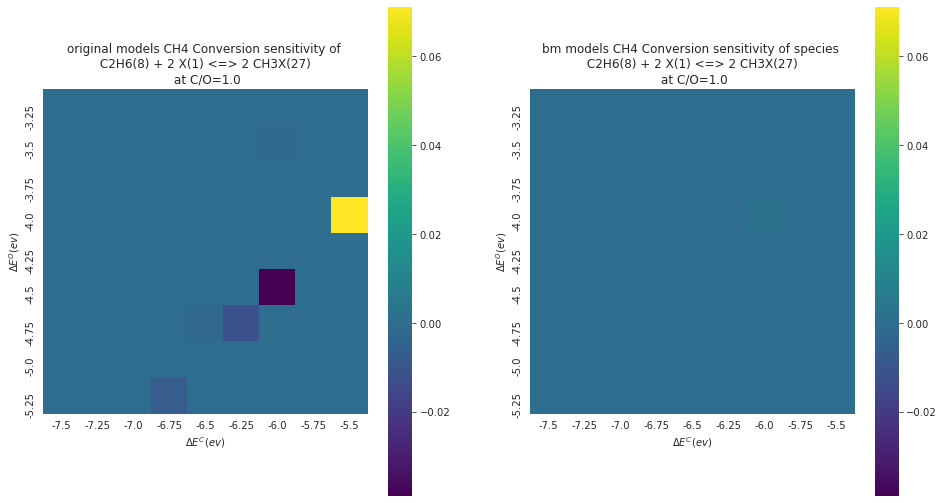

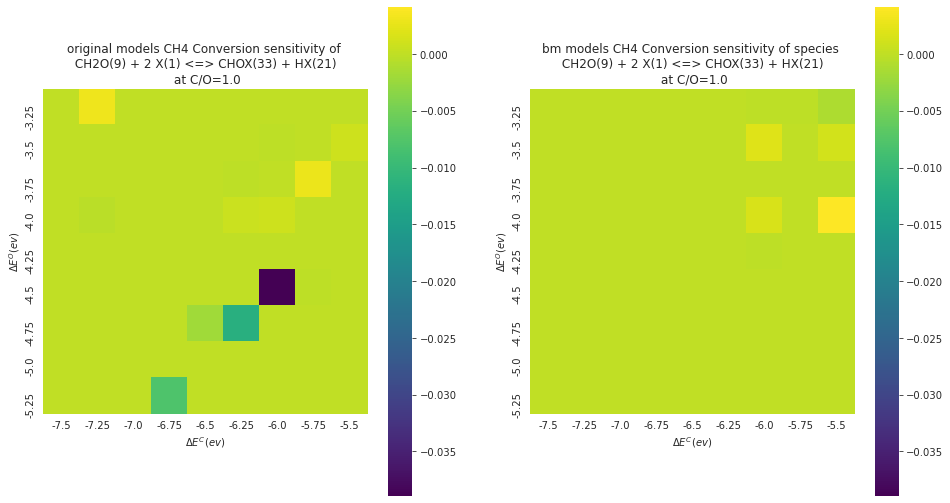

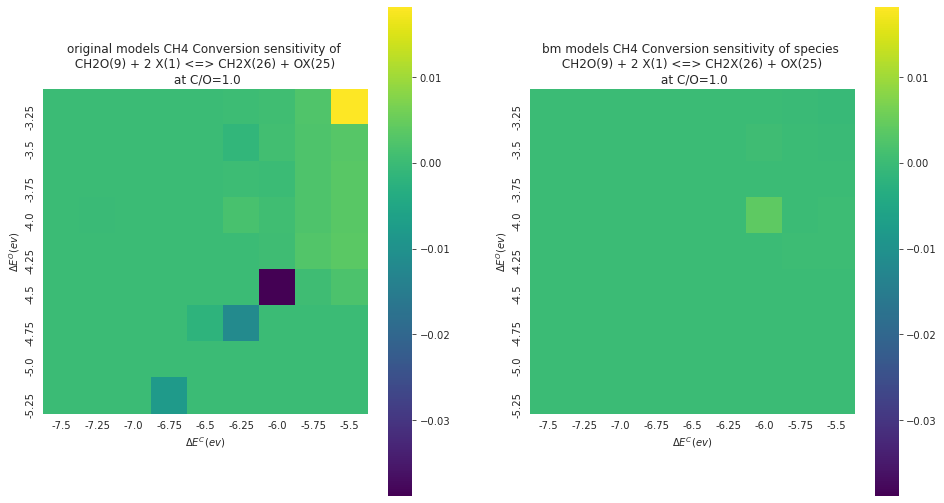

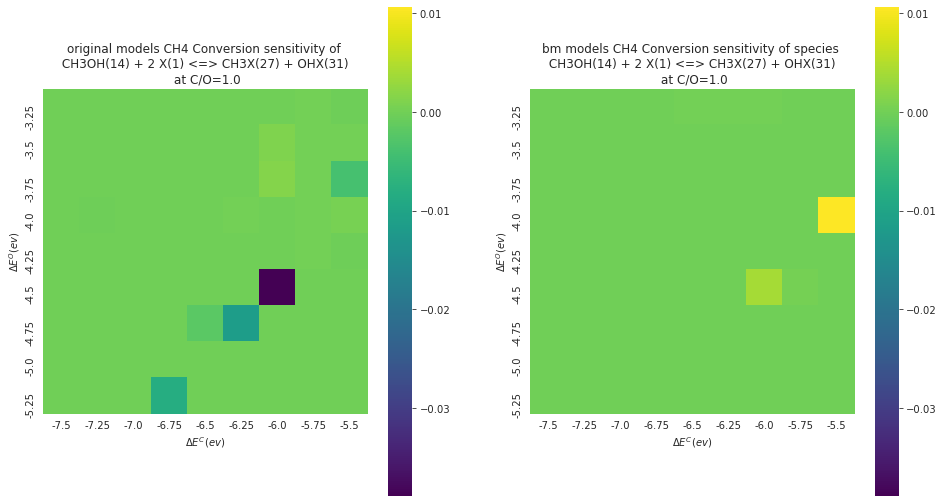

In [23]:
for i in range(20, 40):
    heat_map_gen(i, 8, 1.0, 10)

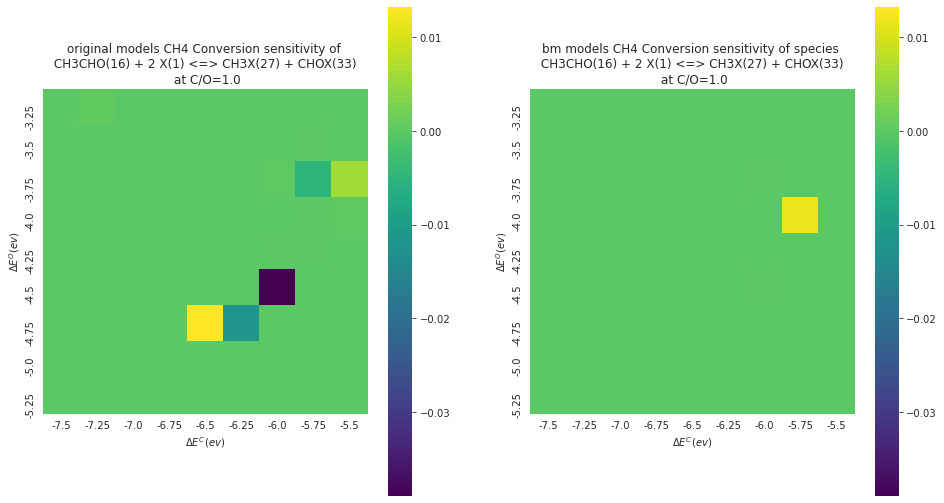

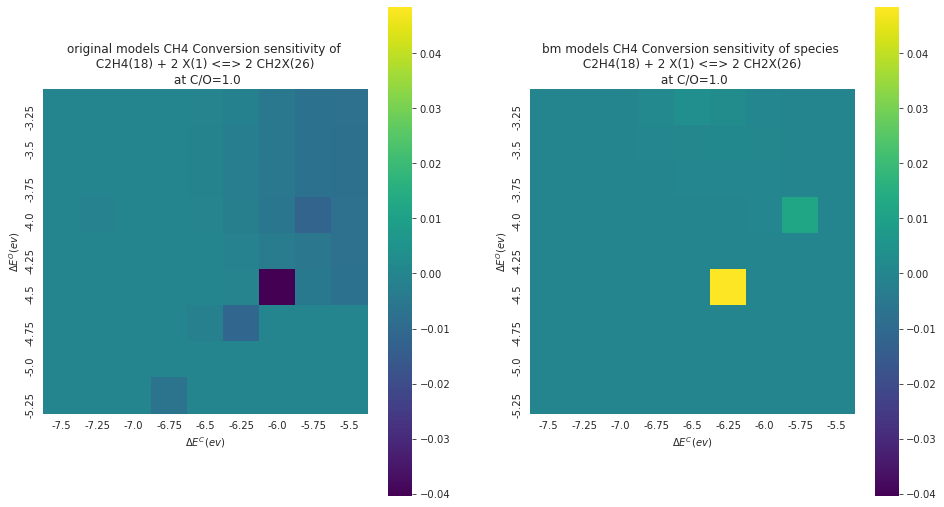

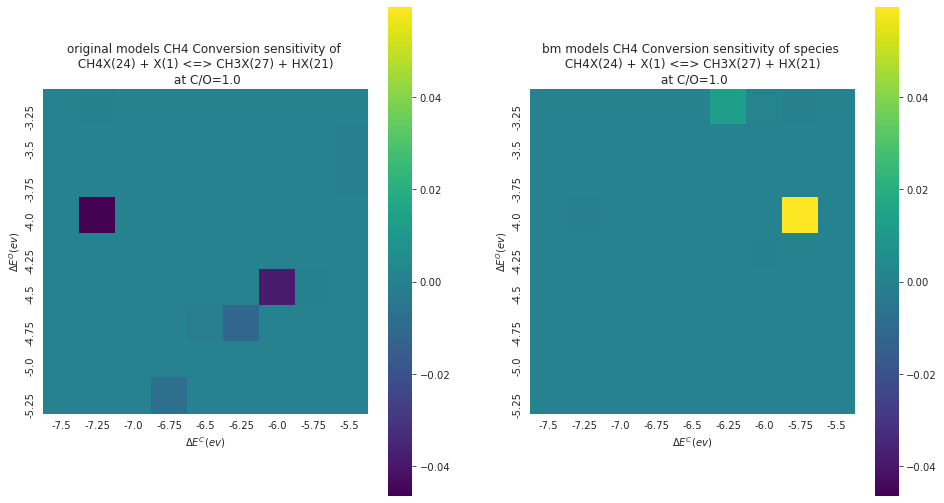

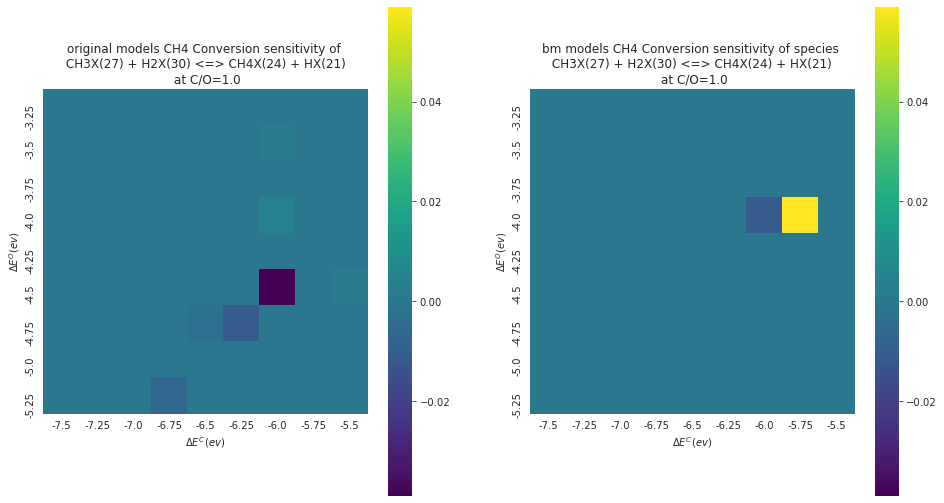

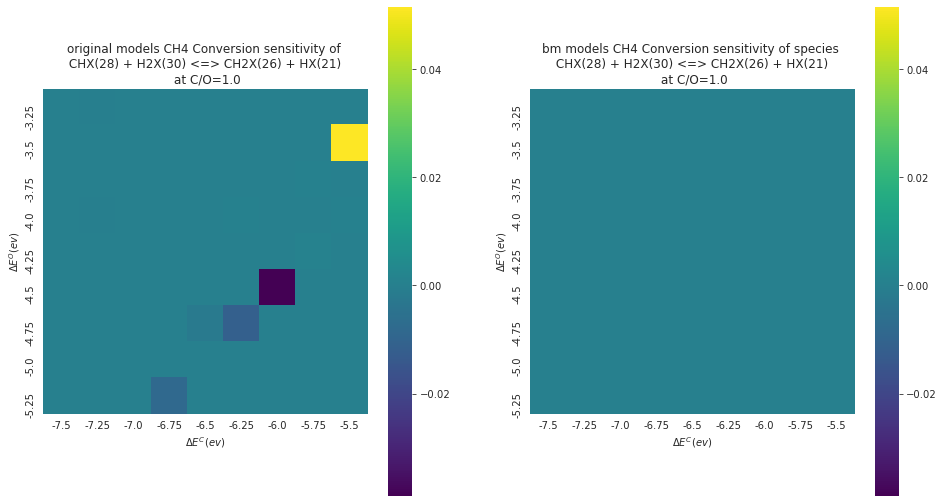

...

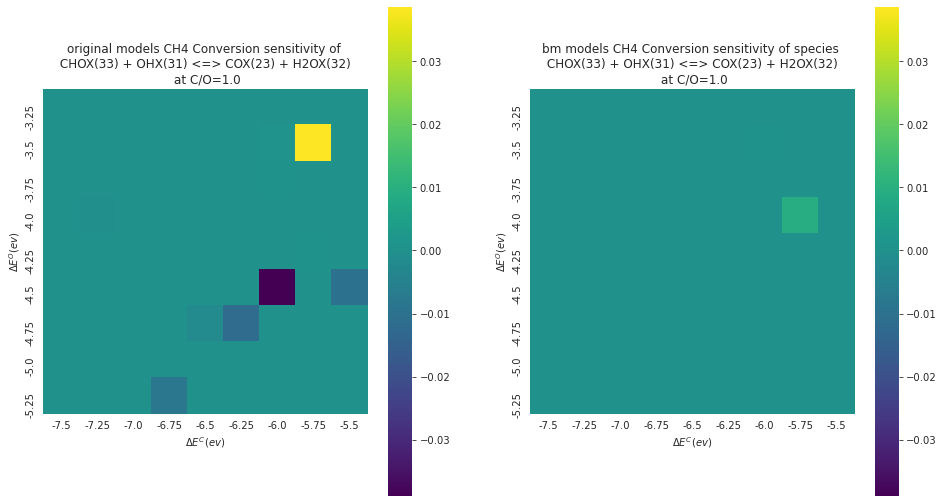

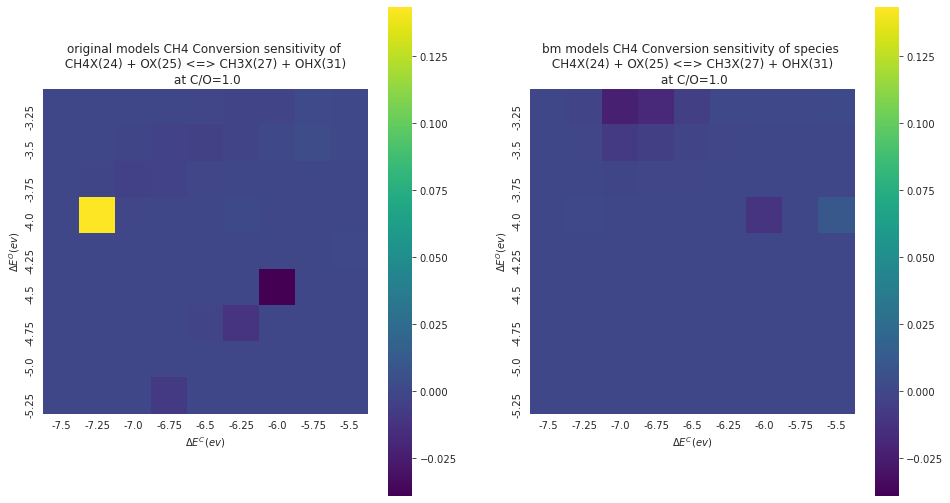

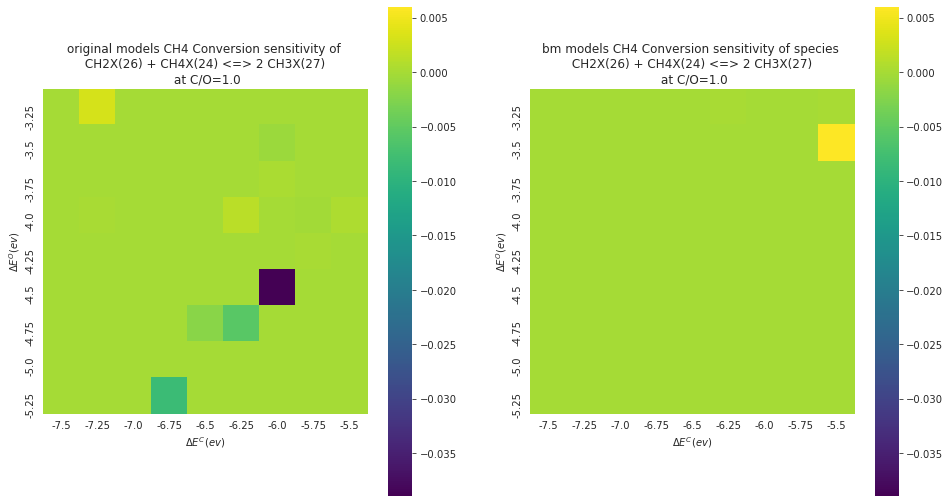

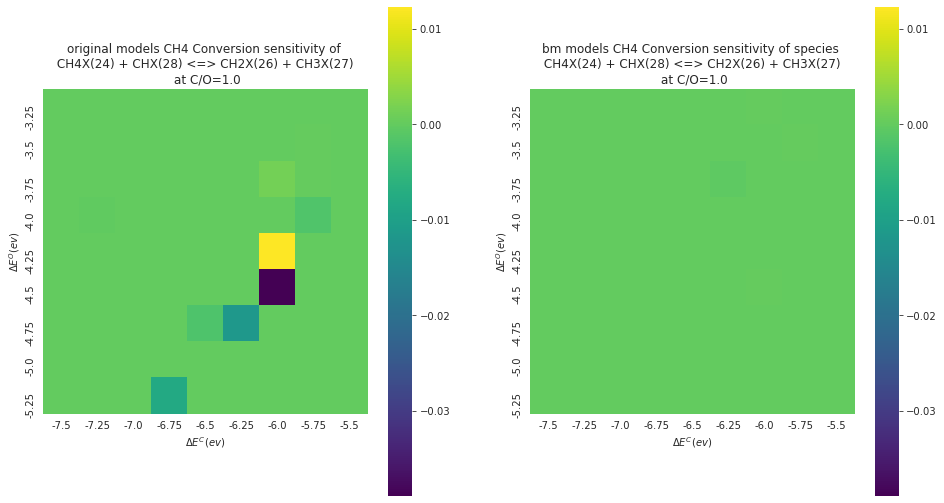

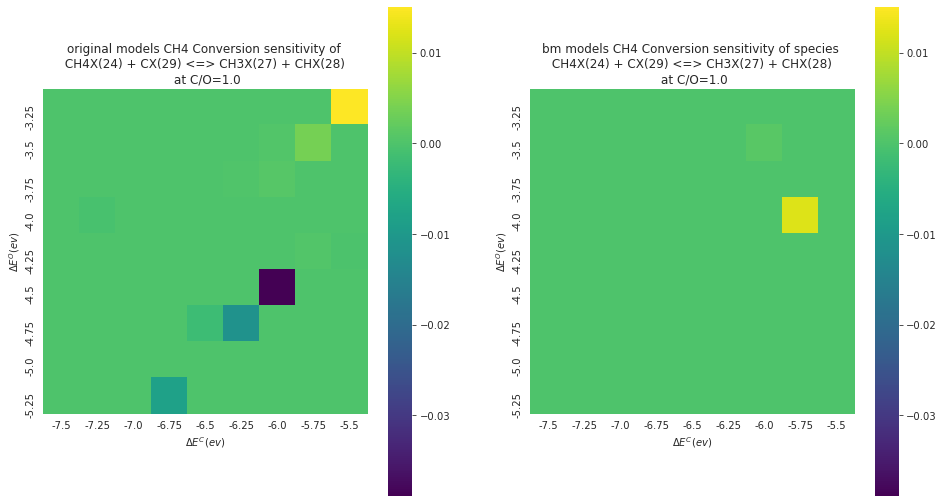

In [24]:
for i in range(40, 60):
    heat_map_gen(i, 8, 1.0, 10)

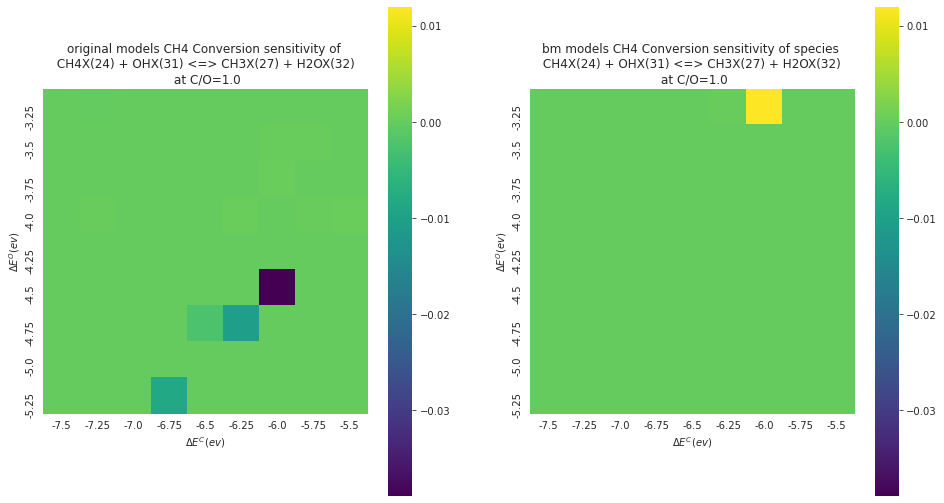

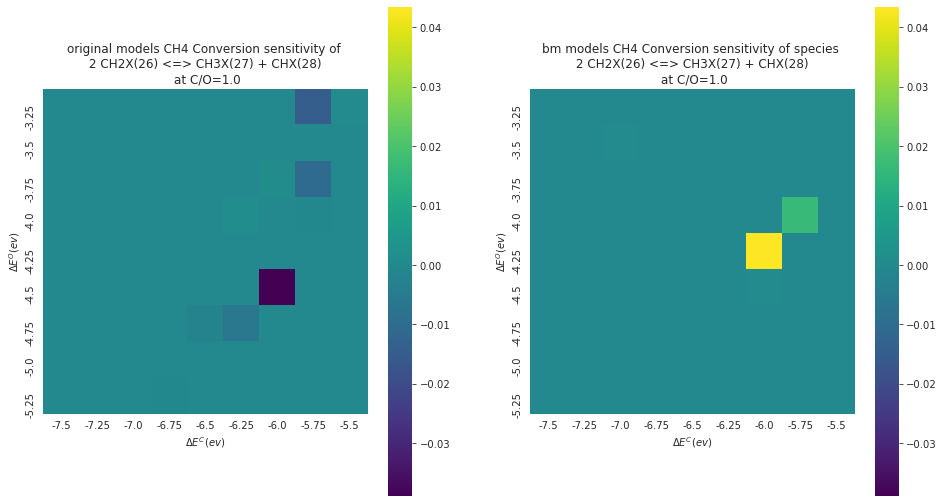

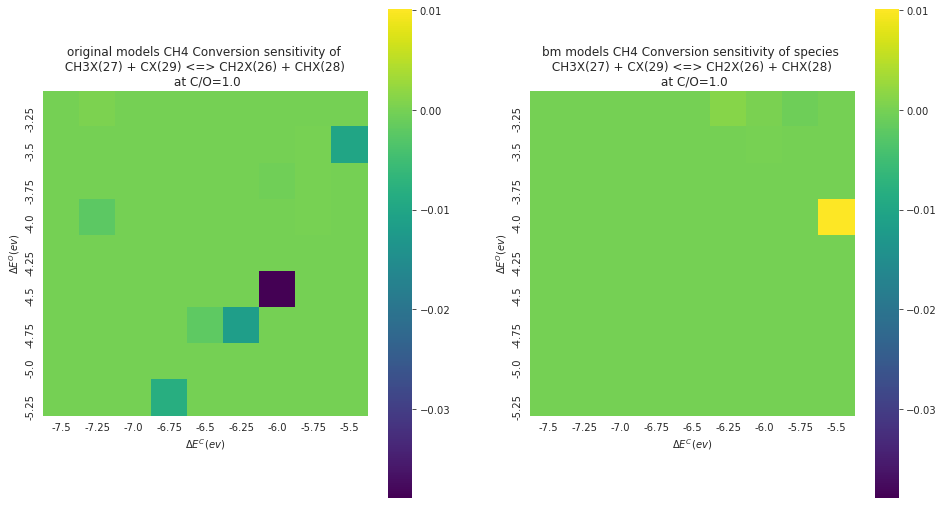

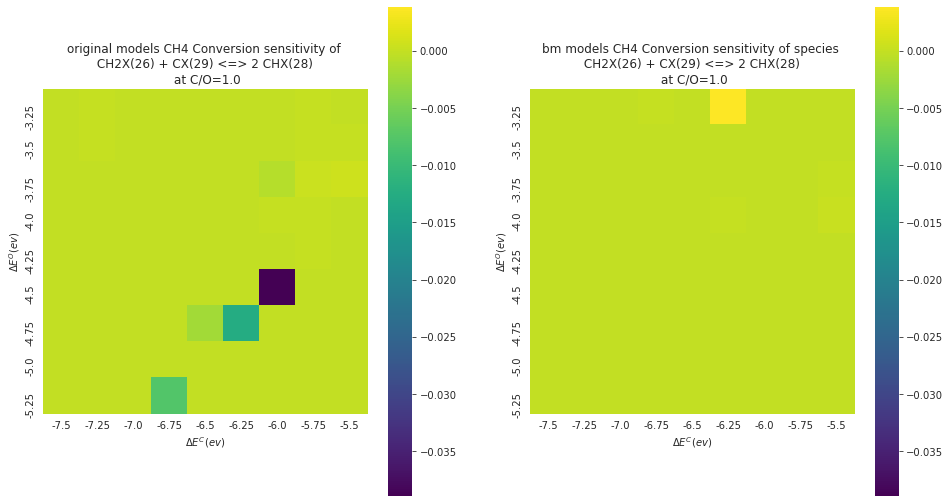

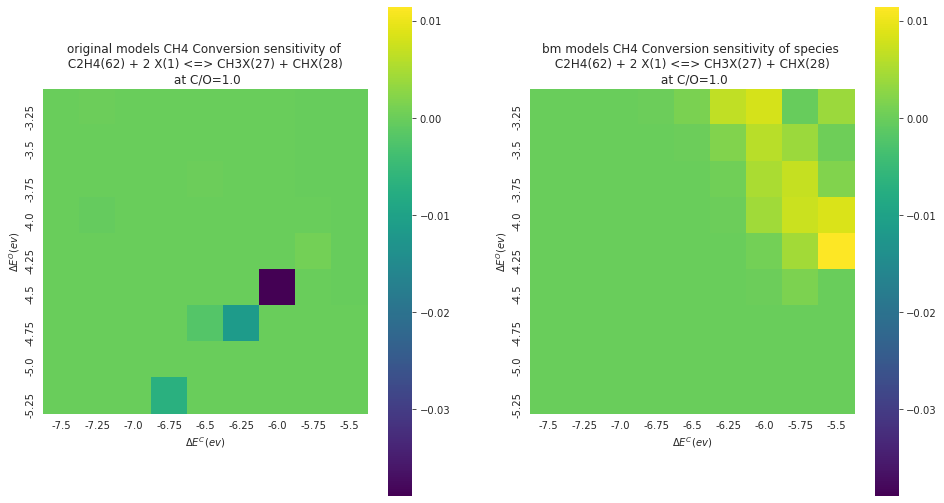

...

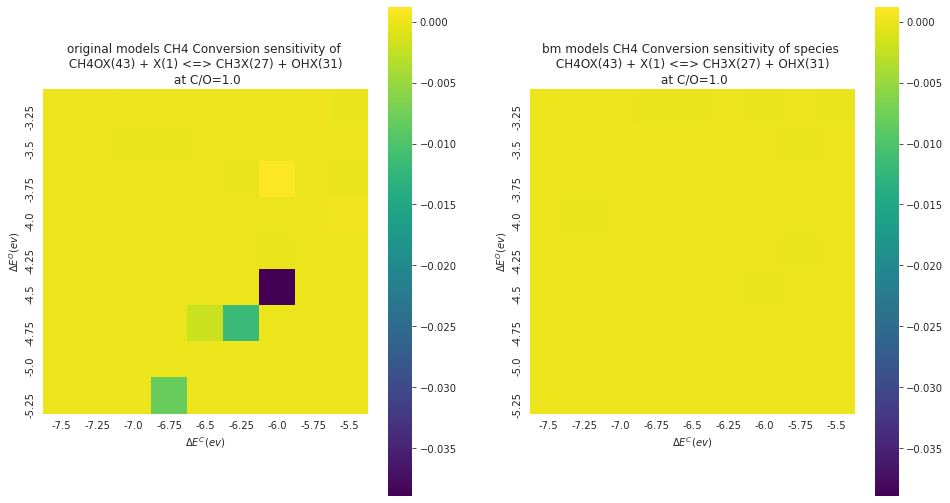

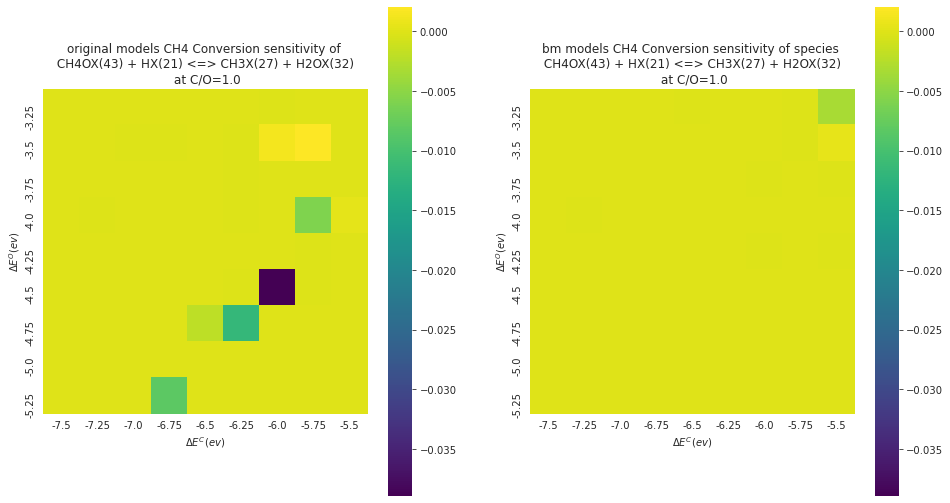

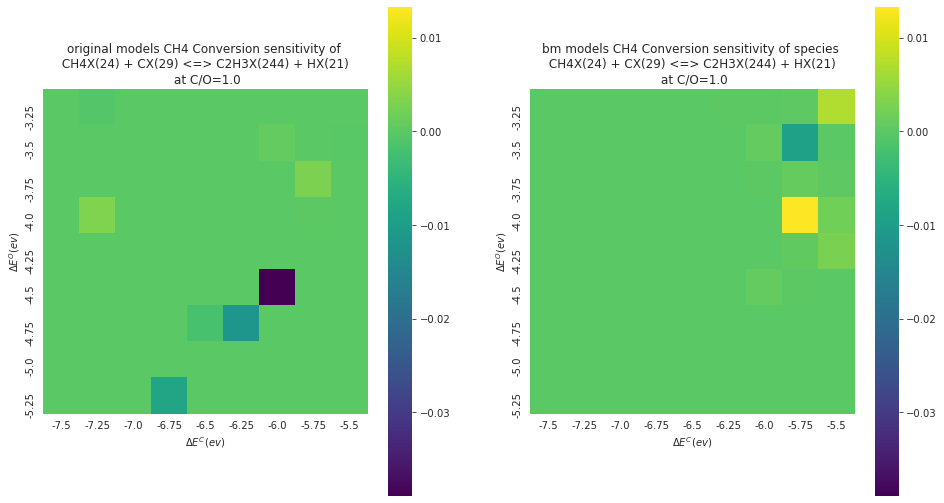

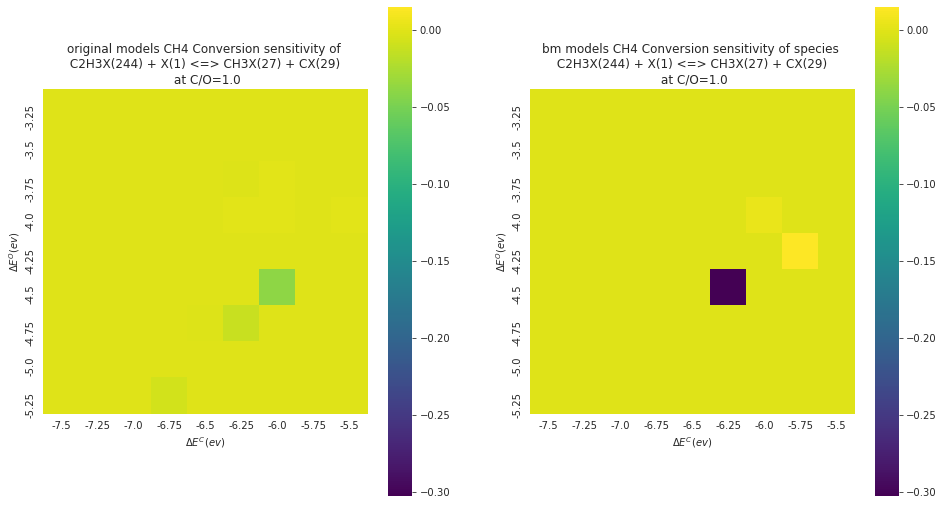

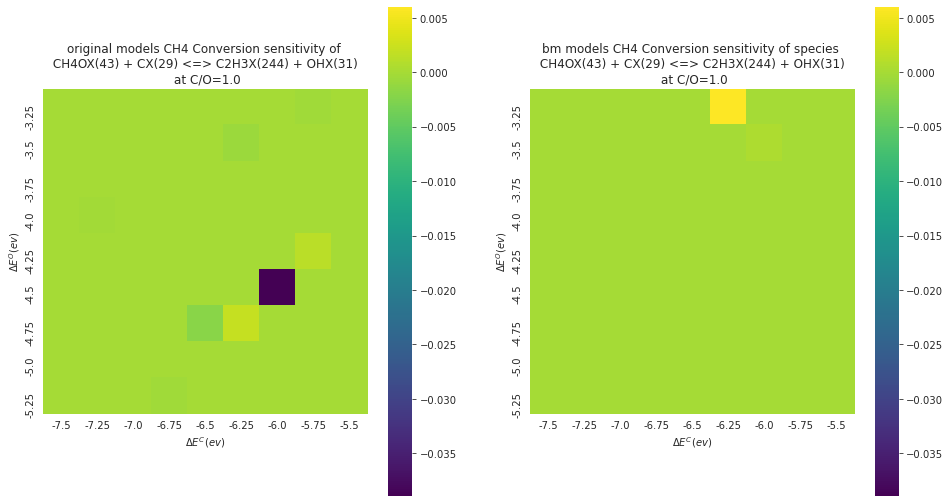

In [25]:
for i in range(60, 80):
    heat_map_gen(i, 8, 1.0, 10)

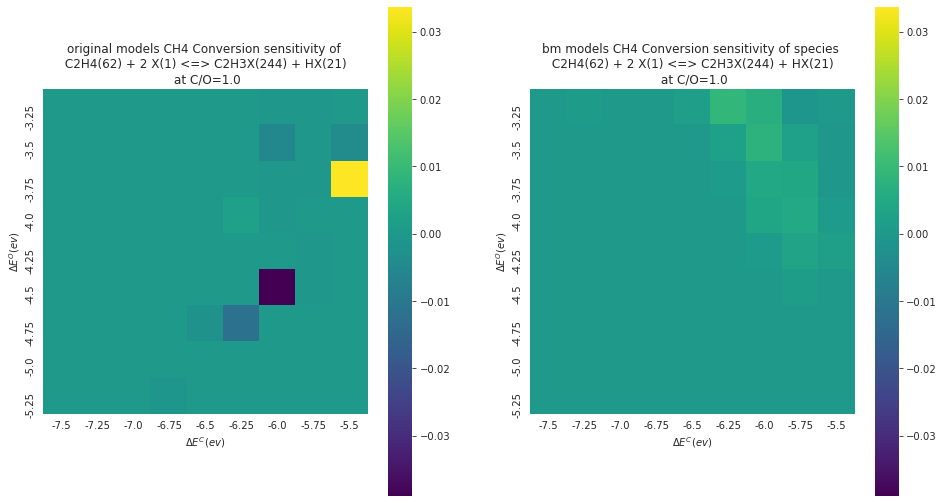

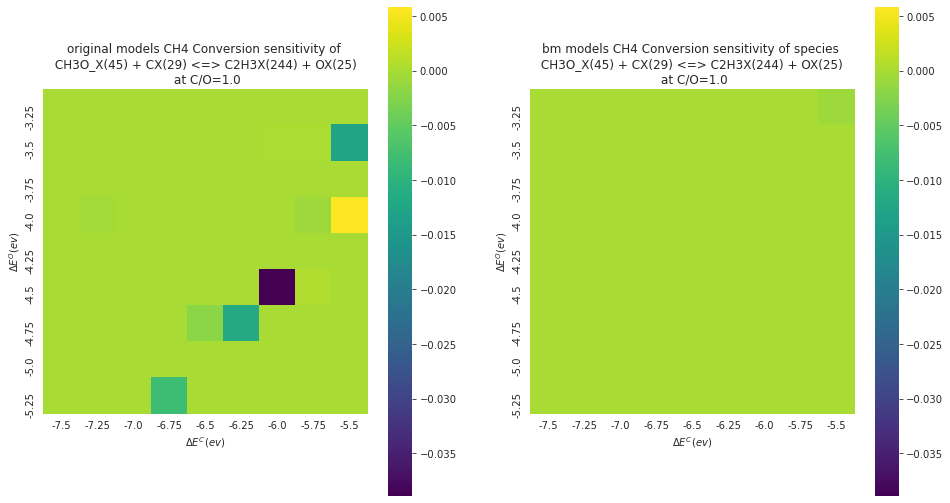

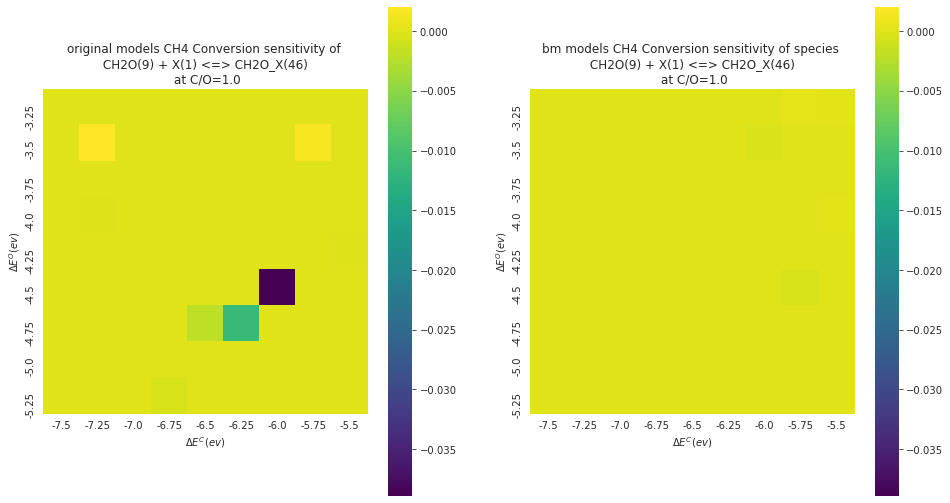

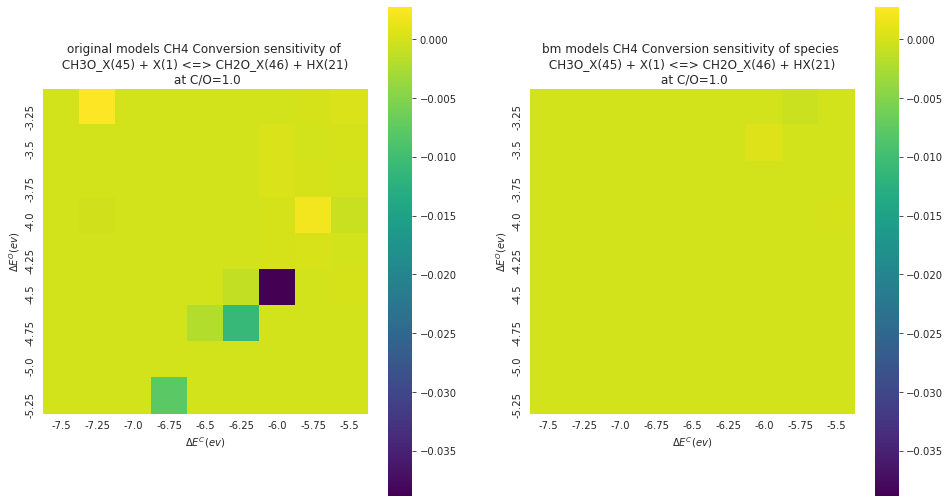

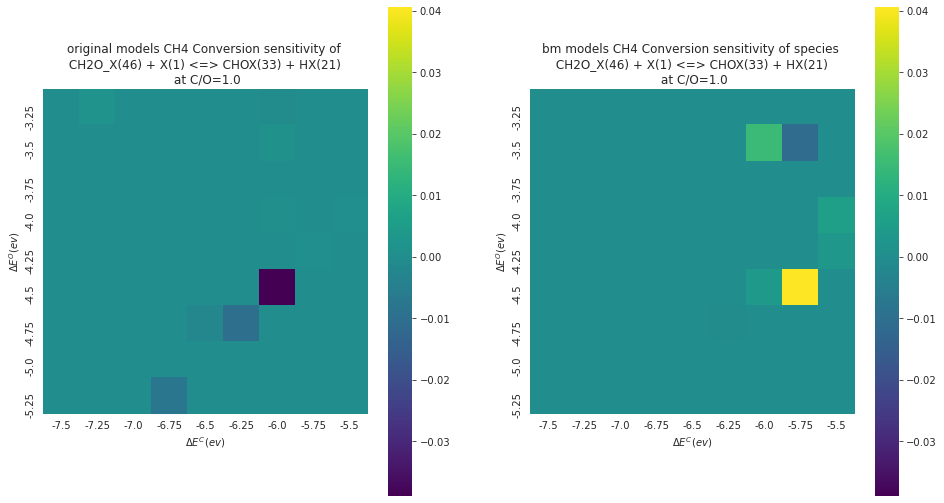

...

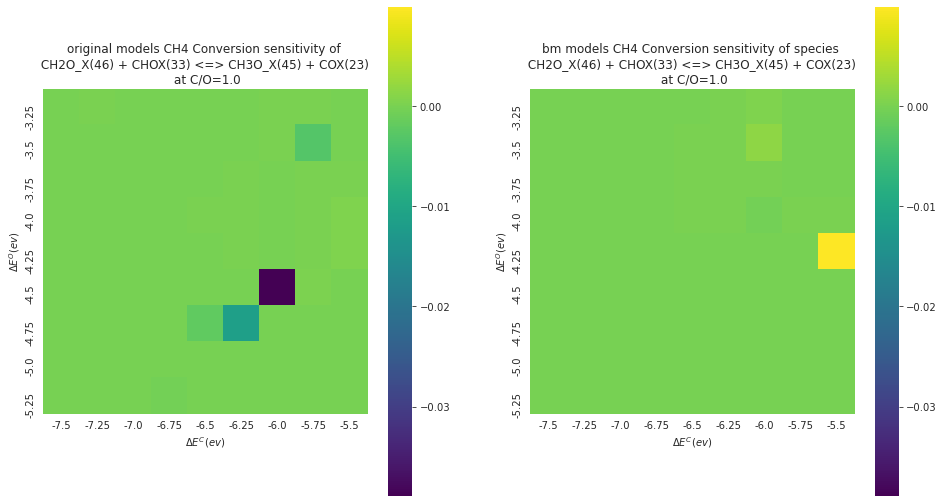

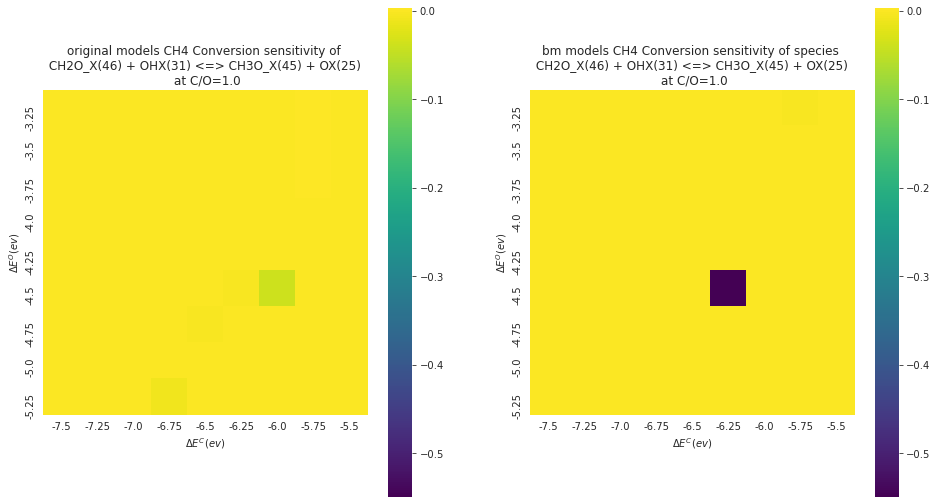

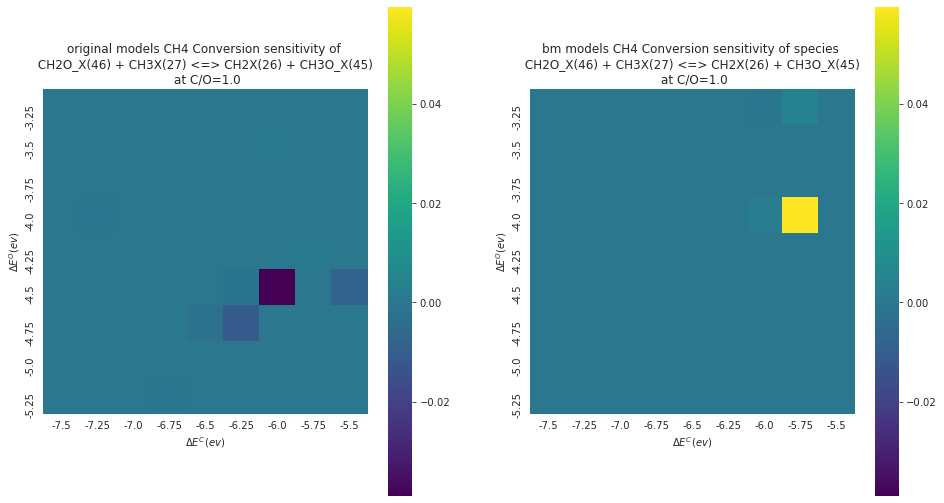

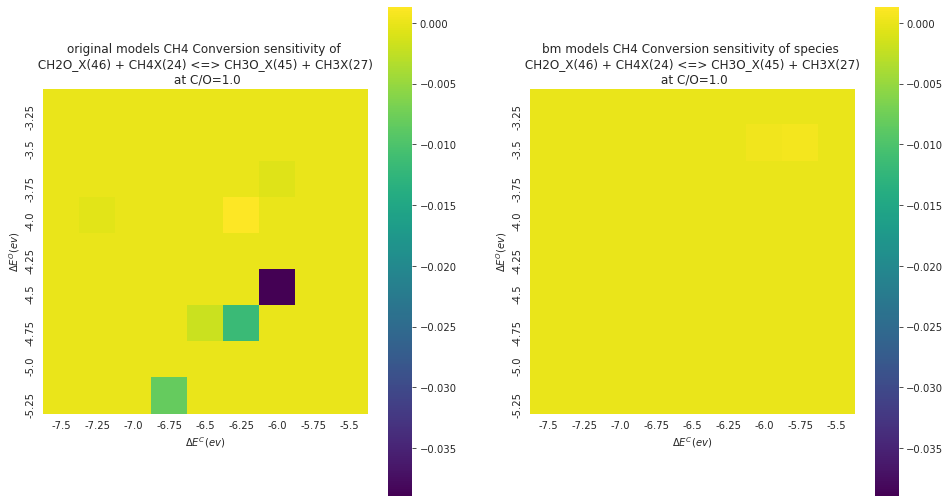

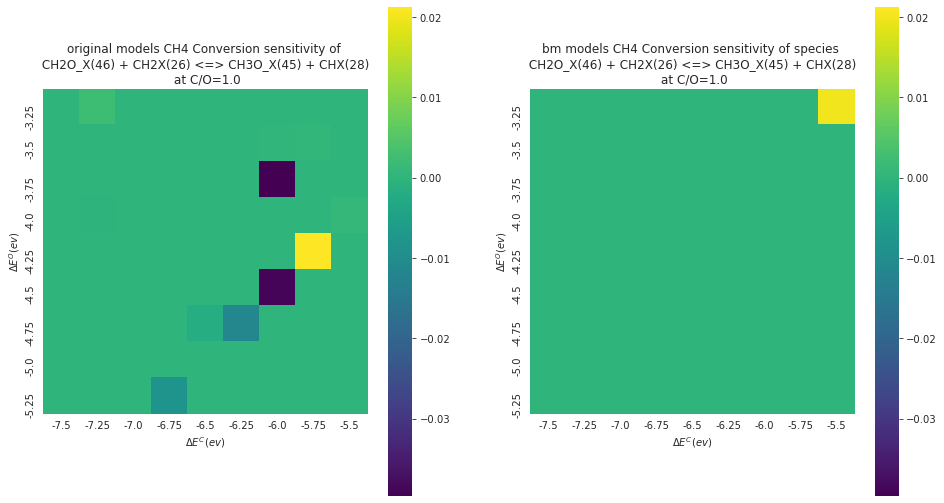

In [26]:
for i in range(80, 100):
    heat_map_gen(i, 8, 1.0, 10)

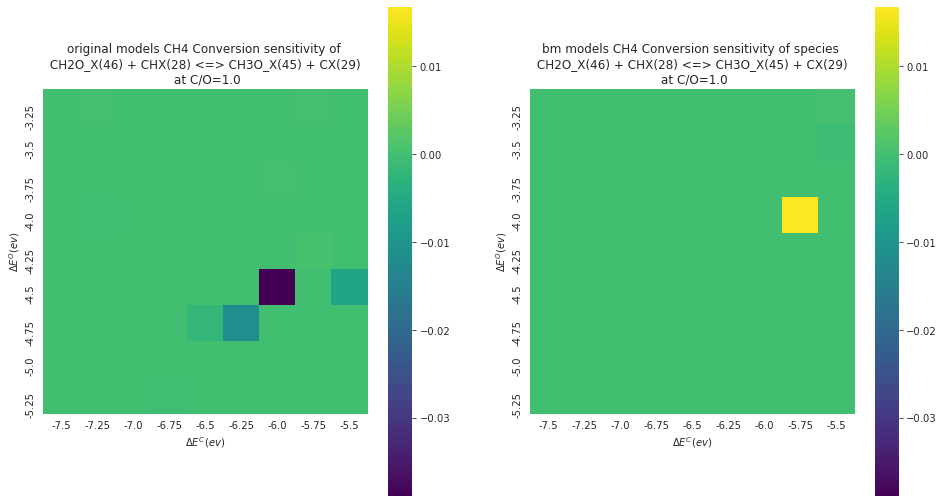

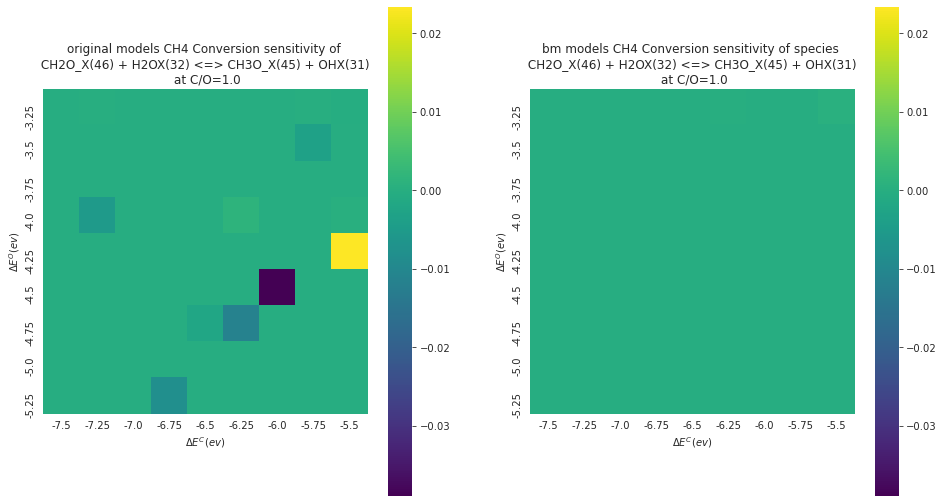

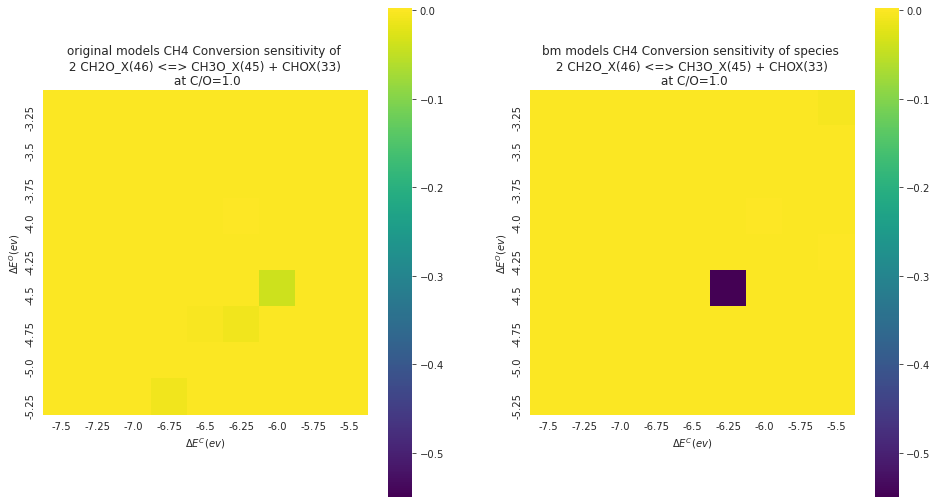

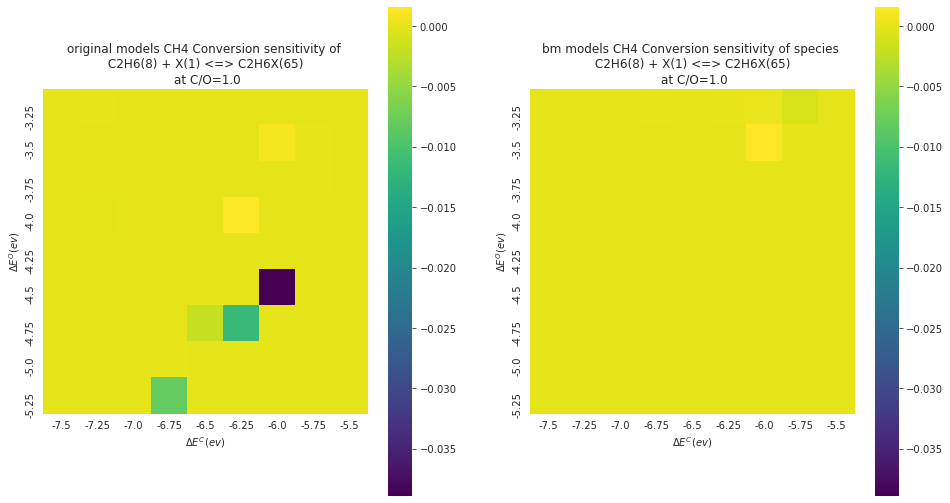

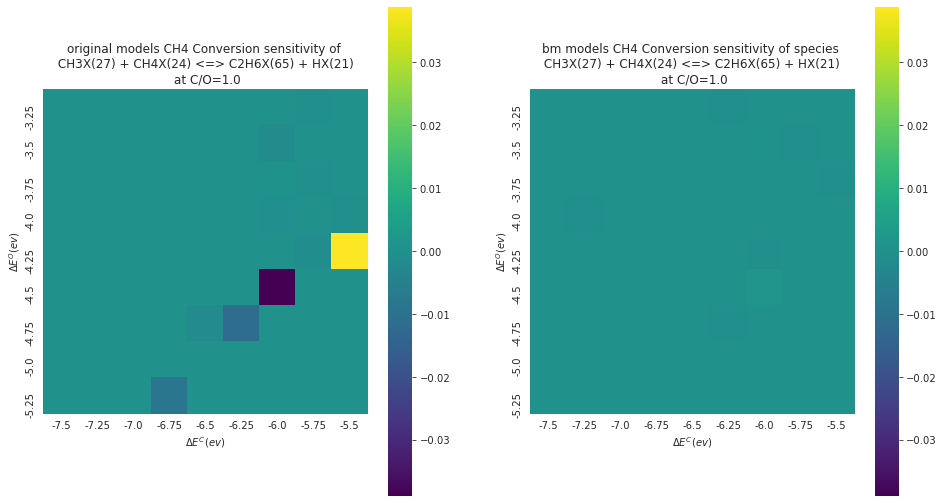

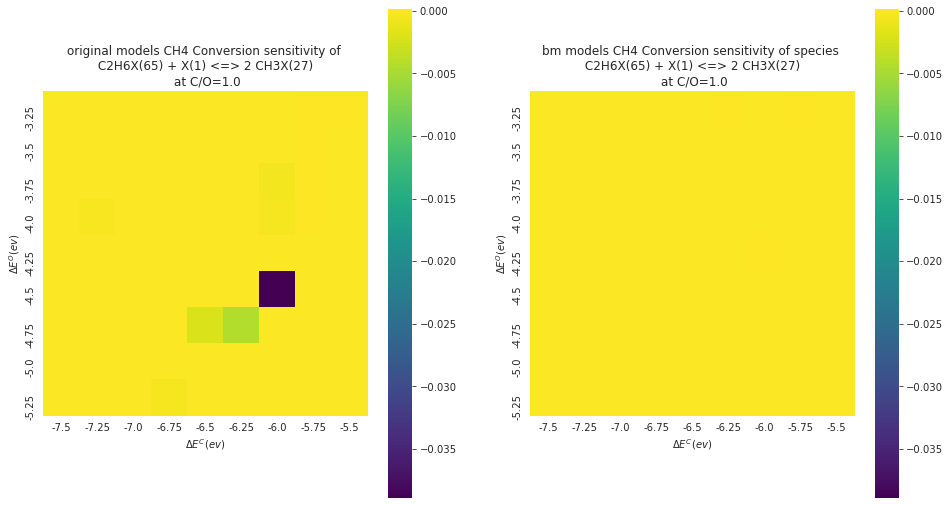

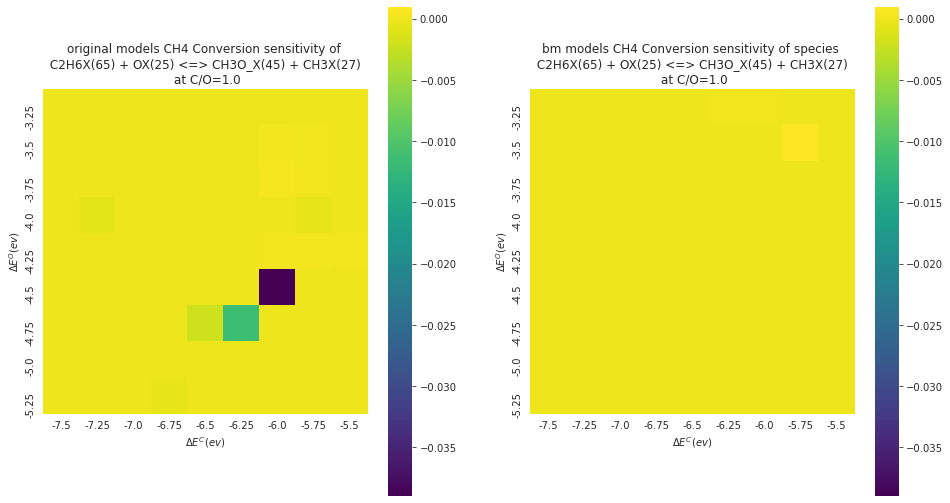

In [27]:
for i in range(100, 107):
    heat_map_gen(i, 8, 1.0, 10)

In [8]:
zero_ori_surfaces = [7, 8, 9, 16, 17, 18, 26, 27, 35, 36,45,64,65,66,67,68, 69, 70, 71, 72, 
                 73, 74, 75, 76, 77, 78, 79, 80, 81]
zero_bm_surfaces = [7, 8, 9, 16, 17, 18, 26, 27, 35, 36,45,64,65,66,67,68, 69, 70, 71, 72, 
                 73, 74, 75, 76, 77, 78, 79, 80, 81]

In [9]:
def heat_map_gen(rxn, property_, ratio, threshold):
    """
    rxn: index of reations
    property_: index of the property to plot
    ratio: the C/O input ratio
    threshold: threshold to rule out the outliers
    """
    benergy_c = np.arange(-7.5, -5.25, 0.25)
    benergy_o = np.arange(-3.25, -5.5, -0.25)
    data_original = np.zeros((len(benergy_c), len(benergy_o)))
    data_bm = np.zeros((len(benergy_c), len(benergy_o)))
    parent_dir = os.path.dirname(os.getcwd())
    # read the first file to extract the species and properties list
    f = f'{parent_dir}/base_original/binding_energies/1.0_c-5.50o-3.25/kinetic_sensitivity_data/0.6_sens_data.csv'
    df = pd.read_csv(f)
#     species = df.loc[:, 'Species'].to_list()
    properties = df.columns.to_list()
    
    total = 81
    i = -1
    paths = []
    for c_binding_energy in benergy_c:
        i += 1
        j = -1
        index = total - ((7.5 - abs(c_binding_energy)) / 0.25 + 1) * 9
        for o_binding_energy in benergy_o:
            j += 1
            index += 1

            if index not in zero_ori_surfaces:
                # read the simulation files
                original_path_sens = '{}/base_original/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
                if os.path.exists(original_path_sens):
                    df_original = pd.read_csv(original_path_sens)
                    charac_sens_original = df_original.loc[df_original['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                    if abs(charac_sens_original) >= threshold:
                        data_original[j][i] = 0
                    else:
                        data_original[j][i] = charac_sens_original
            if index not in zero_bm_surfaces:
                bm_path_sens = '{}/base_bm/binding_energies/{}_c{:.2f}o{:.2f}/kinetic_sensitivity_data/{}_sens_data.csv'.format(parent_dir, index, c_binding_energy, o_binding_energy, ratio)
                if os.path.exists(bm_path_sens):
                    df_bm = pd.read_csv(bm_path_sens)
                    charac_sens_bm = df_bm.loc[df_bm['Reactions'] == rxn].iloc[:,property_].to_list()[0]
                    if abs(charac_sens_bm) >= threshold:
                        data_bm[j][i] = 0
                    else:
                        data_bm[j][i] = charac_sens_bm
                    
    original_df = pd.DataFrame(data_original, columns=benergy_c, index=benergy_o)
    bm_df = pd.DataFrame(data_bm, columns=benergy_c, index=benergy_o)
    minimum = min(original_df.min().min(), bm_df.min().min())
    maximum = max(original_df.max().max(), bm_df.max().max())
    sns.set_style("darkgrid")
    fig = plt.figure(figsize=(16,9))
    ax1 = fig.add_subplot(121, aspect='equal')
    ax2 = fig.add_subplot(122, aspect='equal')
    cmap = sns.color_palette("viridis", as_cmap=True)
    ax1 = sns.heatmap(original_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax1, vmin=minimum, vmax=maximum)
    ax1.set(title="original models {} sensitivity of \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio),
          xlabel="$\\Delta E^C(ev)$",
          ylabel="$\\Delta E^O(ev)$",)
    ax2 = sns.heatmap(bm_df, xticklabels=benergy_c, yticklabels=benergy_o, annot=False, cmap=cmap, ax=ax2, vmin=minimum, vmax=maximum)
    ax2.set(title="bm models {} sensitivity of species \n {} \n at C/O={}".format(properties[property_], rxns[rxn].equation, ratio),
          xlabel="$\\Delta E^C(ev)$",
          ylabel="$\\Delta E^O(ev)$",)
    plt.plot()

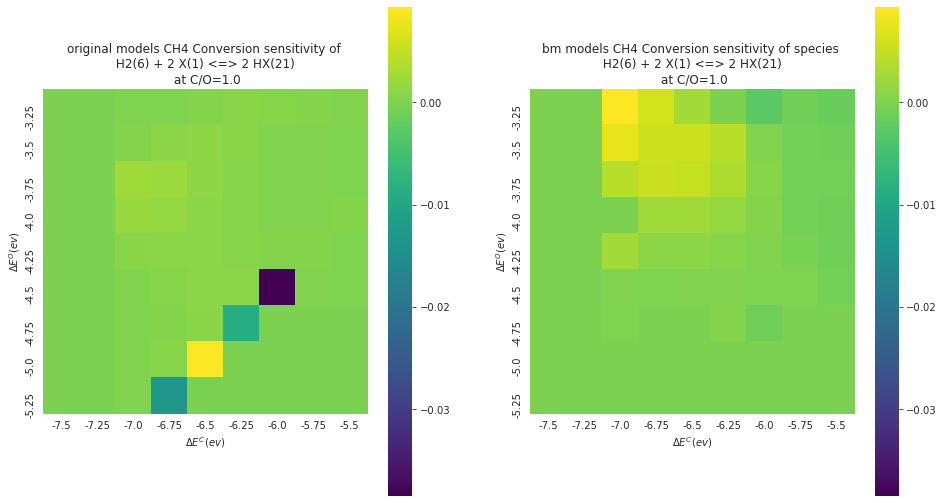

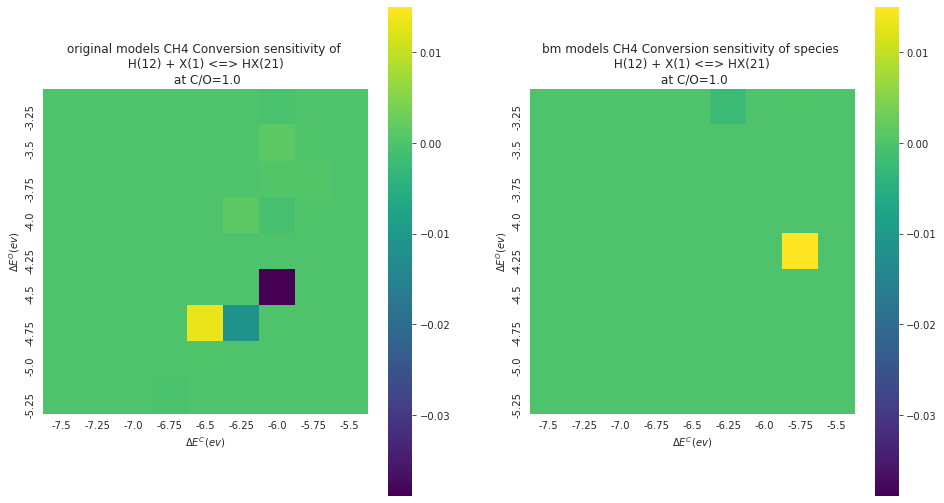

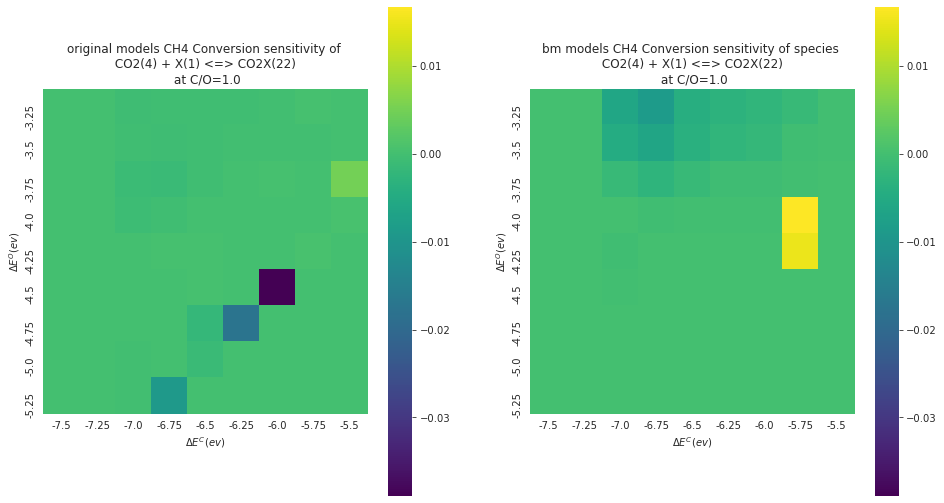

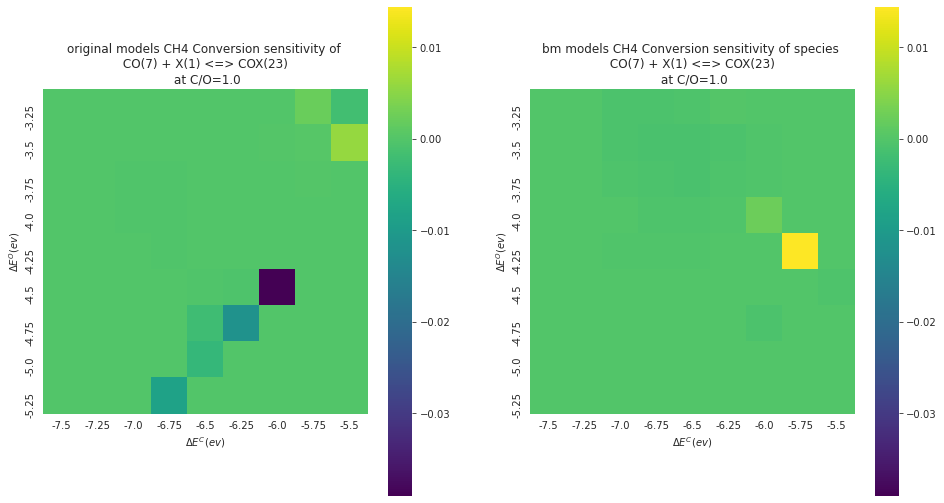

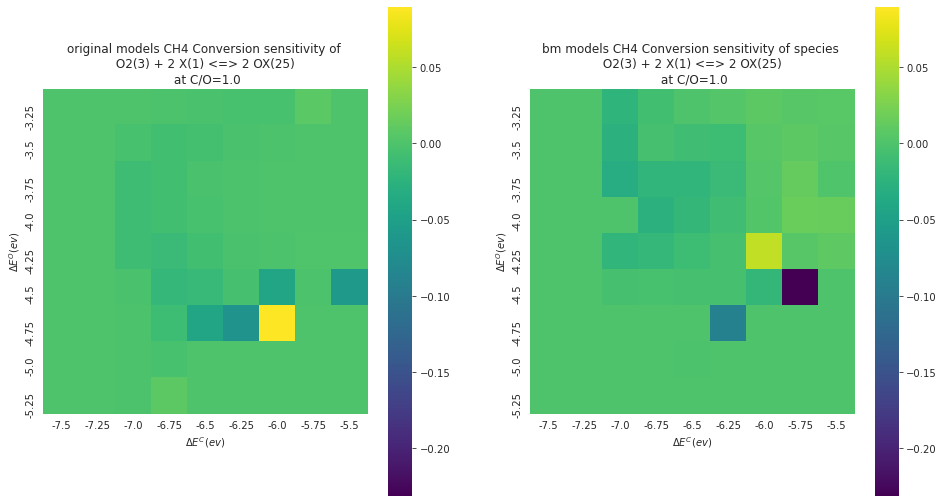

...

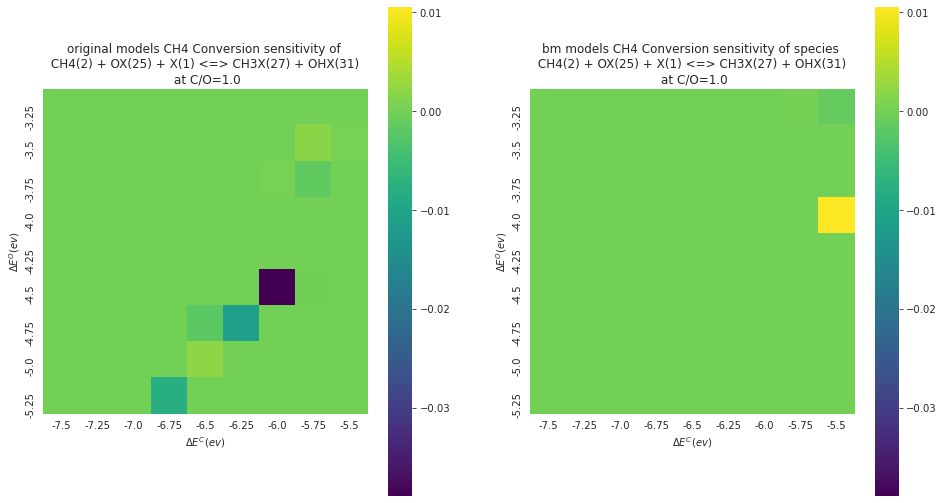

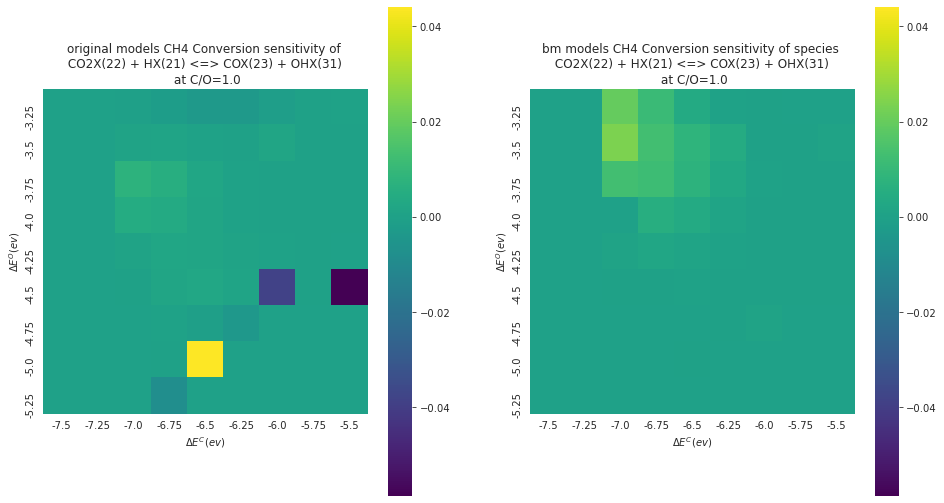

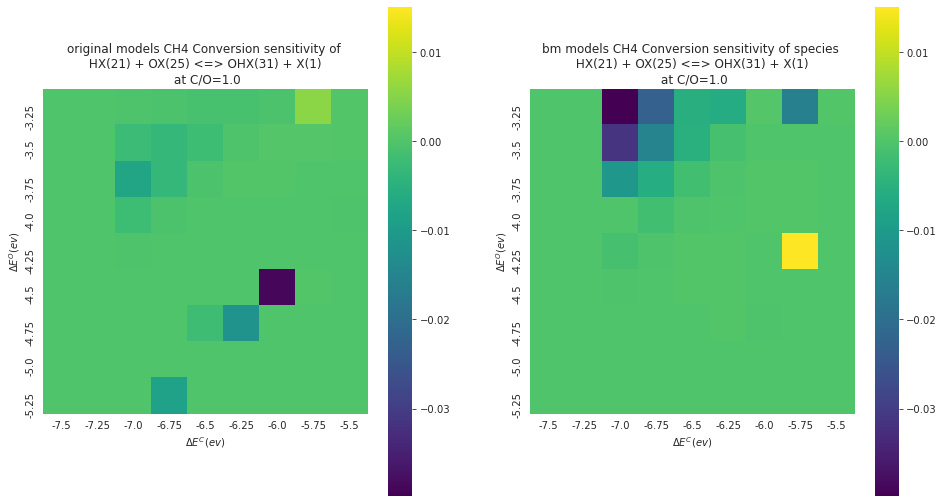

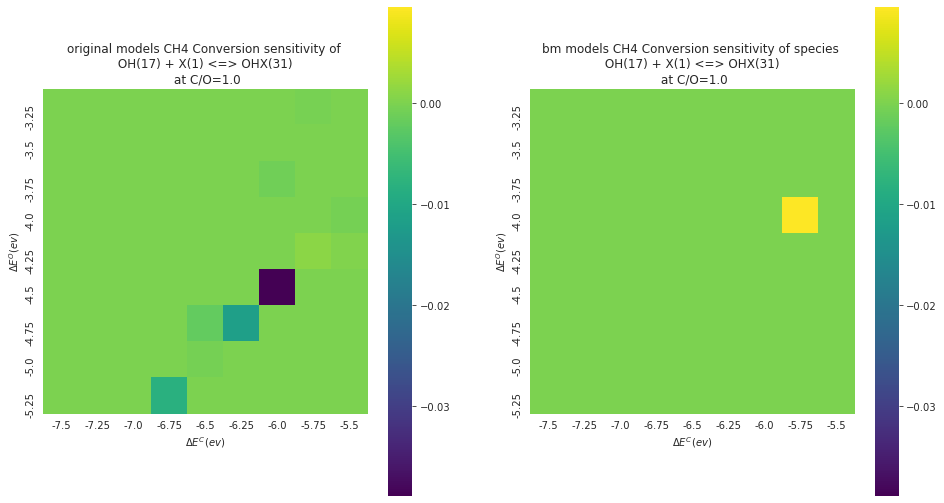

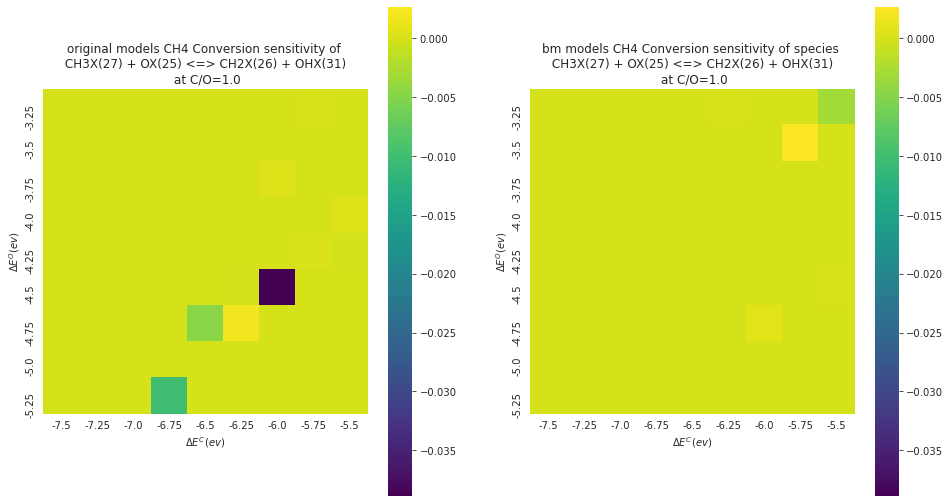

In [10]:
for i in range(20):
    heat_map_gen(i, 8, 1.0, 0.5)

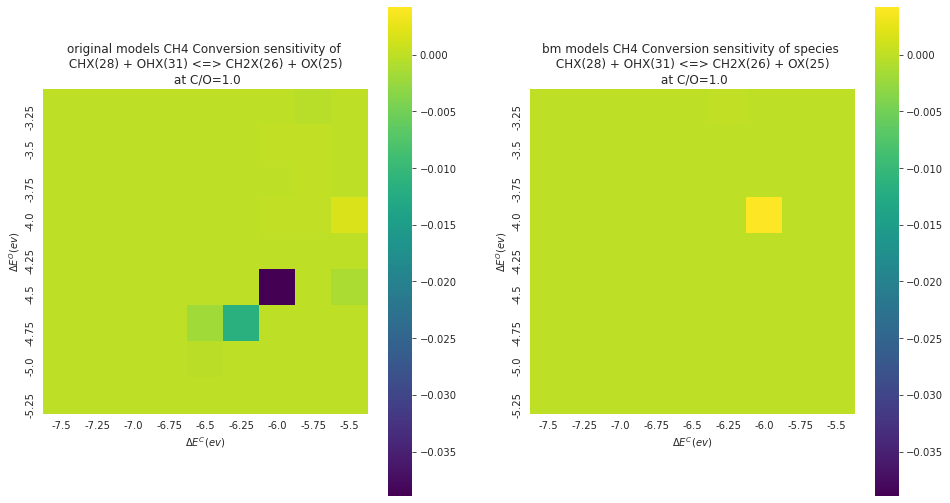

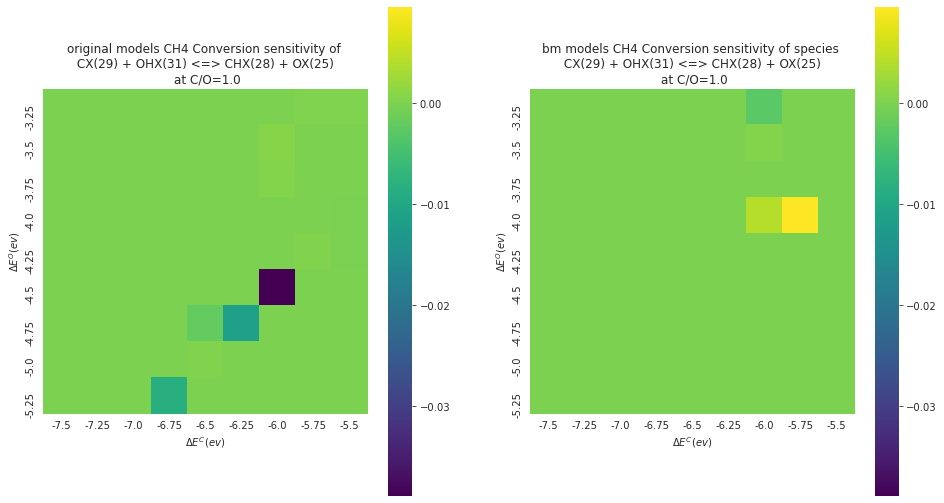

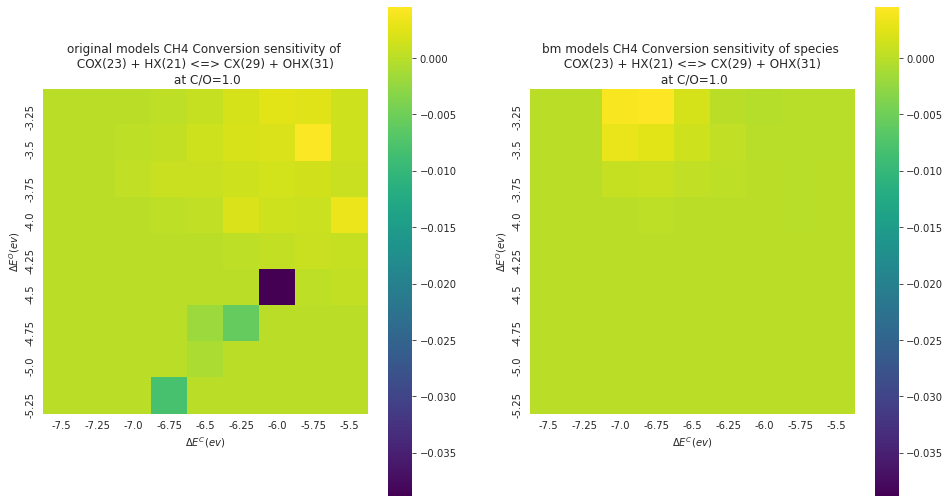

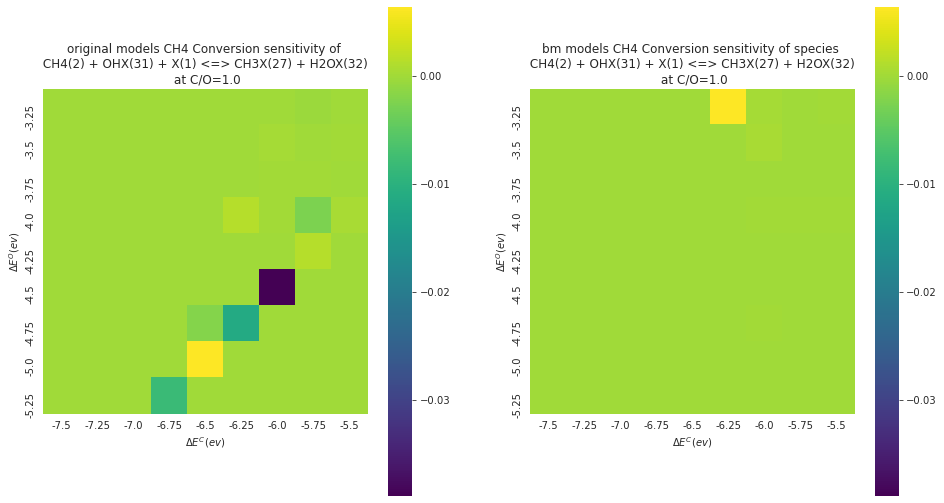

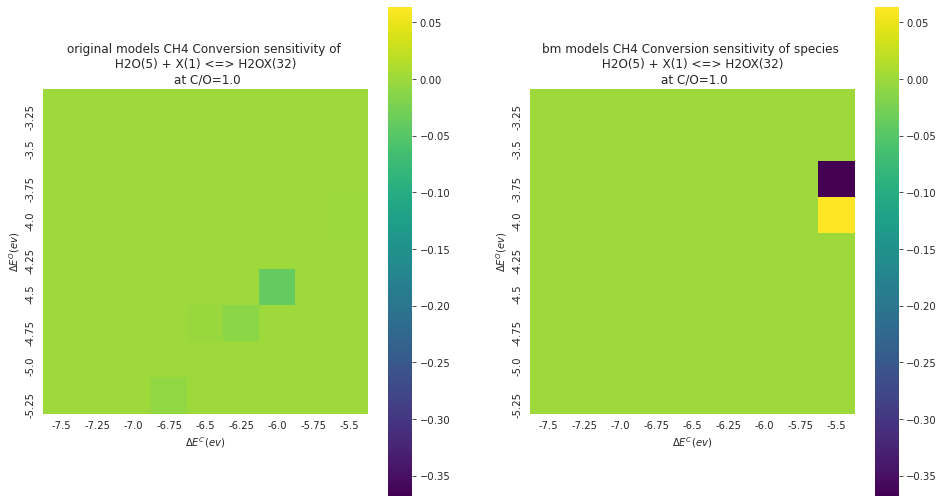

...

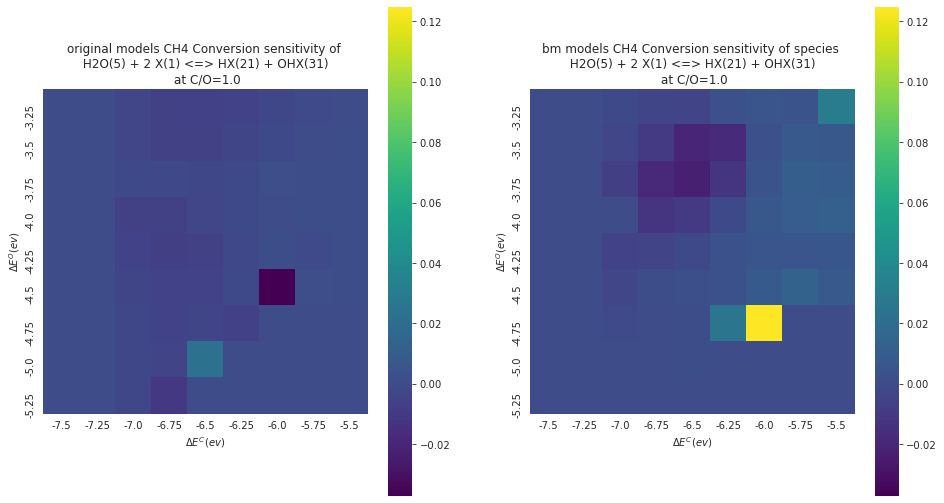

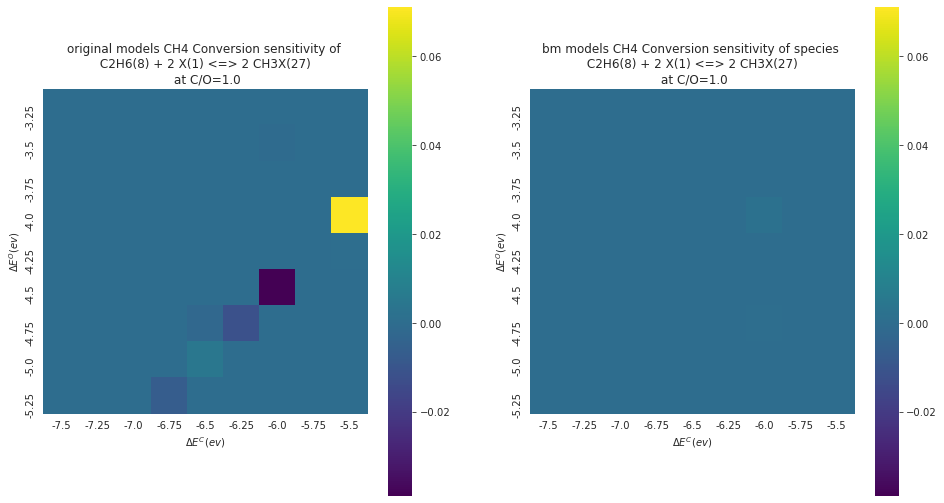

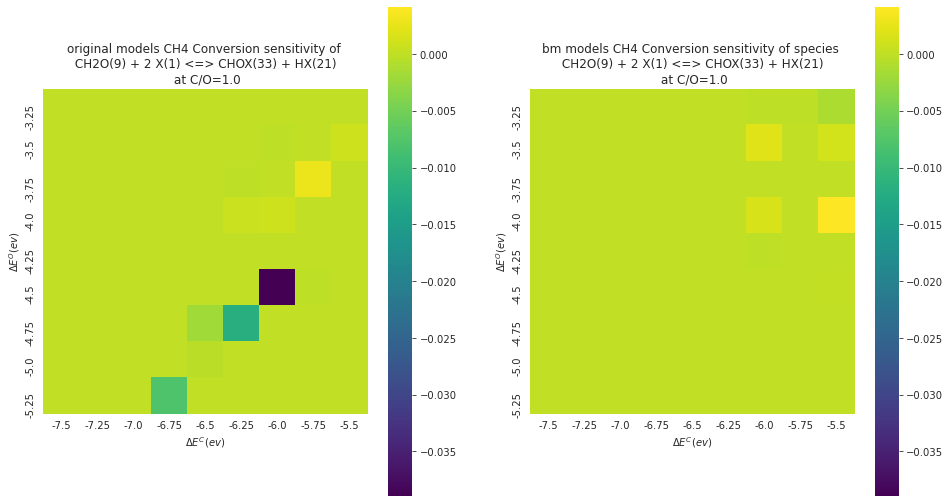

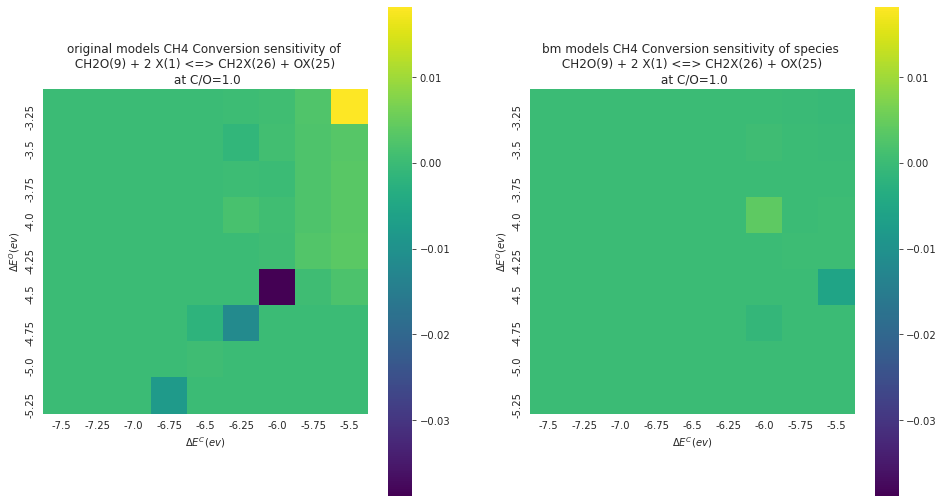

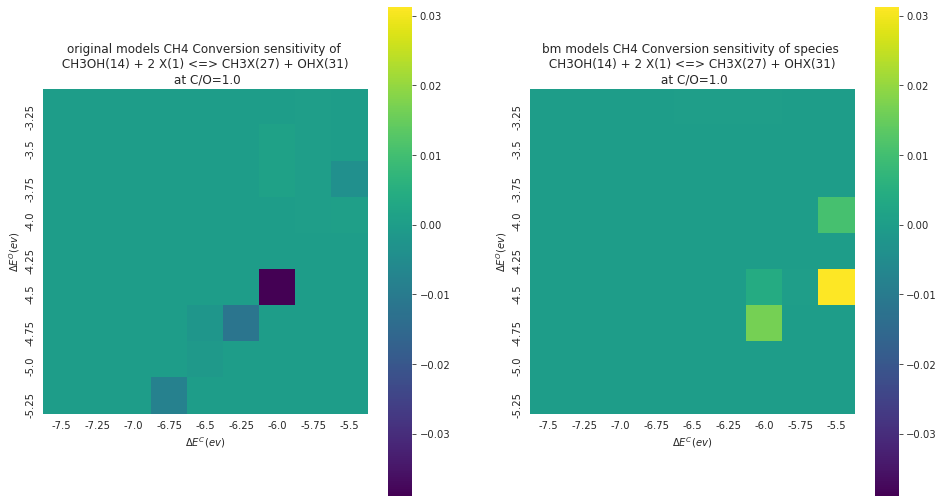

In [11]:
for i in range(20, 40):
    heat_map_gen(i, 8, 1.0, 0.5)

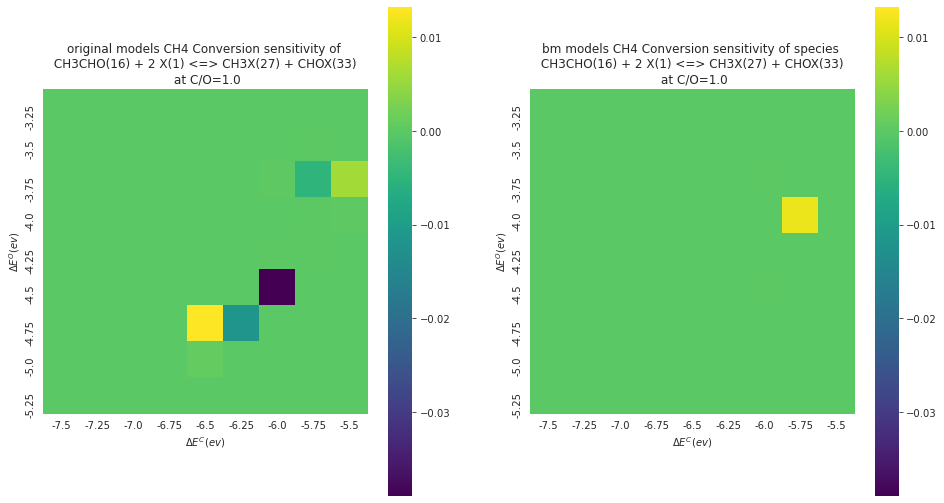

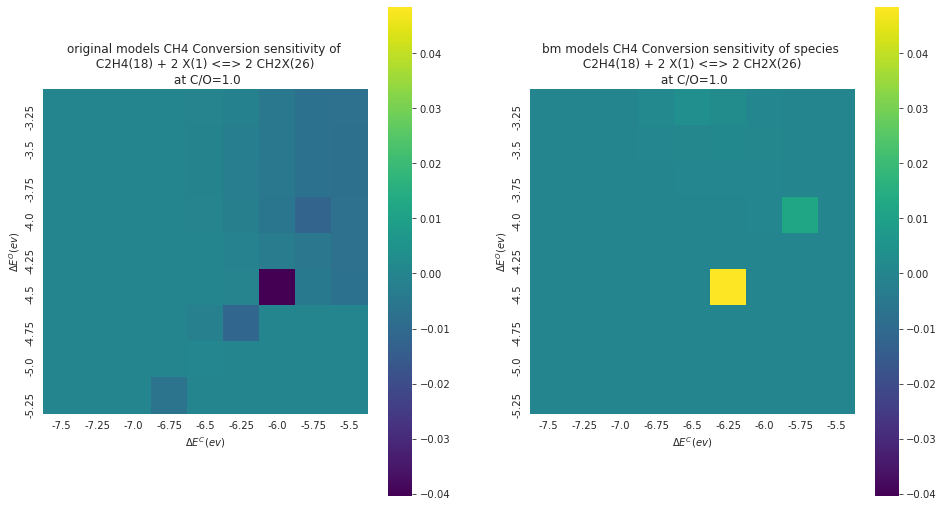

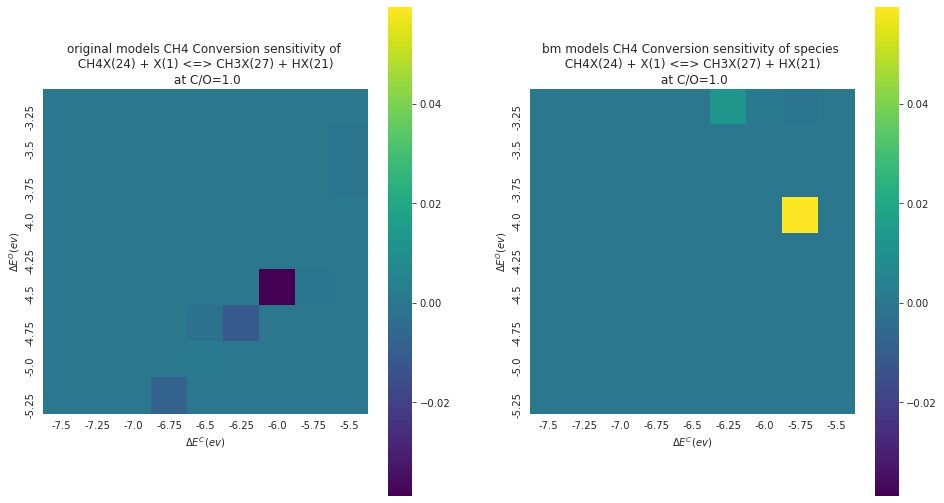

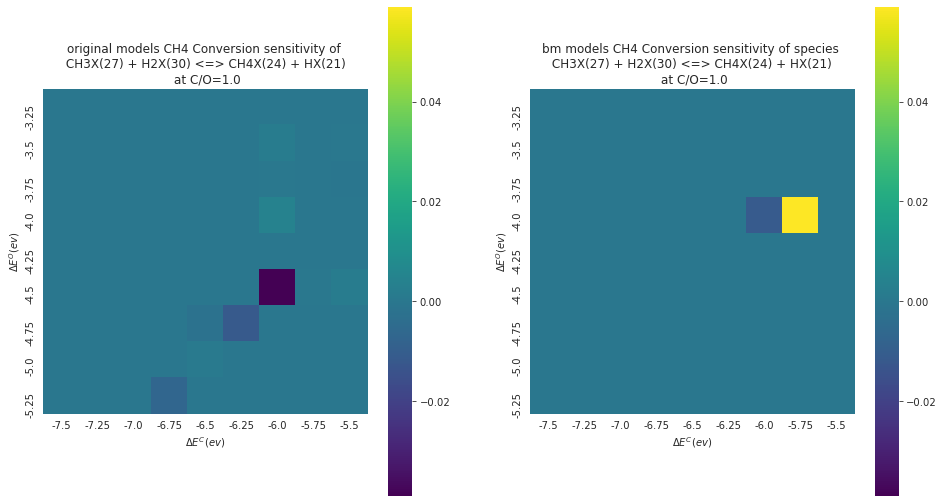

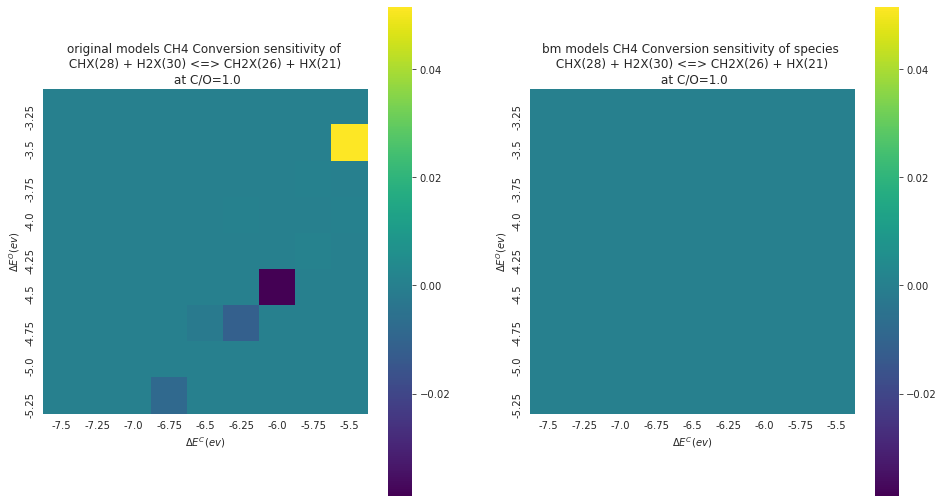

...

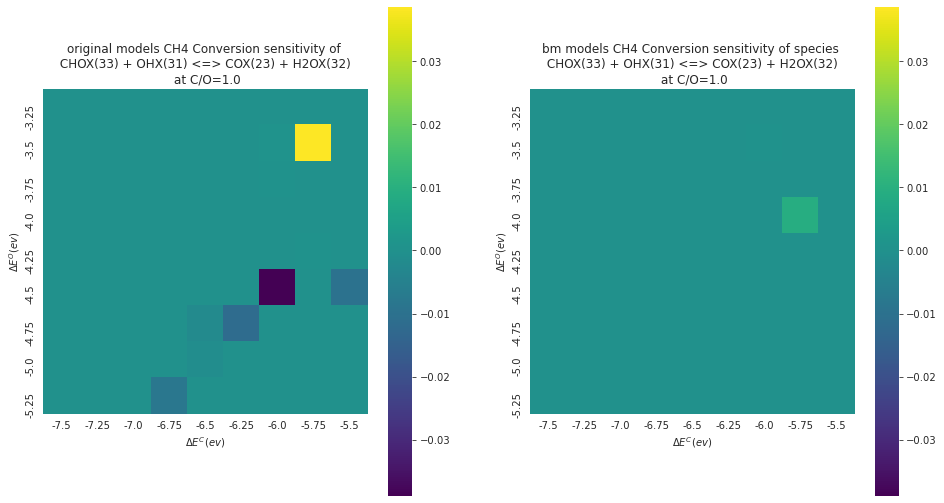

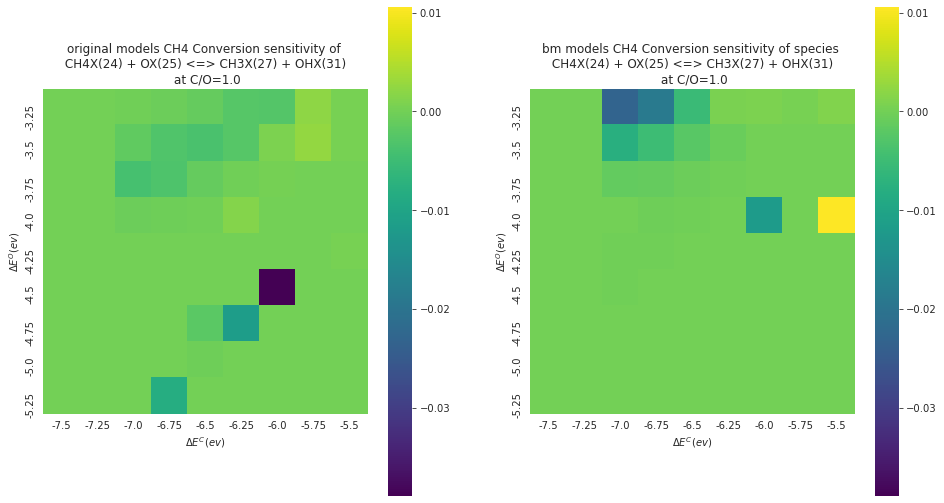

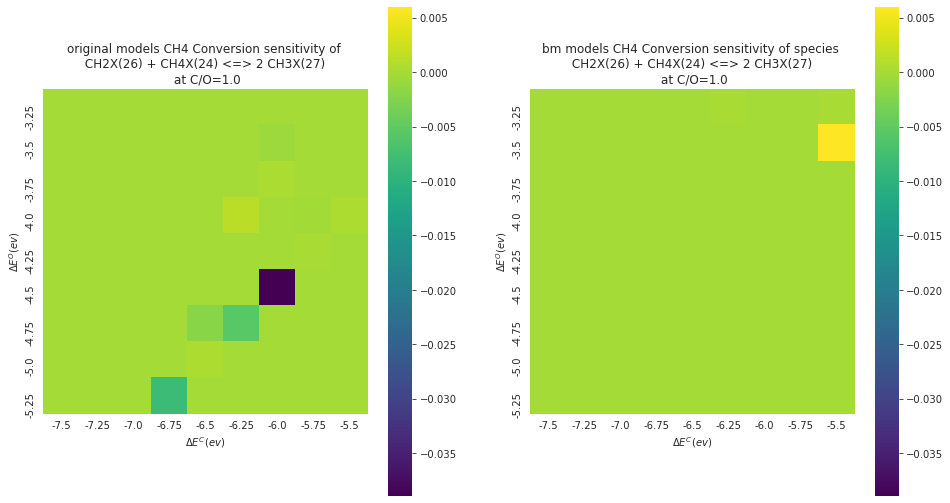

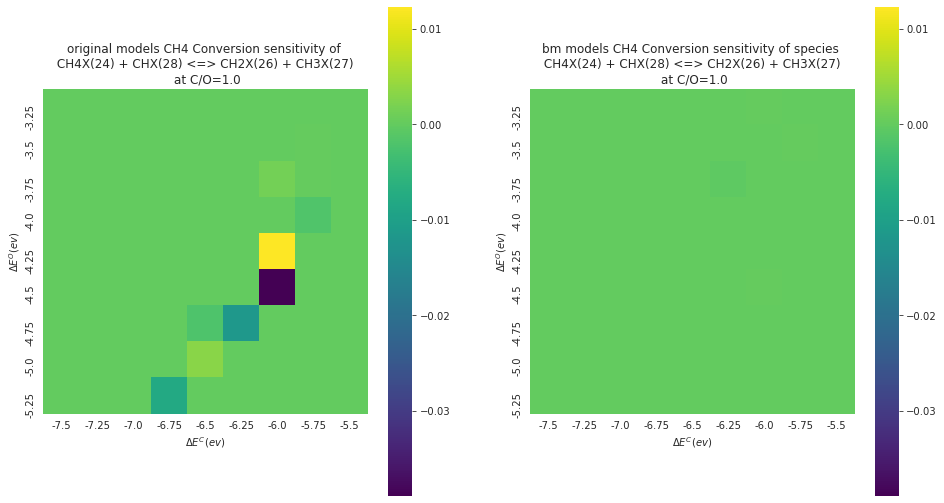

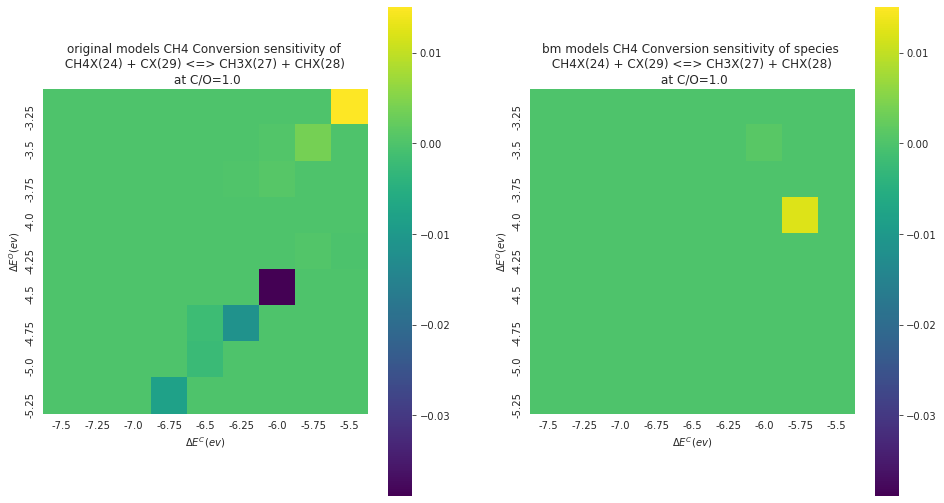

In [12]:
for i in range(40, 60):
    heat_map_gen(i, 8, 1.0, 0.5)

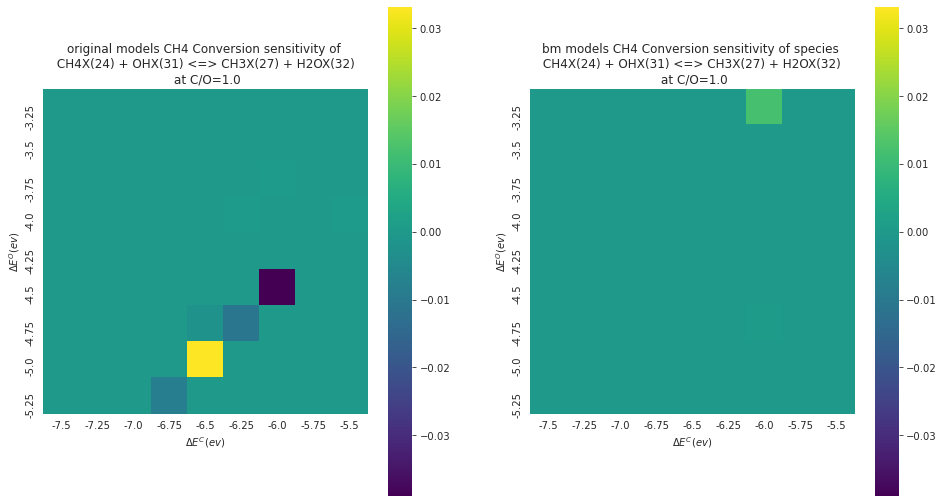

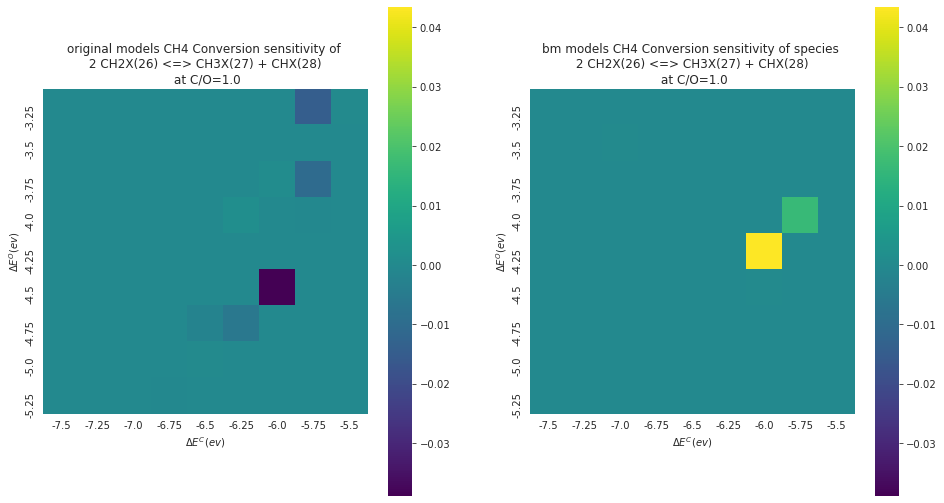

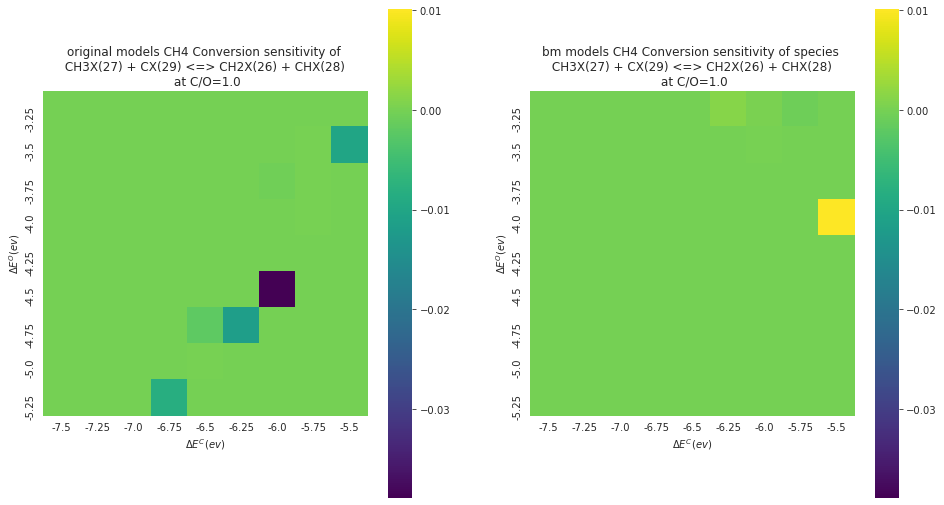

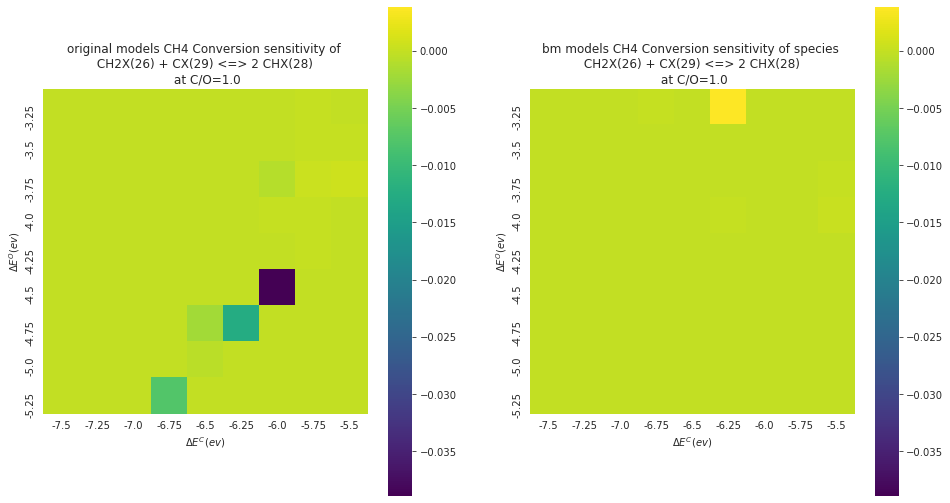

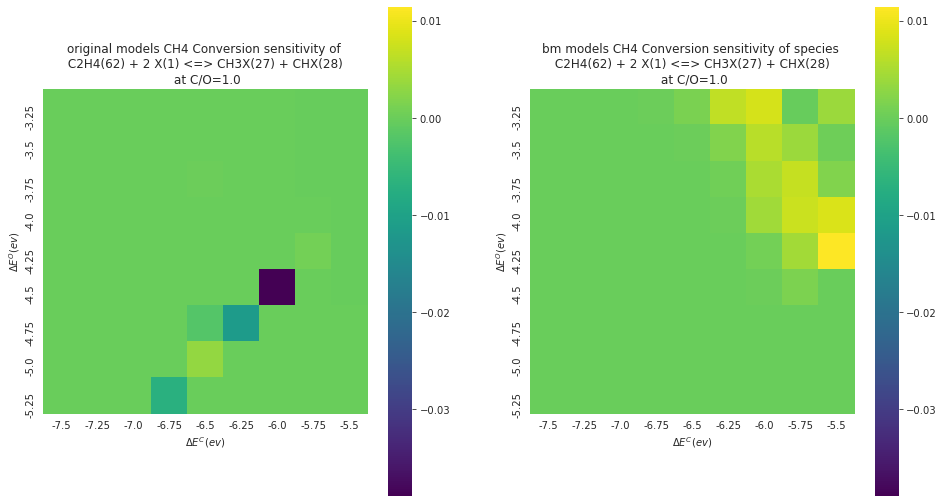

...

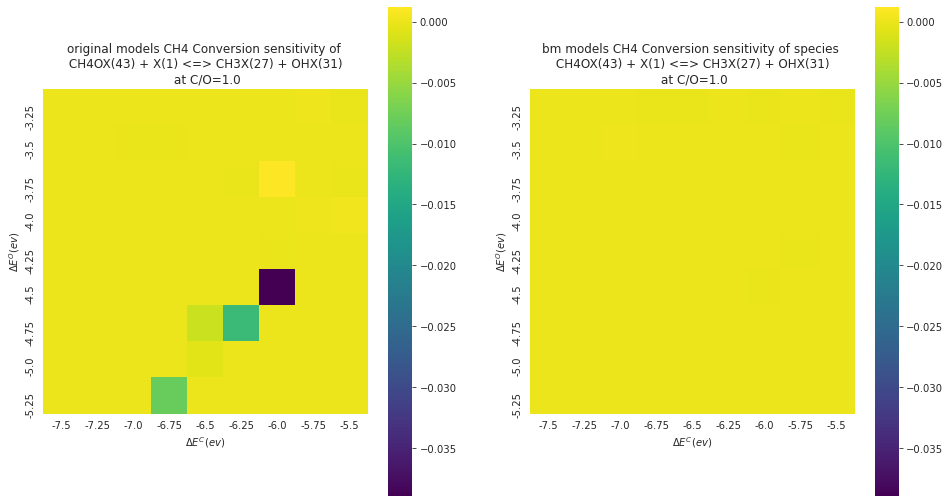

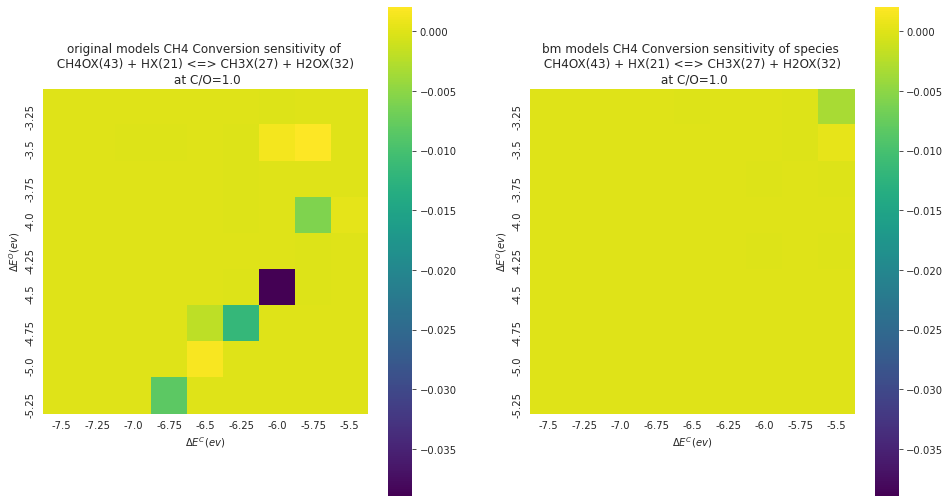

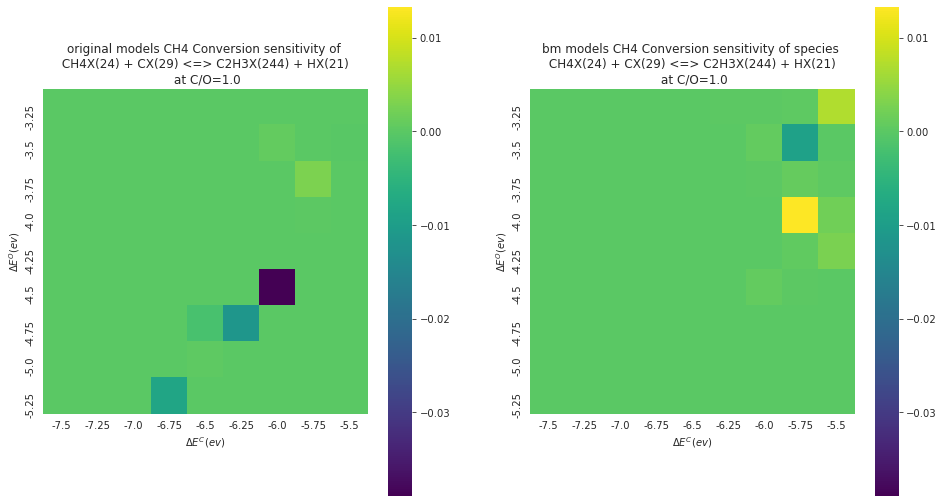

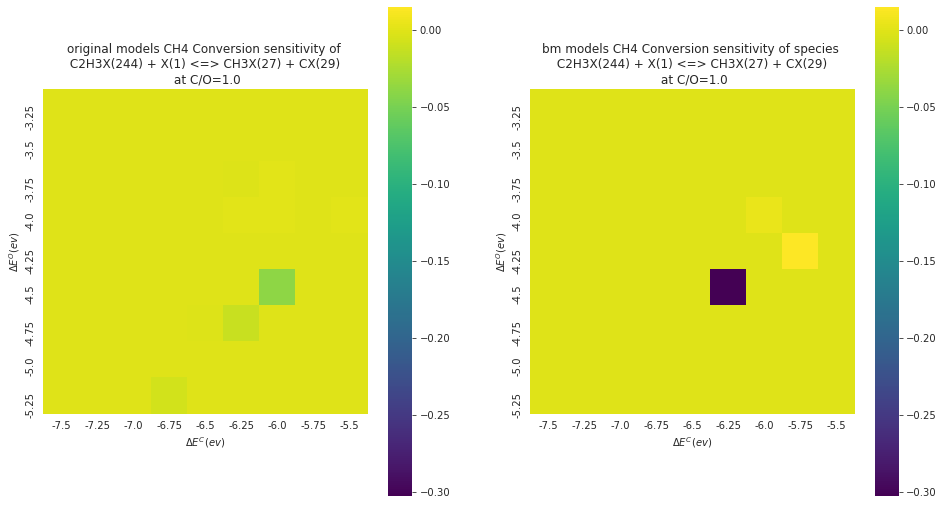

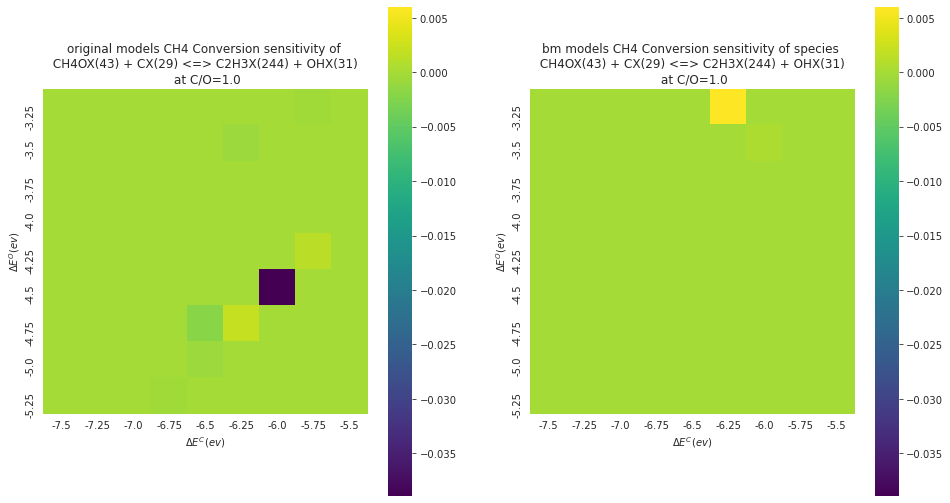

In [13]:
for i in range(60, 80):
    heat_map_gen(i, 8, 1.0, 0.5)

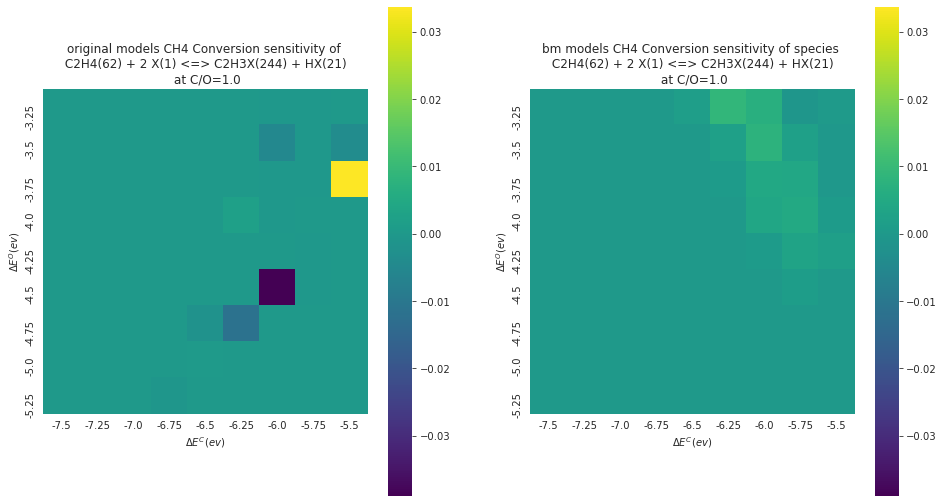

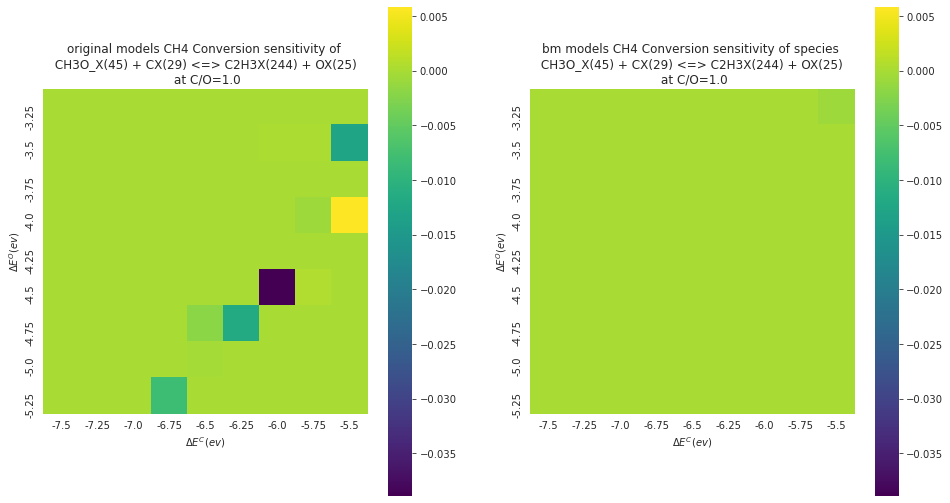

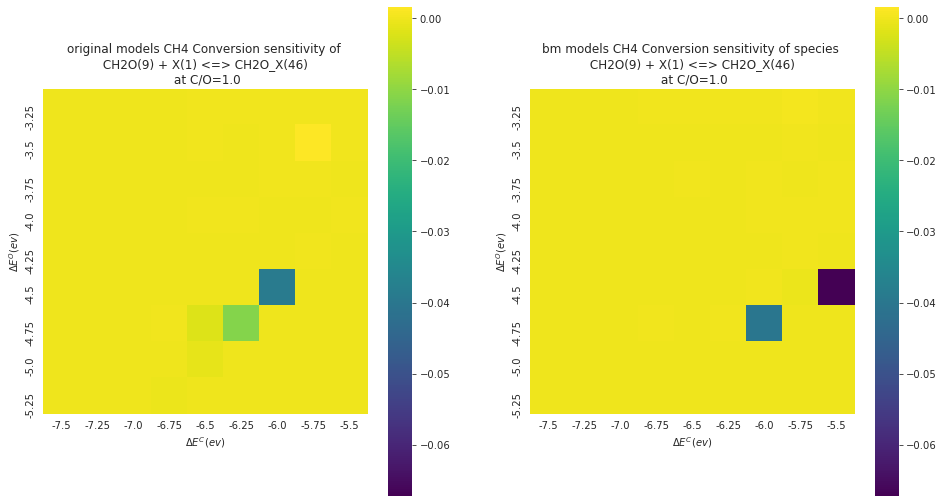

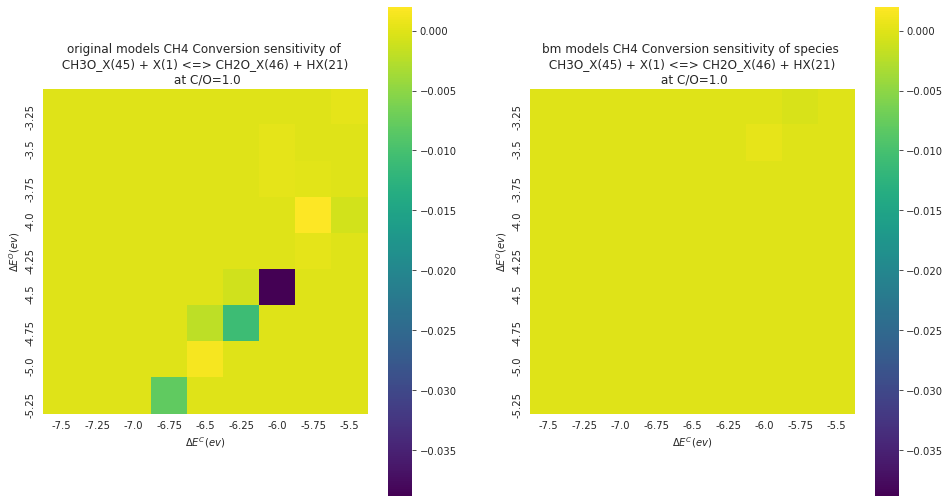

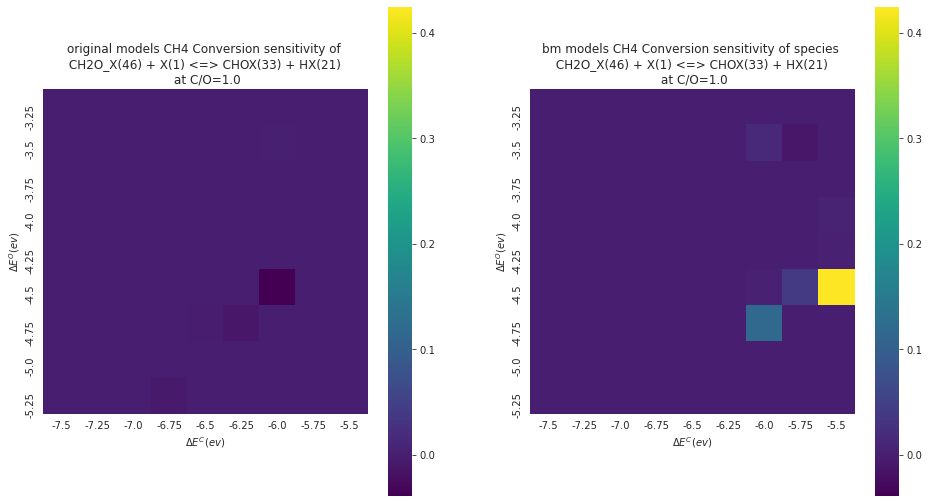

...

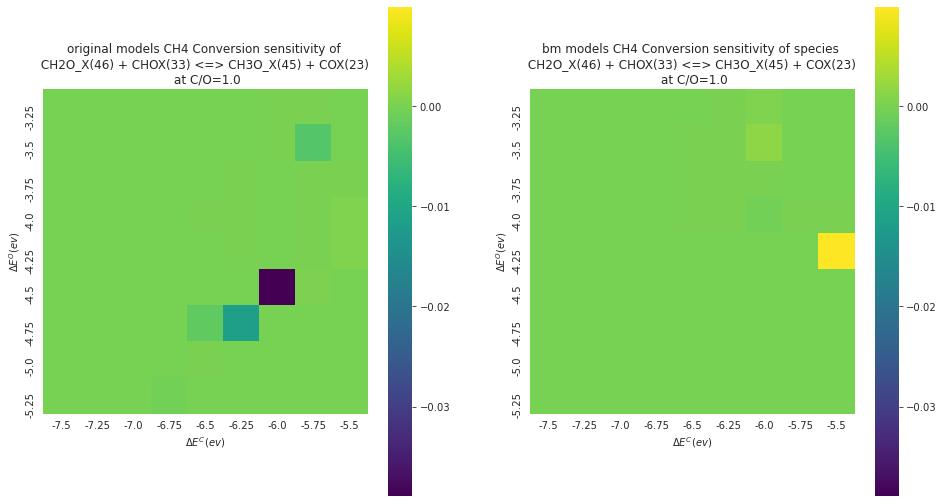

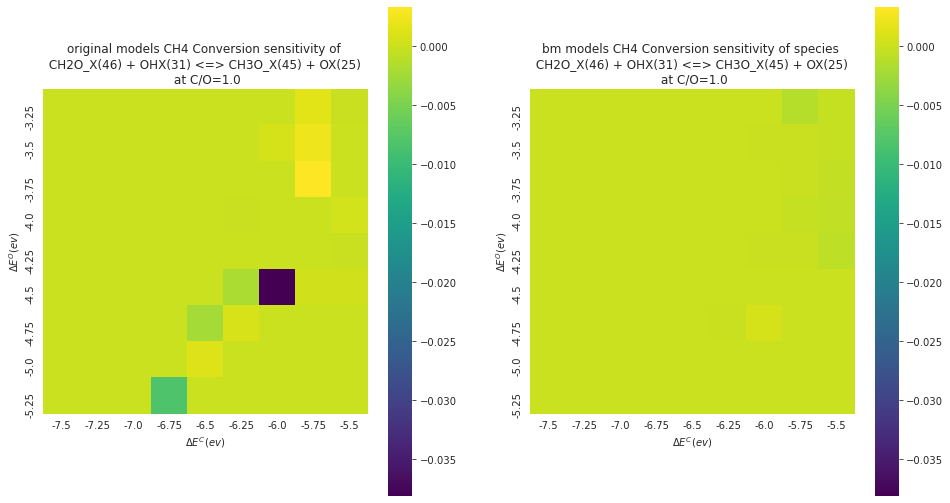

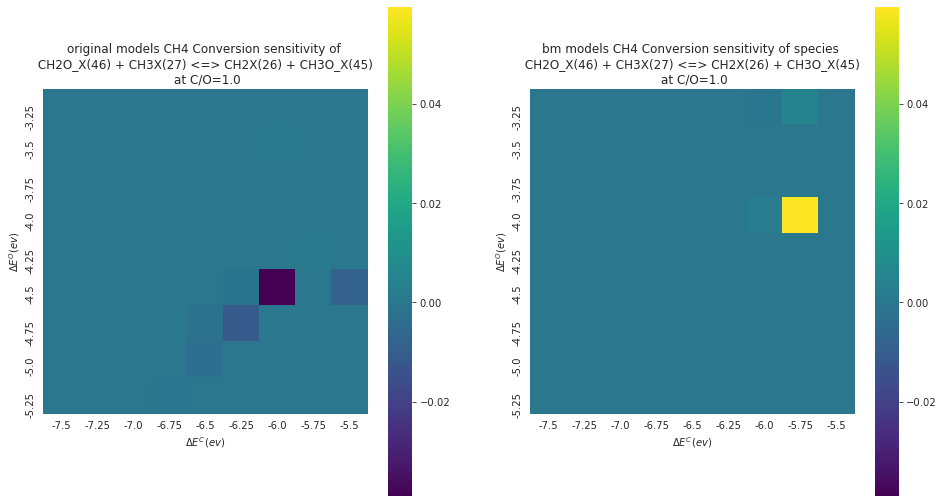

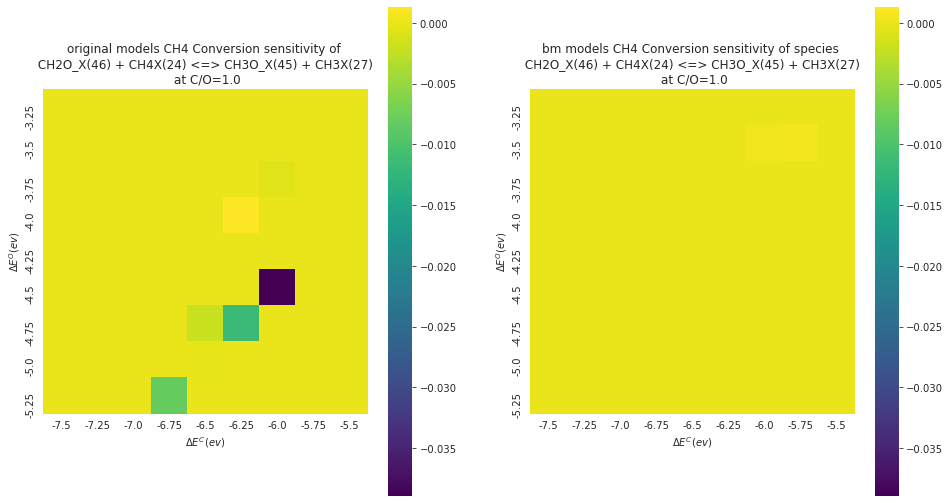

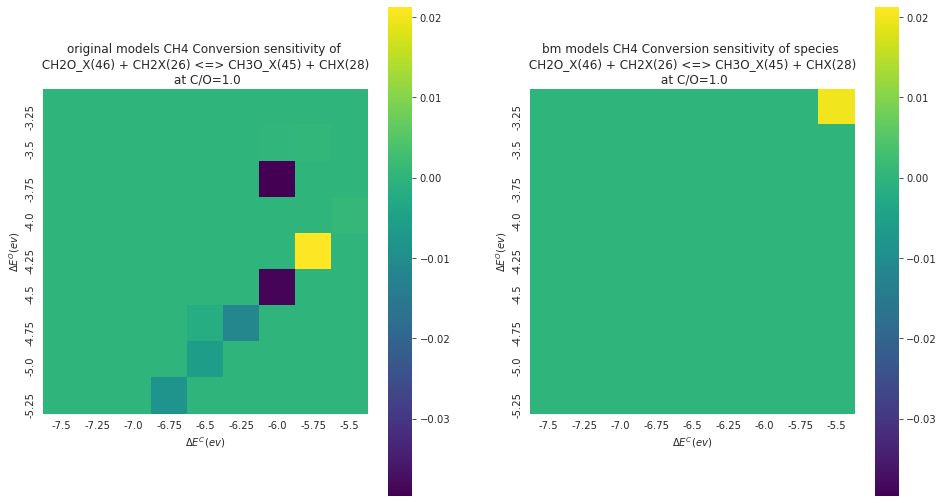

In [14]:
for i in range(80, 100):
    heat_map_gen(i, 8, 1.0, 0.5)

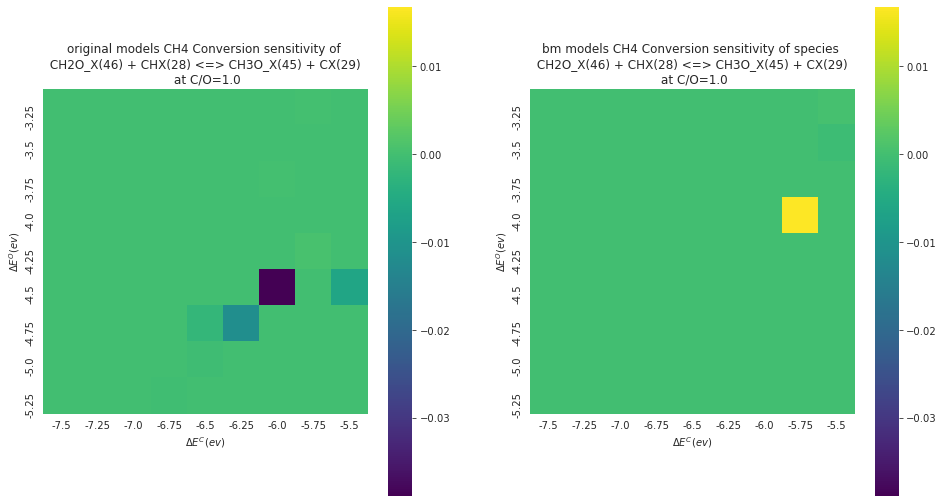

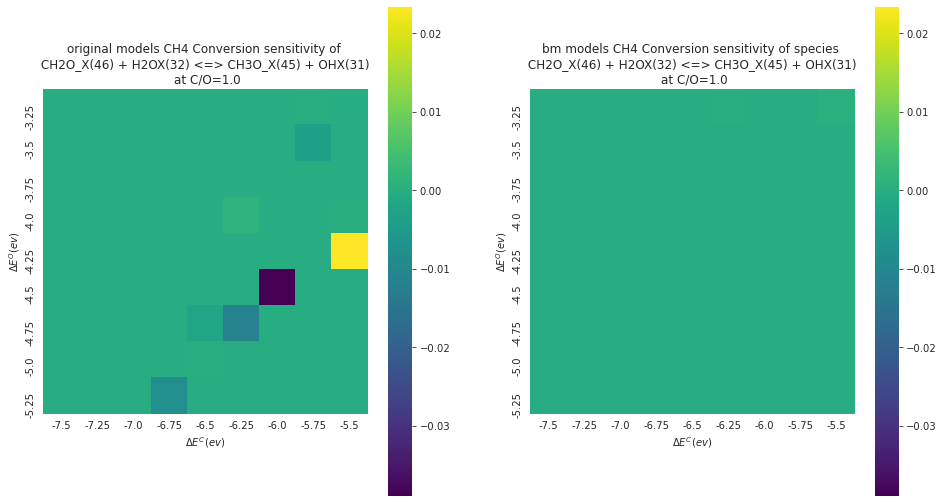

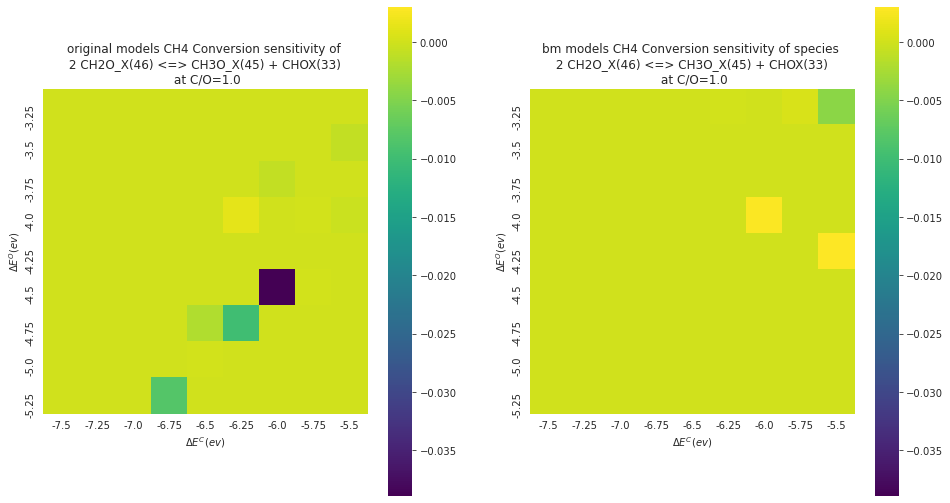

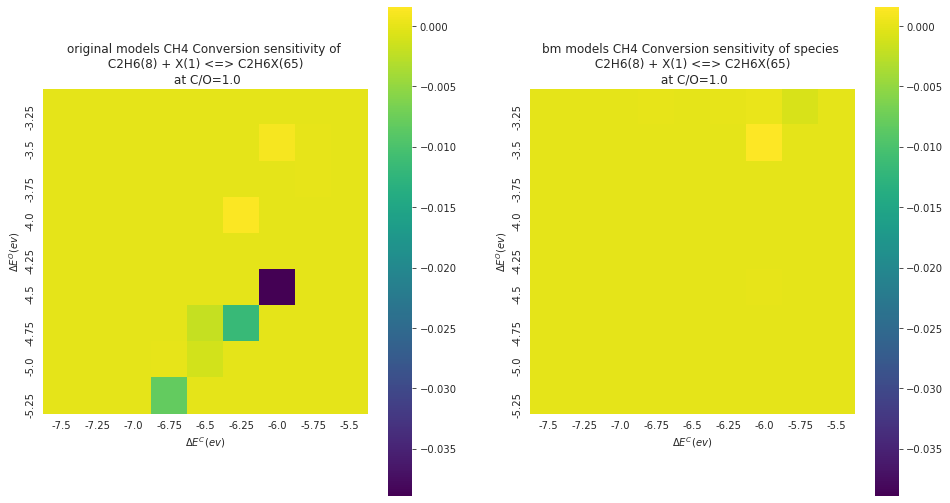

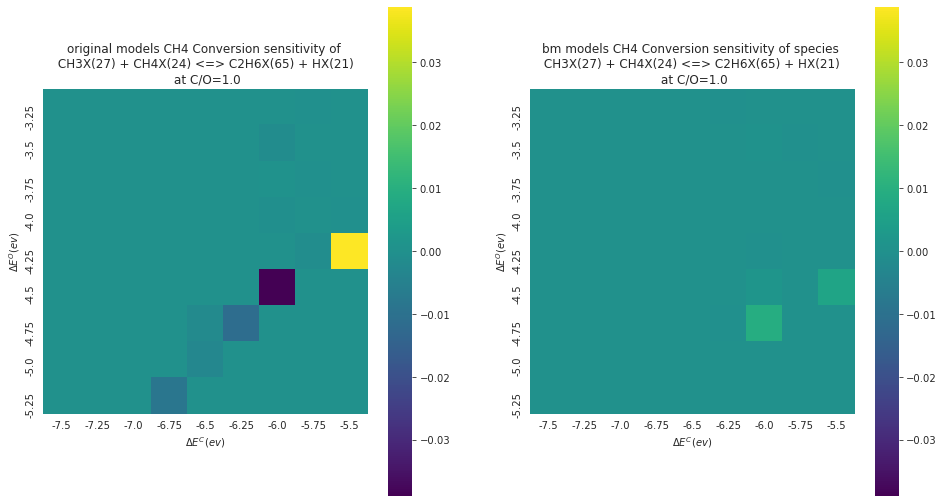

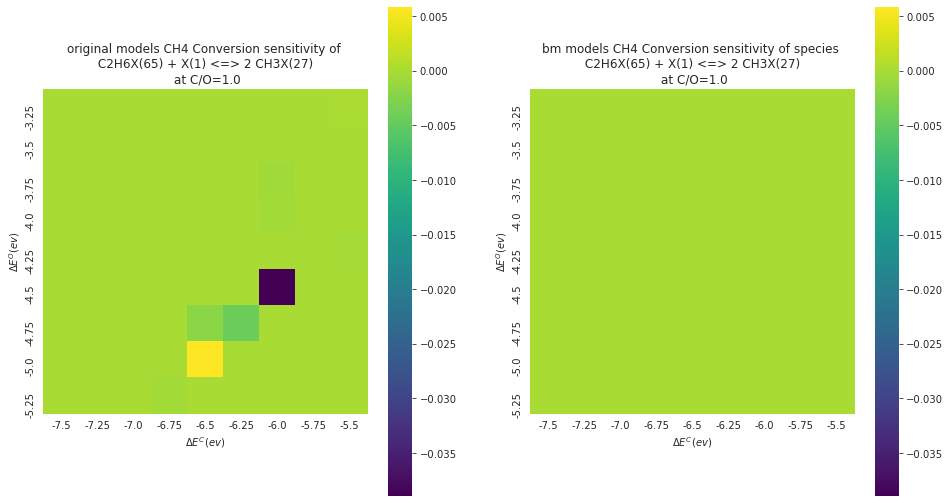

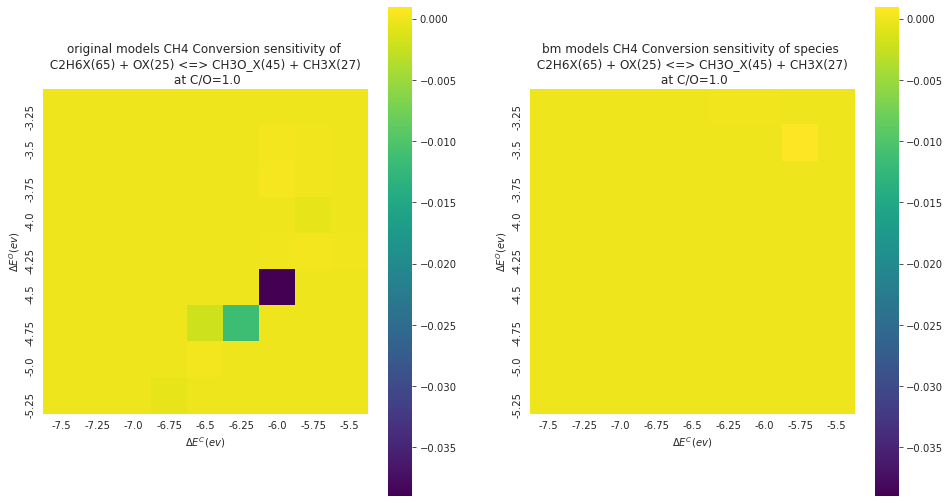

In [15]:
for i in range(100, 107):
    heat_map_gen(i, 8, 1.0, 0.5)